In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime

# === PARAMETERS ===
FICHIER_CSV = "all_data_enriched.csv"
MAX_POINTS = 1000
MA_WINDOW = 10  # moving average window size

# === LOAD DATA ===
df = pd.read_csv(FICHIER_CSV, low_memory=False)

def plot(df, rider_name):
    rider_data = df[df['rider_name'] == rider_name]
    if rider_data.empty:
        print(f"No data found for rider: {rider_name}")
        return

    for run_name in rider_data['run'].unique():
        run_data = rider_data[rider_data['run'] == run_name]
        print(f"Summary for {rider_name} - Run: {run_name}")

        for maneuver_index in run_data['maneuver_index'].unique():
            maneuver_data = run_data[run_data['maneuver_index'] == maneuver_index]
            maneuver_time = maneuver_data['ISODateTimeUTC'].iloc[0]
            maneuver_type = maneuver_data['maneuver_type'].iloc[0]
            duration = maneuver_data['interval_duration'].iloc[0]
            start_time = maneuver_data['start_time'].iloc[0]
            end_time = maneuver_data['end_time'].iloc[0]
            boat_name = maneuver_data['boat_name'].iloc[0]

            print(f"\nManeuver details for Maneuver Index: {maneuver_index}")
            print(f"  Maneuver Time: {maneuver_time}")
            print(f"  Maneuver Type: {maneuver_type}")
            print(f"  Duration: {duration} seconds")
            print(f"  Start Time: {start_time}")
            print(f"  End Time: {end_time}")
            print(f"  boat_name: {boat_name}\n")
            print(f"avg TWS: {maneuver_data['TWS'].mean():.2f} knots")
            print(f"avg TWA: {maneuver_data['TWA'].mean():.2f} degrees")
            print(f"avg TWD: {maneuver_data['TWD'].mean():.2f} degrees")

            fig, axes = plt.subplots(3, 5, figsize=(20, 12))
            fig.suptitle(f'{rider_name} - Run: {run_name} - Maneuver ID: {maneuver_index} - Maneuver type: {maneuver_type}', fontsize=16)

            # Lat/Lon (no moving average)
            axes[0, 0].plot(maneuver_data['Lon'], maneuver_data['Lat'], color='blue')
            axes[0, 0].set_title("Lat (y) / Lon (x)")
            axes[0, 0].set_xlabel("Longitude")
            axes[0, 0].set_ylabel("Latitude")

            # SOG
            axes[0, 1].plot(maneuver_data['SecondsSince1970'], maneuver_data['SOG'], color='green', alpha=0.5)
            axes[0, 1].plot(maneuver_data['SecondsSince1970'], maneuver_data['SOG'].rolling(MA_WINDOW, min_periods=1, center=True).mean(), color='black')
            axes[0, 1].set_title("Speed Over Ground (SOG)")
            axes[0, 1].set_xlabel("Time")
            axes[0, 1].set_ylabel("SOG (knots)")
            axes[0, 1].tick_params(axis='x', rotation=45)

            # COG
            axes[0, 2].plot(maneuver_data['SecondsSince1970'], maneuver_data['COG'], color='orange', alpha=0.5)
            axes[0, 2].plot(maneuver_data['SecondsSince1970'], maneuver_data['COG'].rolling(MA_WINDOW, min_periods=1, center=True).mean(), color='black')
            axes[0, 2].set_title("Course Over Ground (COG)")
            axes[0, 2].set_xlabel("Time")
            axes[0, 2].set_ylabel("COG (degrees)")
            axes[0, 2].tick_params(axis='x', rotation=45)

            # Heel_Abs
            axes[0, 3].plot(maneuver_data['SecondsSince1970'], maneuver_data['Heel_Abs'], color='red', alpha=0.5)
            axes[0, 3].plot(maneuver_data['SecondsSince1970'], maneuver_data['Heel_Abs'].rolling(MA_WINDOW, min_periods=1, center=True).mean(), color='black')
            axes[0, 3].set_title("Heel_Abs Angle")
            axes[0, 3].set_xlabel("Time")
            axes[0, 3].set_ylabel("Heel_Abs (degrees)")
            axes[0, 3].tick_params(axis='x', rotation=45)

            # Trim
            axes[0, 4].plot(maneuver_data['SecondsSince1970'], maneuver_data['Trim'], color='red', alpha=0.5)
            axes[0, 4].plot(maneuver_data['SecondsSince1970'], maneuver_data['Trim'].rolling(MA_WINDOW, min_periods=1, center=True).mean(), color='black')
            axes[0, 4].set_title("Trim Angle")
            axes[0, 4].set_xlabel("Time")
            axes[0, 4].set_ylabel("Trim (degrees)")
            axes[0, 4].tick_params(axis='x', rotation=45)

            # Side_line2
            axes[1, 0].plot(maneuver_data['SecondsSince1970'], maneuver_data['side_line2'], color='cyan', alpha=0.5)
            axes[1, 0].plot(maneuver_data['SecondsSince1970'], maneuver_data['side_line2'].rolling(MA_WINDOW, min_periods=1, center=True).mean(), color='black')
            axes[1, 0].set_title("Side_lines2")
            axes[1, 0].set_xlabel("Time")
            axes[1, 0].set_ylabel("Side_lines2 (units)")
            axes[1, 0].tick_params(axis='x', rotation=45)

            # Line_C2
            axes[1, 1].plot(maneuver_data['SecondsSince1970'], maneuver_data['Line_C2'], color='blue', alpha=0.5)
            axes[1, 1].plot(maneuver_data['SecondsSince1970'], maneuver_data['Line_C2'].rolling(MA_WINDOW, min_periods=1, center=True).mean(), color='black')
            axes[1, 1].set_title("Central Line")
            axes[1, 1].set_xlabel("Time")
            axes[1, 1].set_ylabel("Force (N)")
            axes[1, 1].tick_params(axis='x', rotation=45)

            # VMG
            axes[1, 2].plot(maneuver_data['SecondsSince1970'], maneuver_data['VMG'], color='gray', alpha=0.5)
            axes[1, 2].plot(maneuver_data['SecondsSince1970'], maneuver_data['VMG'].rolling(MA_WINDOW, min_periods=1, center=True).mean(), color='black')
            axes[1, 2].set_title("VMG")
            axes[1, 2].set_xlabel("Time")
            axes[1, 2].set_ylabel("VMG (m/s)")
            axes[1, 2].tick_params(axis='x', rotation=45)

            if (maneuver_data['boat_name'] == "SenseBoard").all():
                # F_back
                axes[1, 3].plot(maneuver_data['SecondsSince1970'], maneuver_data['F_back'], color='blue', alpha=0.5)
                axes[1, 3].plot(maneuver_data['SecondsSince1970'], maneuver_data['F_back'].rolling(MA_WINDOW, min_periods=1, center=True).mean(), color='black')
                axes[1, 3].set_title("Back Force (F_back)")
                axes[1, 3].set_xlabel("Time")
                axes[1, 3].set_ylabel("Force (N)")
                axes[1, 3].tick_params(axis='x', rotation=45)

                # F_front
                axes[1, 4].plot(maneuver_data['SecondsSince1970'], maneuver_data['F_front'], color='green', alpha=0.5)
                axes[1, 4].plot(maneuver_data['SecondsSince1970'], maneuver_data['F_front'].rolling(MA_WINDOW, min_periods=1, center=True).mean(), color='black')
                axes[1, 4].set_title("Front Force (F_front)")
                axes[1, 4].set_xlabel("Time")
                axes[1, 4].set_ylabel("Force (N)")
                axes[1, 4].tick_params(axis='x', rotation=45)

            # Hide empty subplots
            axes[2, 0].axis('off')
            axes[2, 1].axis('off')
            axes[2, 2].axis('off')
            axes[2, 3].axis('off')
            axes[2, 4].axis('off')

            plt.tight_layout(rect=[0, 0.03, 1, 0.95])
            plt.show()


### Maneuvers of Karl: 

Summary for Karl - Run: 08_06_Run1

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-08 07:47:39.859000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749368859.859
  End Time: 1749368873.859
  boat_name: Karl Maeder

avg TWS: 8.20 knots
avg TWA: 3.31 degrees
avg TWD: 309.75 degrees


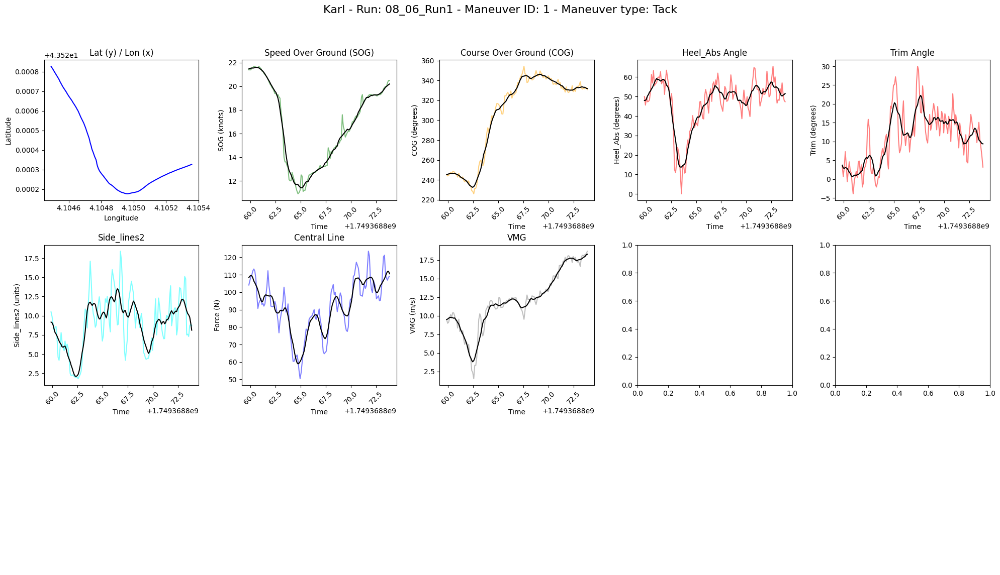


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-08 07:47:57.759000+00:00
  Maneuver Type: Tack
  Duration: 14.10099983215332 seconds
  Start Time: 1749368877.759
  End Time: 1749368891.86
  boat_name: Karl Maeder

avg TWS: 8.83 knots
avg TWA: 31.69 degrees
avg TWD: 302.04 degrees


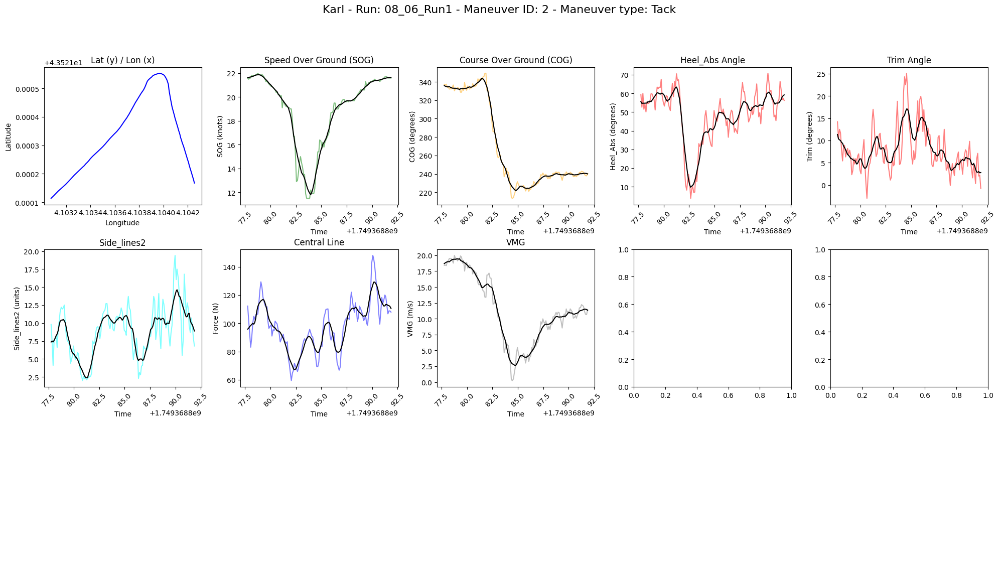


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-08 07:48:10.957000+00:00
  Maneuver Type: Tack
  Duration: 14.115999937057495 seconds
  Start Time: 1749368890.957
  End Time: 1749368905.073
  boat_name: Karl Maeder

avg TWS: 9.57 knots
avg TWA: -8.84 degrees
avg TWD: 296.73 degrees


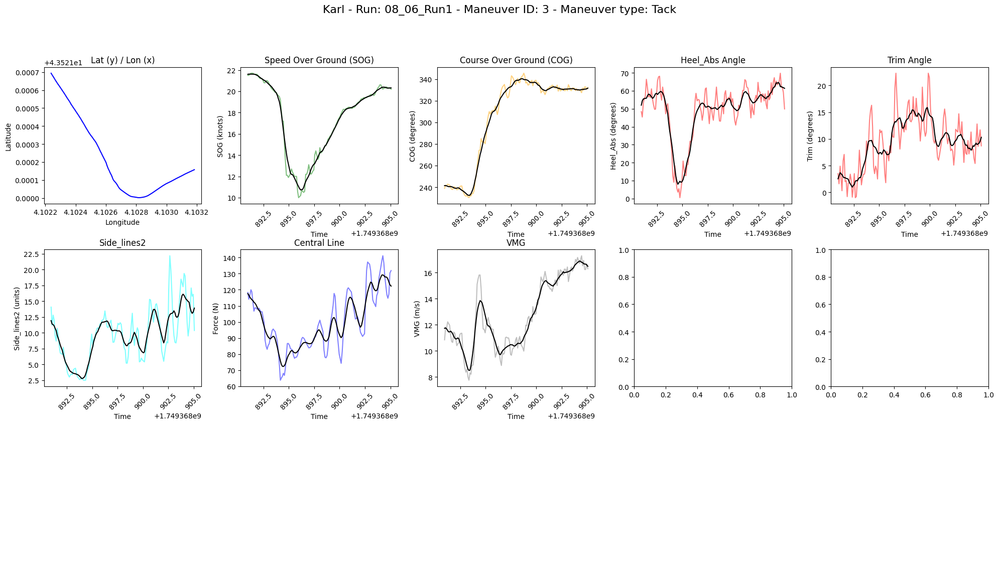


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-08 07:48:30.073000+00:00
  Maneuver Type: Tack
  Duration: 13.88700008392334 seconds
  Start Time: 1749368910.073
  End Time: 1749368923.96
  boat_name: Karl Maeder

avg TWS: 8.71 knots
avg TWA: 19.89 degrees
avg TWD: 290.02 degrees


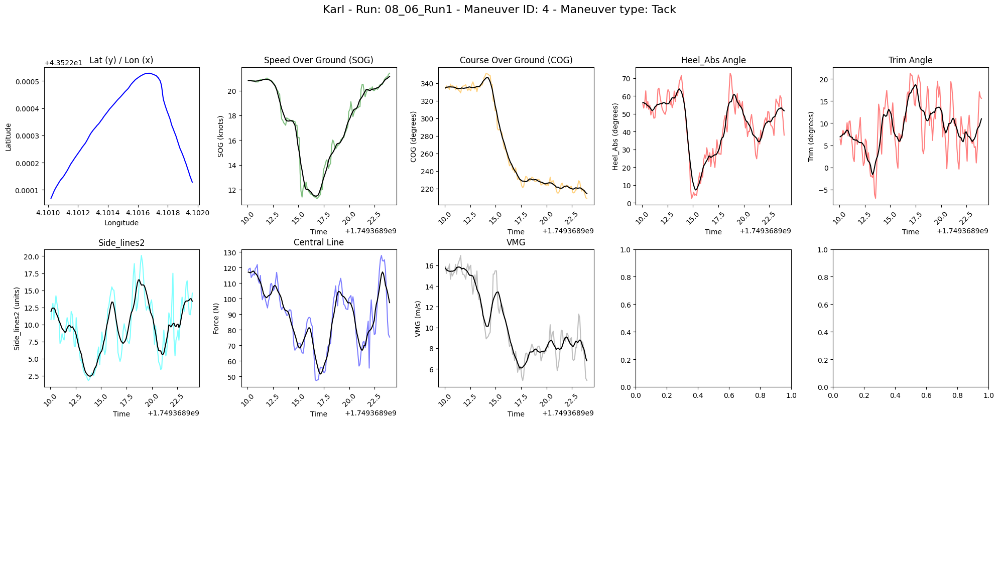


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-08 07:48:52.359000+00:00
  Maneuver Type: Jibe
  Duration: 14.098000049591064 seconds
  Start Time: 1749368932.359
  End Time: 1749368946.457
  boat_name: Karl Maeder

avg TWS: 8.61 knots
avg TWA: -42.58 degrees
avg TWD: 289.87 degrees


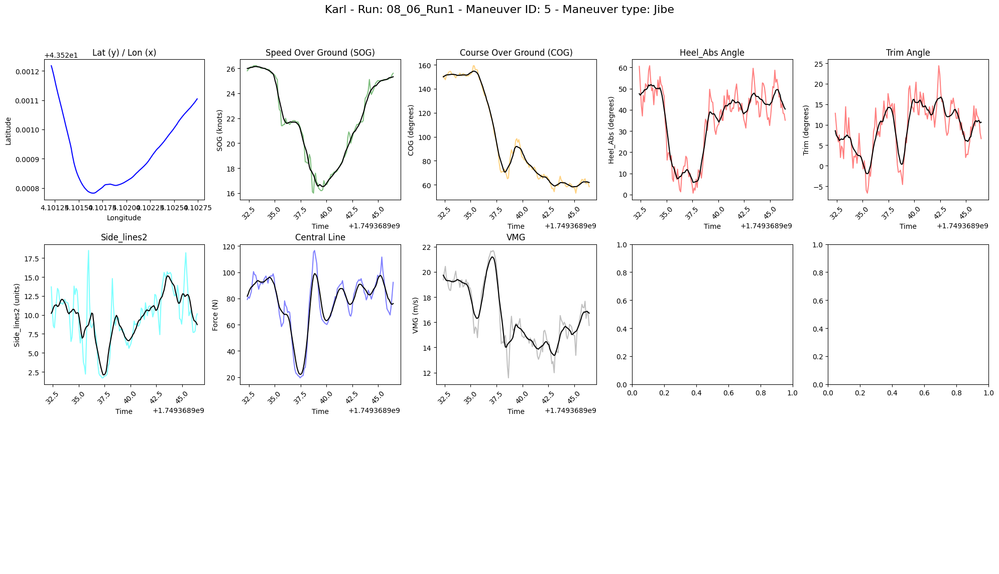


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-08 07:49:07.062000+00:00
  Maneuver Type: Jibe
  Duration: 14.0 seconds
  Start Time: 1749368947.062
  End Time: 1749368961.062
  boat_name: Karl Maeder

avg TWS: 9.58 knots
avg TWA: 28.96 degrees
avg TWD: 292.13 degrees


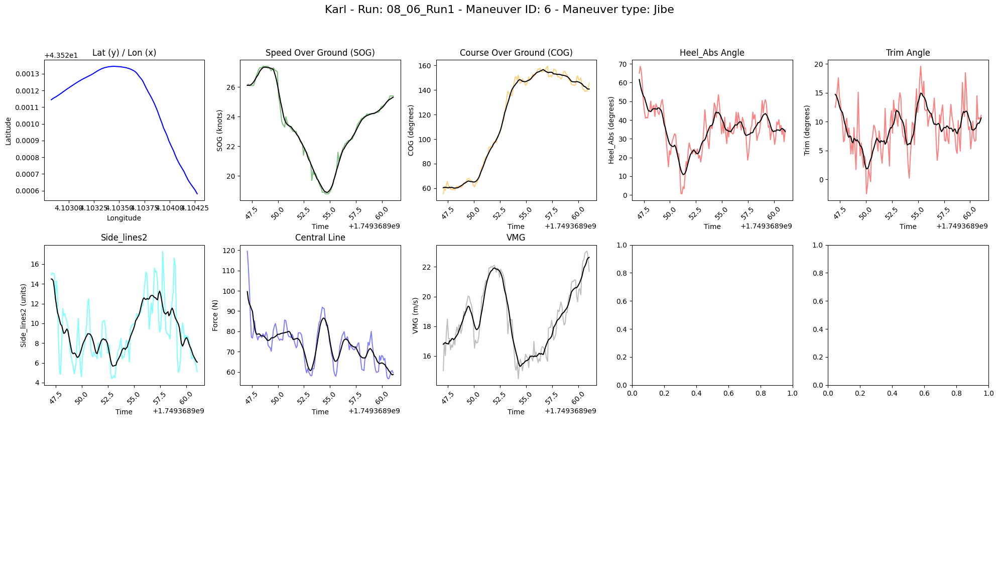


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-08 07:49:19.260000+00:00
  Maneuver Type: Jibe
  Duration: 14.002000093460085 seconds
  Start Time: 1749368959.26
  End Time: 1749368973.262
  boat_name: Karl Maeder

avg TWS: 10.15 knots
avg TWA: -45.36 degrees
avg TWD: 294.52 degrees


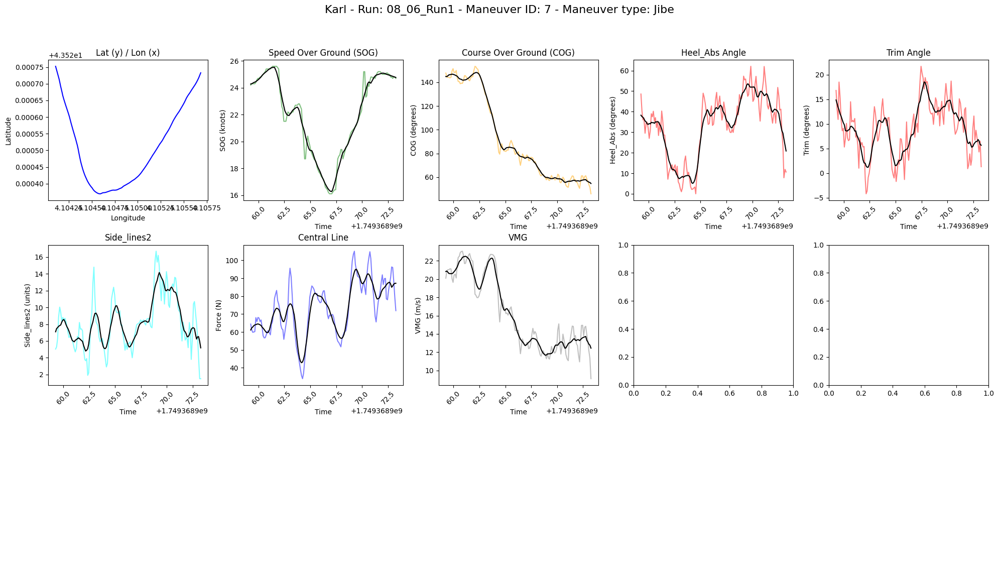


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-08 07:49:33.759000+00:00
  Maneuver Type: buoy
  Duration: 14.000999927520752 seconds
  Start Time: 1749368973.759
  End Time: 1749368987.76
  boat_name: Karl Maeder

avg TWS: 9.08 knots
avg TWA: 73.53 degrees
avg TWD: 294.67 degrees


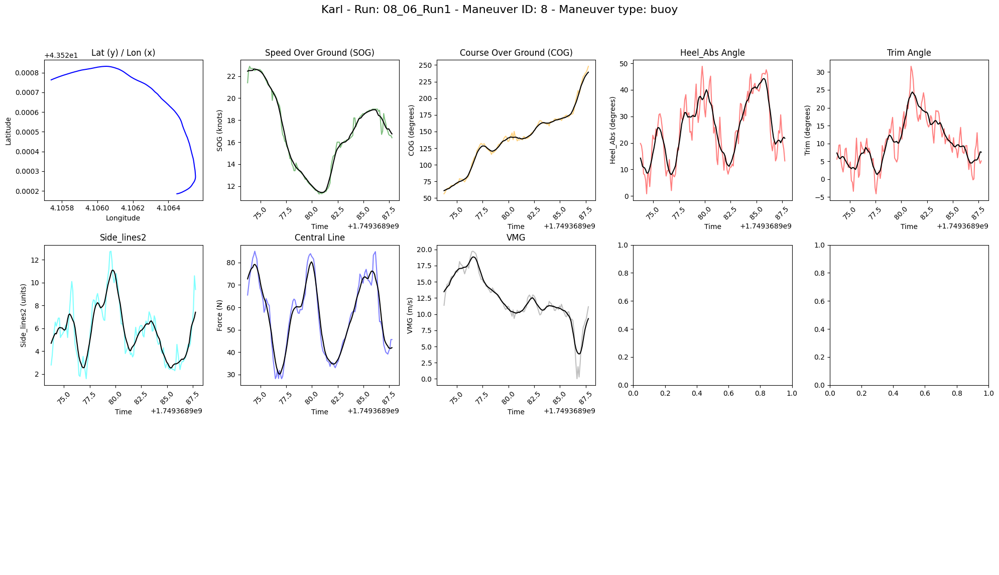


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-08 07:50:22.262000+00:00
  Maneuver Type: Tack
  Duration: 13.997999906539915 seconds
  Start Time: 1749369022.262
  End Time: 1749369036.26
  boat_name: Karl Maeder

avg TWS: 8.61 knots
avg TWA: -1.05 degrees
avg TWD: 299.63 degrees


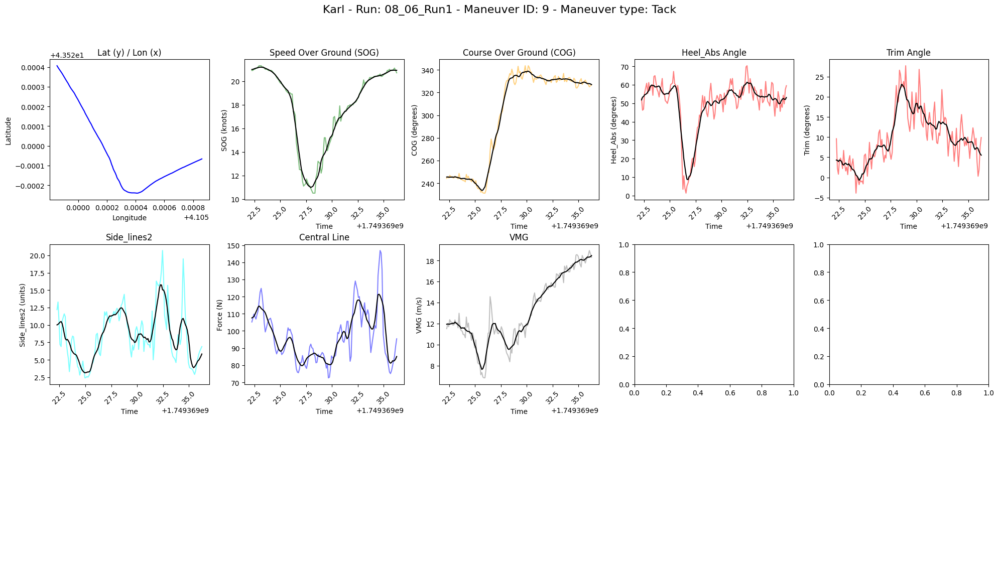


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-08 07:50:39.160000+00:00
  Maneuver Type: Tack
  Duration: 14.003000020980837 seconds
  Start Time: 1749369039.16
  End Time: 1749369053.163
  boat_name: Karl Maeder

avg TWS: 8.97 knots
avg TWA: 21.16 degrees
avg TWD: 297.75 degrees


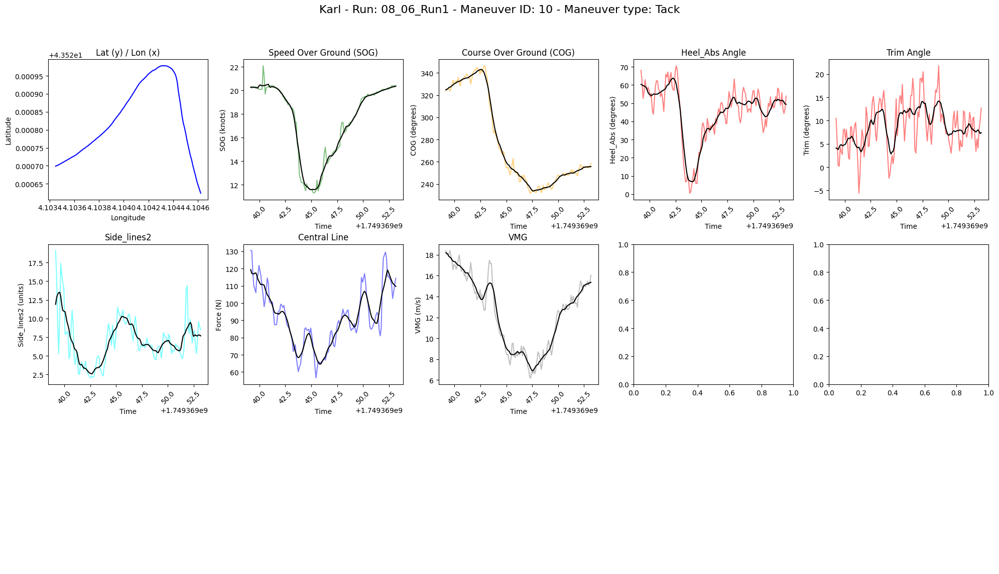


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-08 07:50:54.558000+00:00
  Maneuver Type: Tack
  Duration: 14.003000020980837 seconds
  Start Time: 1749369054.558
  End Time: 1749369068.561
  boat_name: Karl Maeder

avg TWS: 9.79 knots
avg TWA: -20.28 degrees
avg TWD: 296.20 degrees


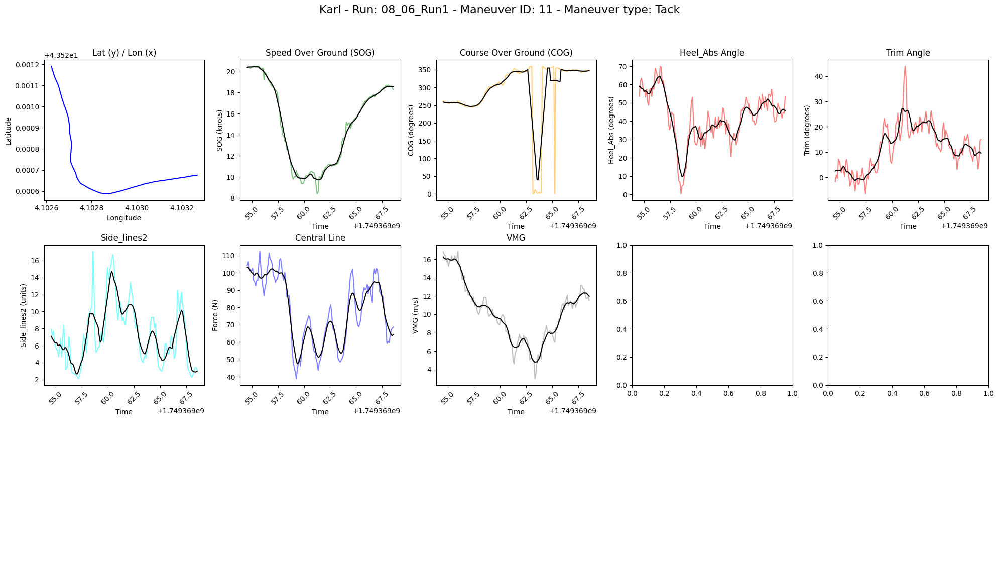


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-08 07:51:19.466000+00:00
  Maneuver Type: Tack
  Duration: 13.993000030517578 seconds
  Start Time: 1749369079.466
  End Time: 1749369093.459
  boat_name: Karl Maeder

avg TWS: 10.48 knots
avg TWA: 30.51 degrees
avg TWD: 301.39 degrees


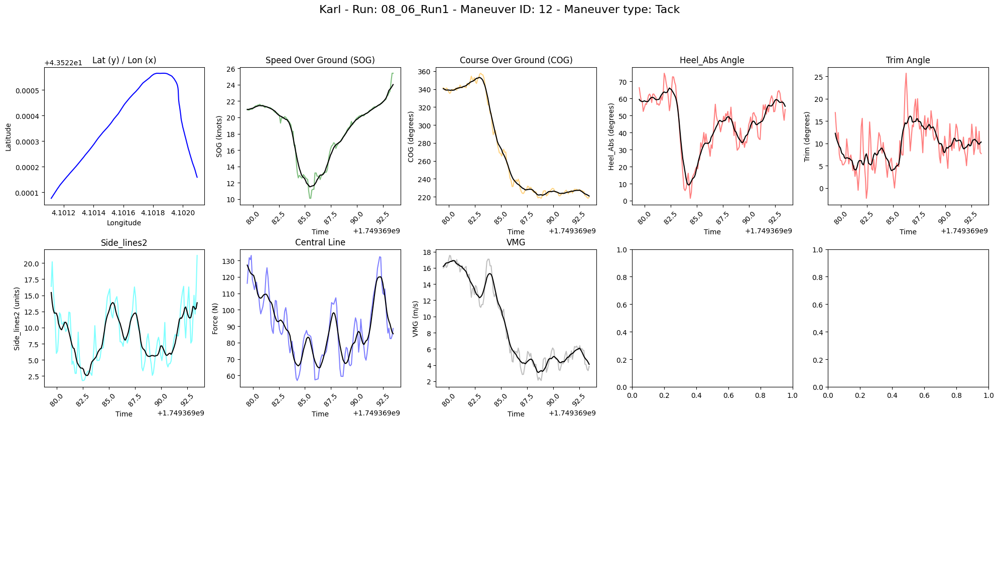


Maneuver details for Maneuver Index: 13
  Maneuver Time: 2025-06-08 07:51:44.559000+00:00
  Maneuver Type: Jibe
  Duration: 14.002000093460085 seconds
  Start Time: 1749369104.559
  End Time: 1749369118.561
  boat_name: Karl Maeder

avg TWS: 10.23 knots
avg TWA: -34.04 degrees
avg TWD: 299.93 degrees


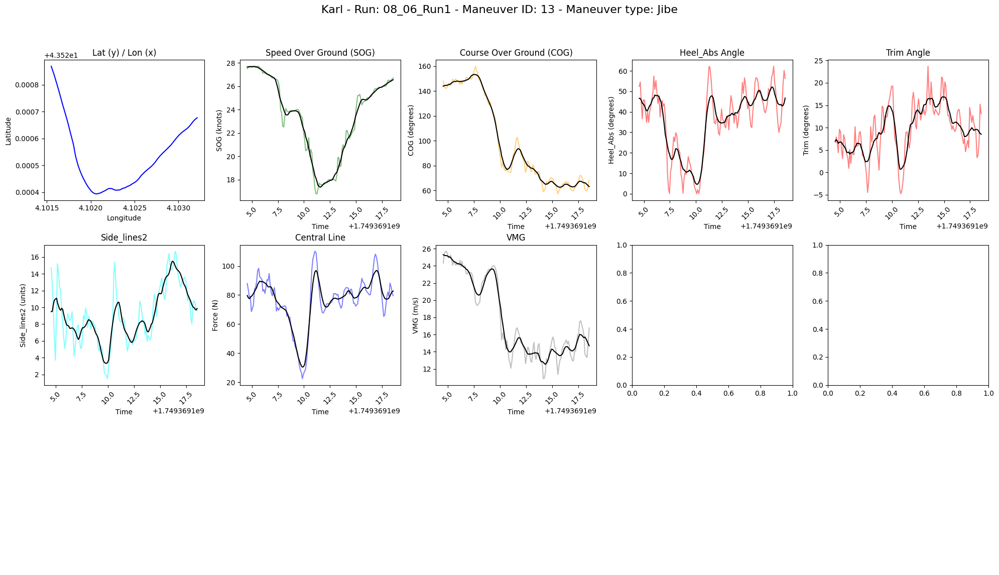


Maneuver details for Maneuver Index: 14
  Maneuver Time: 2025-06-08 07:51:59.360000+00:00
  Maneuver Type: Jibe
  Duration: 14.100000143051147 seconds
  Start Time: 1749369119.36
  End Time: 1749369133.46
  boat_name: Karl Maeder

avg TWS: 10.39 knots
avg TWA: 58.64 degrees
avg TWD: 299.36 degrees


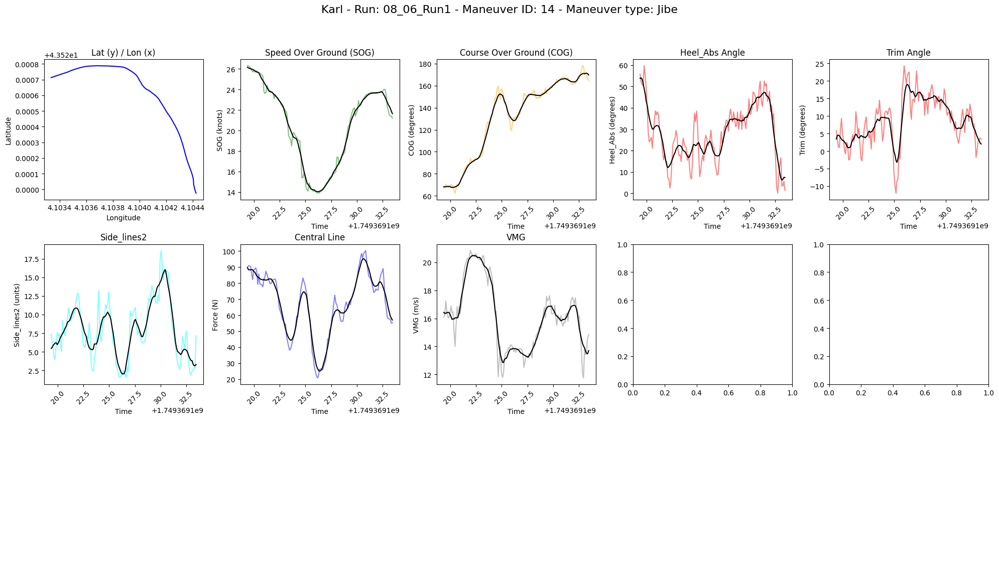

Summary for Karl - Run: 08_06_Run2

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-08 08:01:30.561000+00:00
  Maneuver Type: Tack
  Duration: 14.096999883651732 seconds
  Start Time: 1749369690.561
  End Time: 1749369704.658
  boat_name: Karl Maeder

avg TWS: 9.55 knots
avg TWA: -10.15 degrees
avg TWD: 289.24 degrees


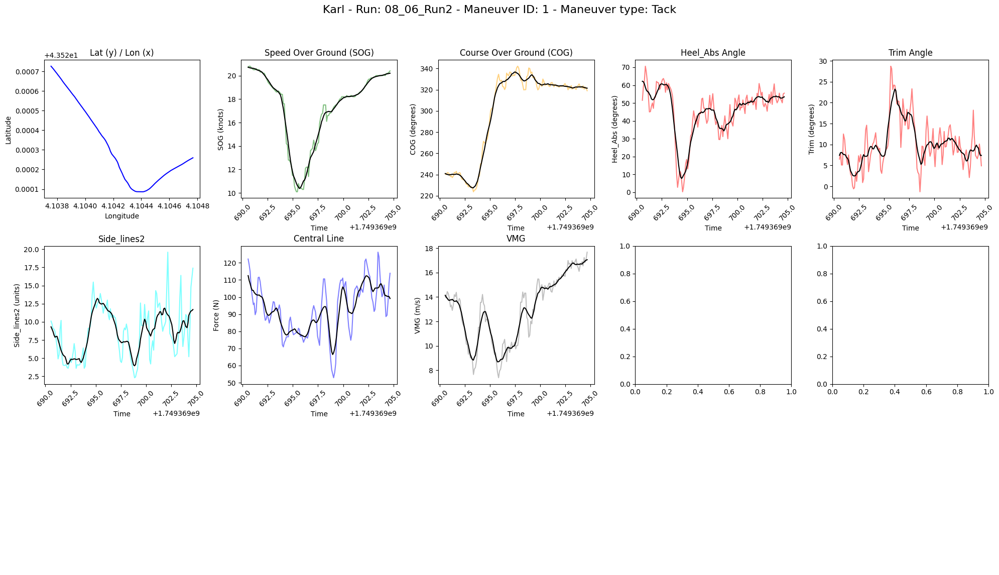


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-08 08:01:49.658000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749369709.658
  End Time: 1749369723.658
  boat_name: Karl Maeder

avg TWS: 9.71 knots
avg TWA: 19.38 degrees
avg TWD: 290.89 degrees


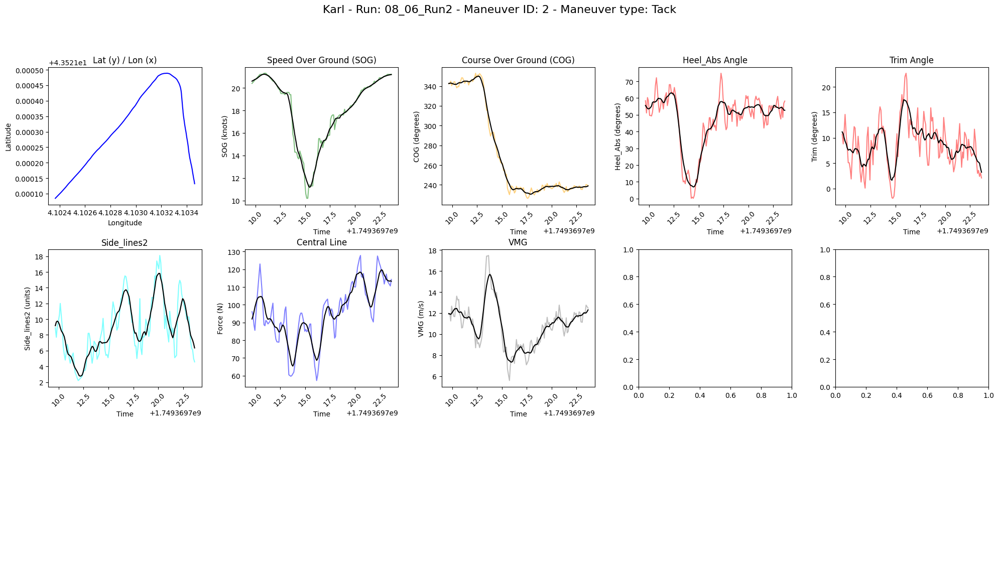


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-08 08:02:01.960000+00:00
  Maneuver Type: Tack
  Duration: 13.98799991607666 seconds
  Start Time: 1749369721.96
  End Time: 1749369735.948
  boat_name: Karl Maeder

avg TWS: 10.21 knots
avg TWA: -14.82 degrees
avg TWD: 290.63 degrees


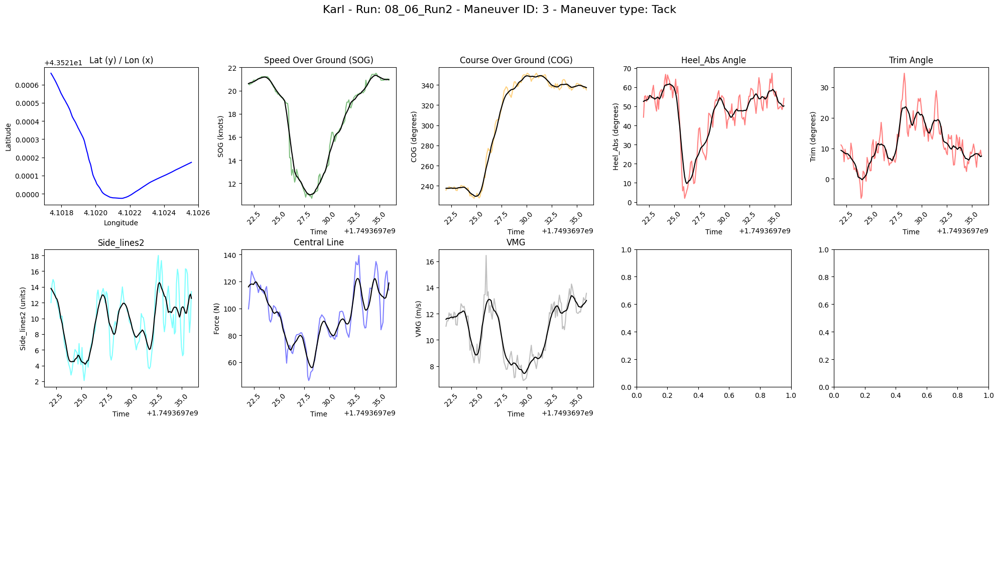


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-08 08:02:18.160000+00:00
  Maneuver Type: buoy
  Duration: 13.898000001907349 seconds
  Start Time: 1749369738.16
  End Time: 1749369752.058
  boat_name: Karl Maeder

avg TWS: 7.95 knots
avg TWA: 29.09 degrees
avg TWD: 285.18 degrees


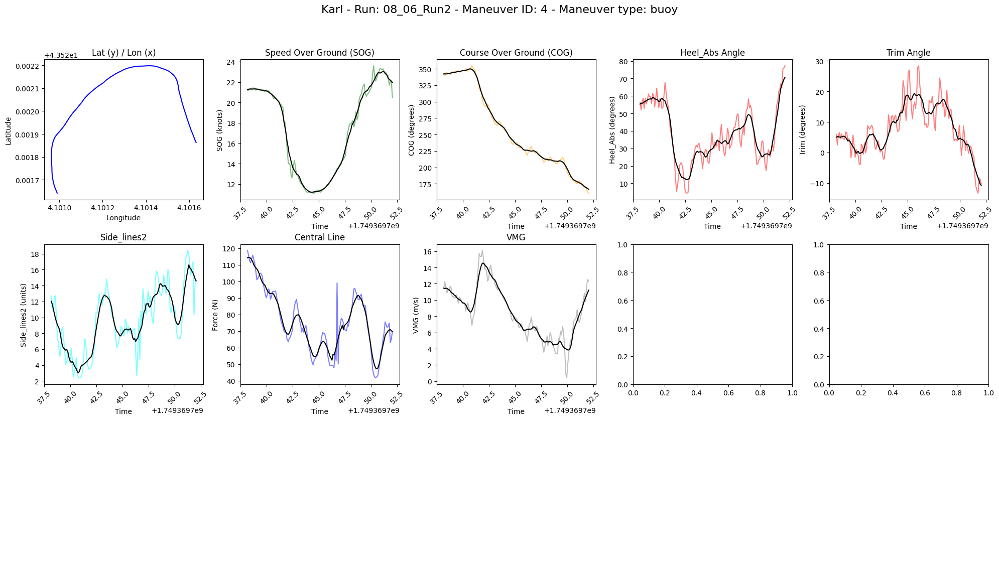


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-08 08:02:44.959000+00:00
  Maneuver Type: Jibe
  Duration: 14.000999927520752 seconds
  Start Time: 1749369764.959
  End Time: 1749369778.96
  boat_name: Karl Maeder

avg TWS: 8.19 knots
avg TWA: -37.73 degrees
avg TWD: 291.09 degrees


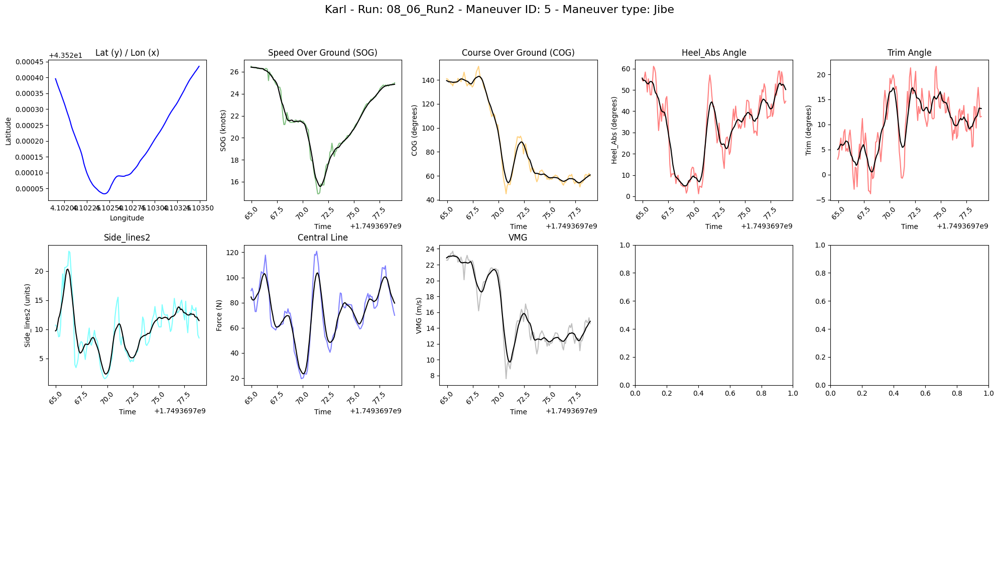


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-08 08:03:37.359000+00:00
  Maneuver Type: Tack
  Duration: 14.000999927520752 seconds
  Start Time: 1749369817.359
  End Time: 1749369831.36
  boat_name: Karl Maeder

avg TWS: 8.17 knots
avg TWA: -16.09 degrees
avg TWD: 282.49 degrees


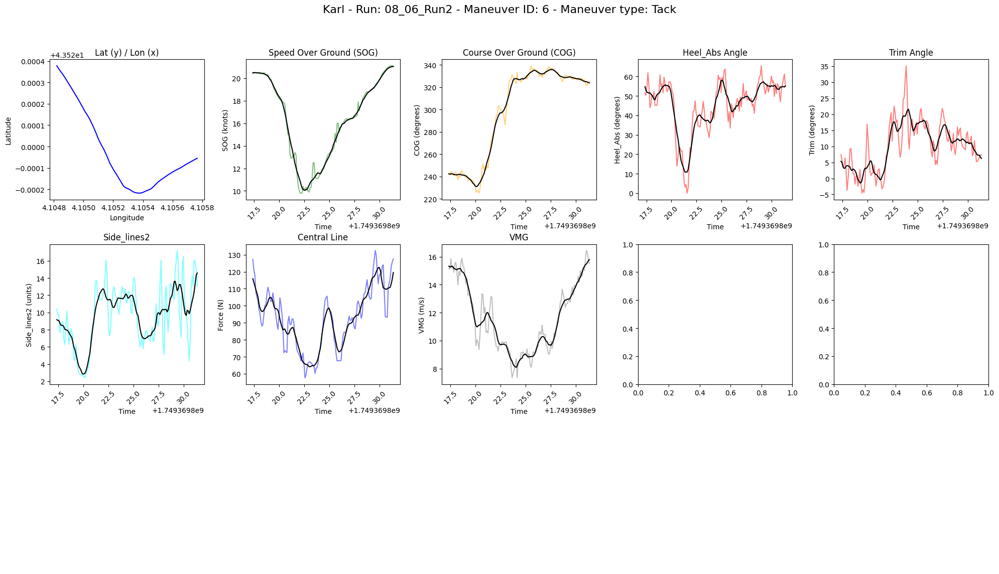


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-08 08:03:52.262000+00:00
  Maneuver Type: Tack
  Duration: 14.097999811172484 seconds
  Start Time: 1749369832.262
  End Time: 1749369846.36
  boat_name: Karl Maeder

avg TWS: 7.84 knots
avg TWA: 10.90 degrees
avg TWD: 284.41 degrees


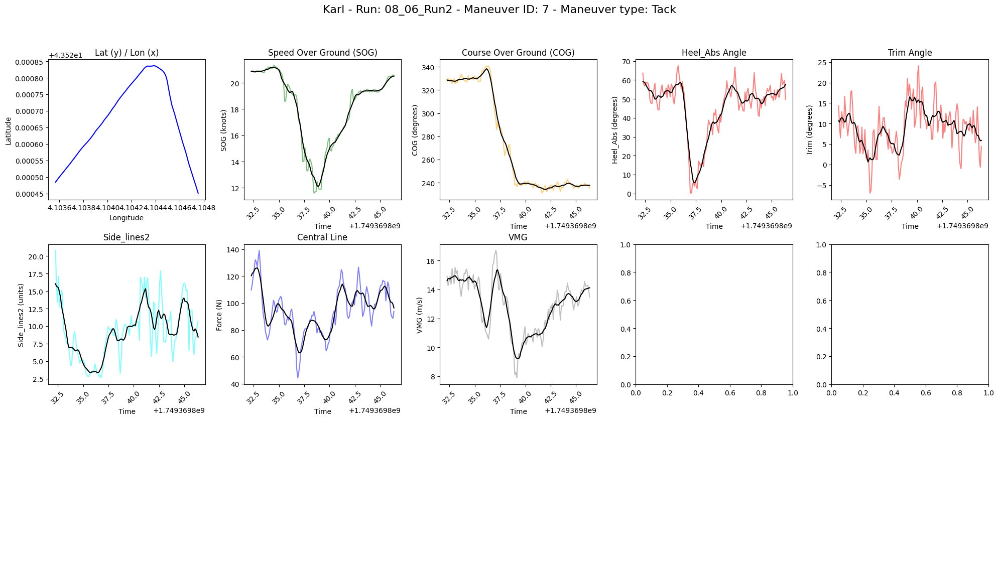


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-08 08:04:08.265000+00:00
  Maneuver Type: Tack
  Duration: 14.09499979019165 seconds
  Start Time: 1749369848.265
  End Time: 1749369862.36
  boat_name: Karl Maeder

avg TWS: 6.25 knots
avg TWA: -23.53 degrees
avg TWD: 283.98 degrees


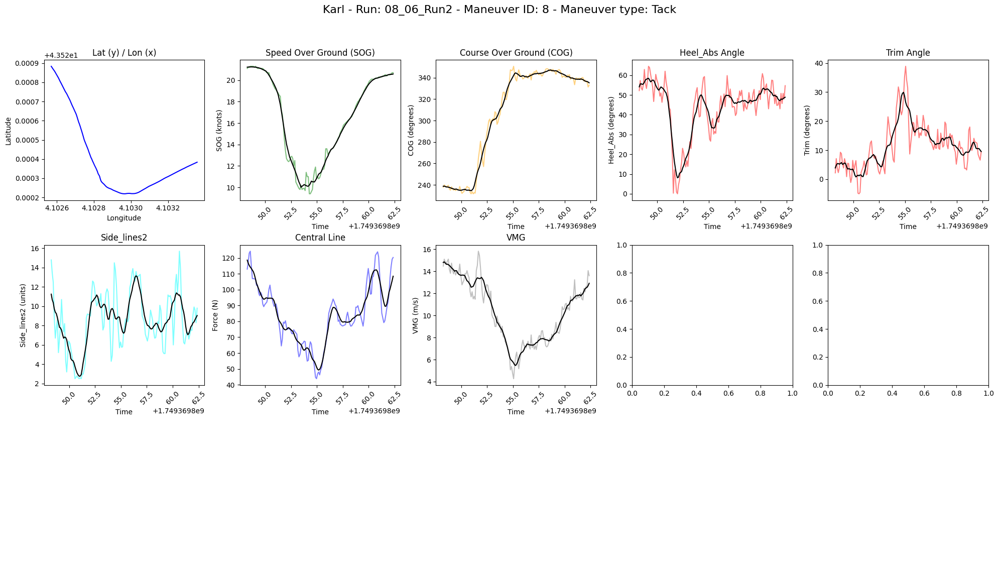


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-08 08:04:34.560000+00:00
  Maneuver Type: buoy
  Duration: 14.098000049591064 seconds
  Start Time: 1749369874.56
  End Time: 1749369888.658
  boat_name: Karl Maeder

avg TWS: 8.82 knots
avg TWA: 22.98 degrees
avg TWD: 284.78 degrees


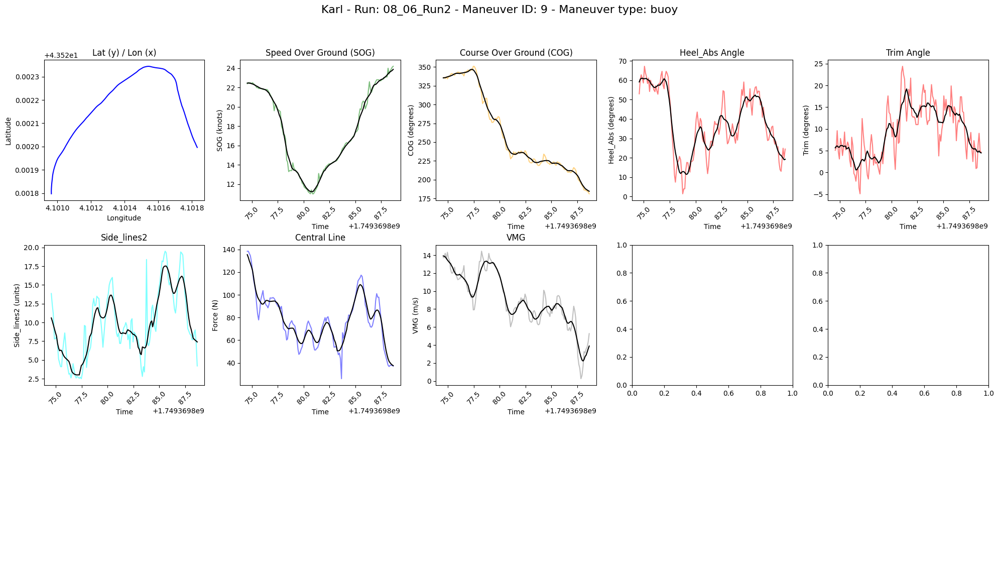


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-08 08:04:56.559000+00:00
  Maneuver Type: Jibe
  Duration: 14.0 seconds
  Start Time: 1749369896.559
  End Time: 1749369910.559
  boat_name: Karl Maeder

avg TWS: 8.69 knots
avg TWA: -69.43 degrees
avg TWD: 287.30 degrees


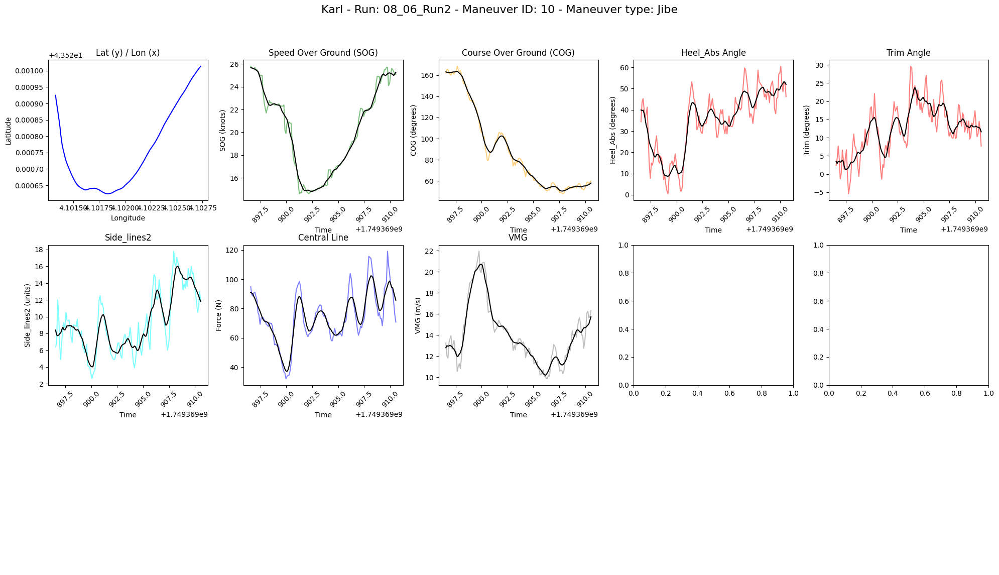


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-08 08:05:25.262000+00:00
  Maneuver Type: Jibe
  Duration: 13.997999906539915 seconds
  Start Time: 1749369925.262
  End Time: 1749369939.26
  boat_name: Karl Maeder

avg TWS: 9.92 knots
avg TWA: 57.86 degrees
avg TWD: 279.50 degrees


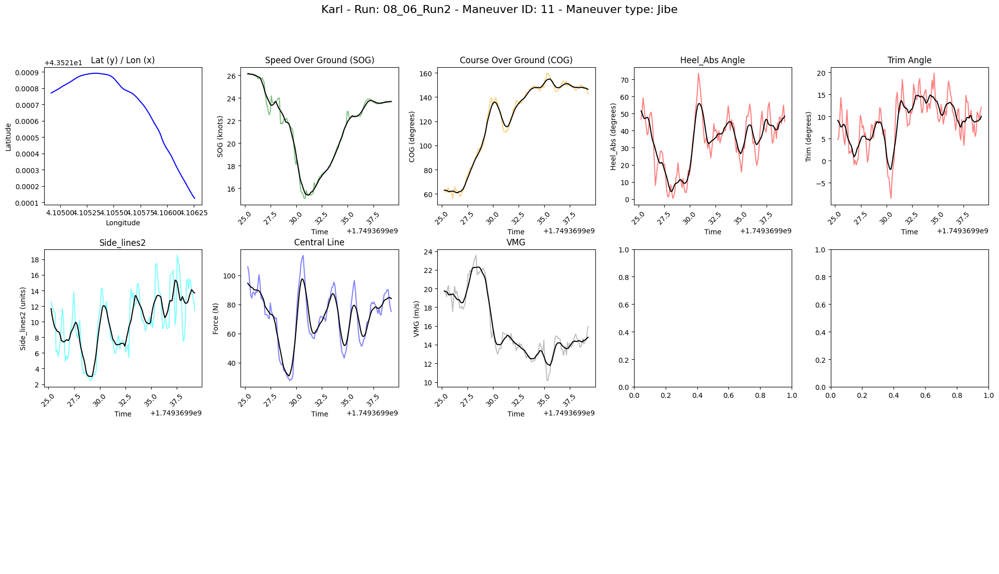


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-08 08:05:43.461000+00:00
  Maneuver Type: buoy
  Duration: 14.100000143051147 seconds
  Start Time: 1749369943.461
  End Time: 1749369957.561
  boat_name: Karl Maeder

avg TWS: 8.16 knots
avg TWA: 59.24 degrees
avg TWD: 278.02 degrees


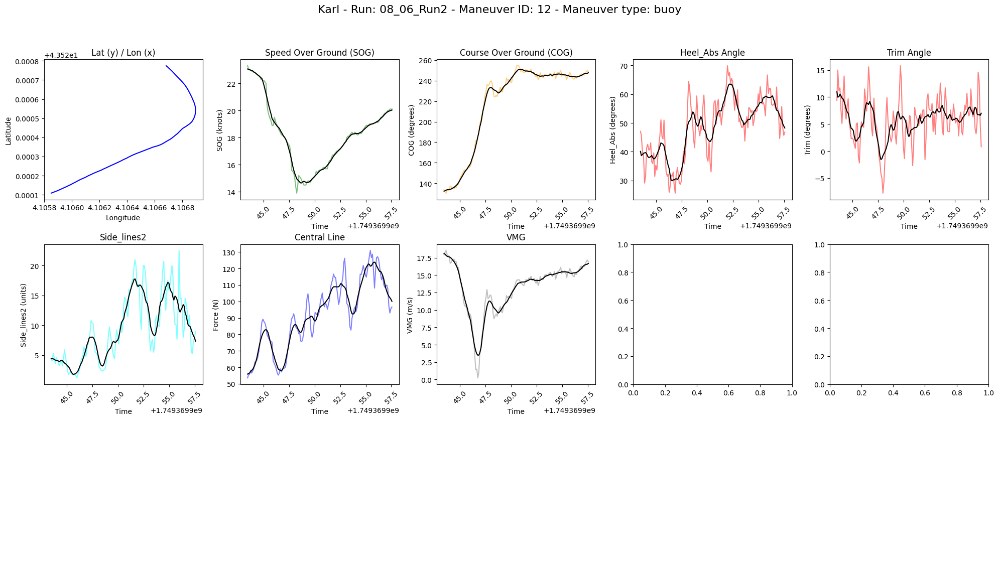

Summary for Karl - Run: 08_06_Run3

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-08 08:12:09.062000+00:00
  Maneuver Type: Tack
  Duration: 14.001999855041504 seconds
  Start Time: 1749370329.062
  End Time: 1749370343.064
  boat_name: Karl Maeder

avg TWS: 8.26 knots
avg TWA: -16.73 degrees
avg TWD: 288.44 degrees


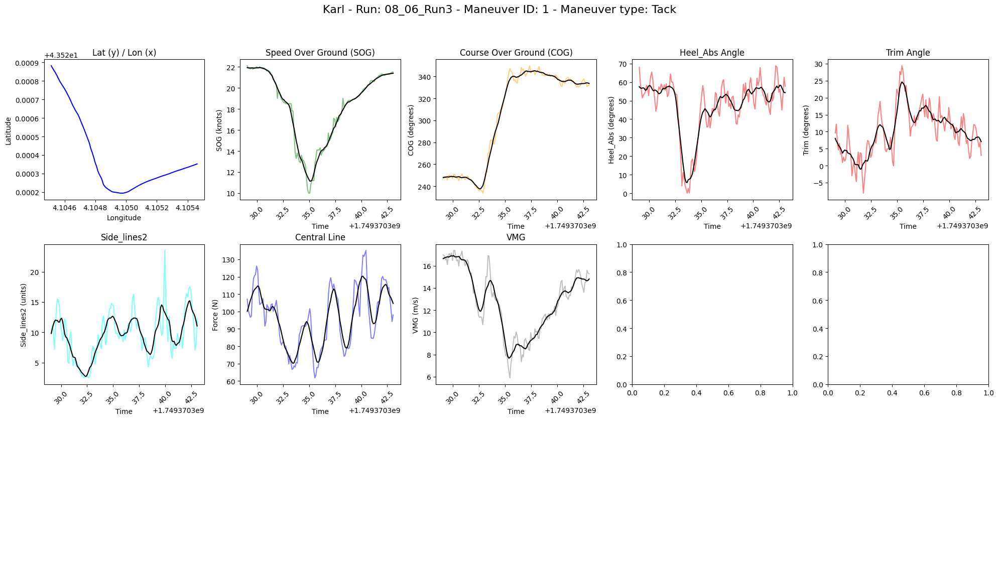


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-08 08:12:24.075000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749370344.075
  End Time: 1749370358.075
  boat_name: Karl Maeder

avg TWS: 8.39 knots
avg TWA: 13.93 degrees
avg TWD: 286.72 degrees


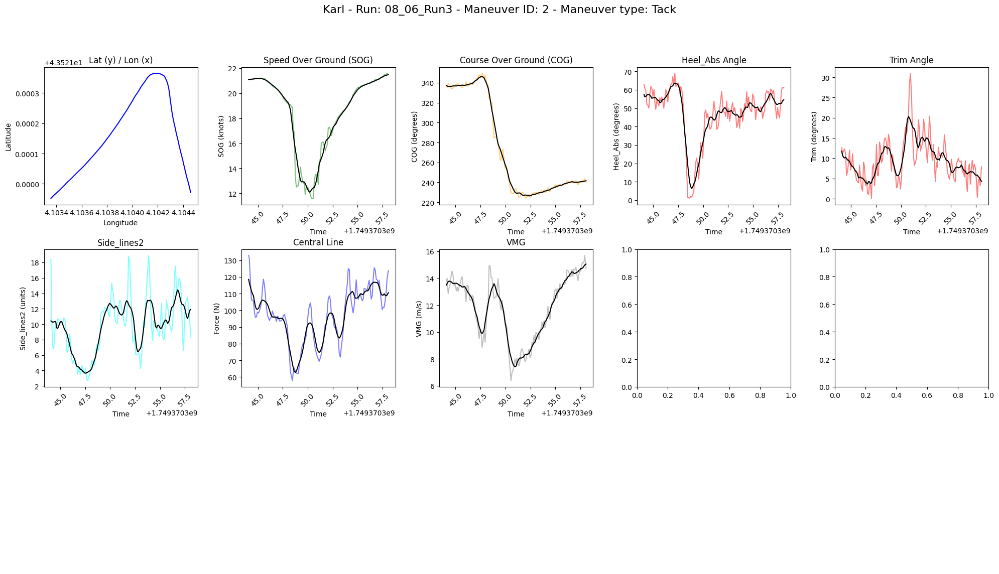


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-08 08:12:37.556000+00:00
  Maneuver Type: Tack
  Duration: 14.1010000705719 seconds
  Start Time: 1749370357.556
  End Time: 1749370371.657
  boat_name: Karl Maeder

avg TWS: 8.70 knots
avg TWA: -14.28 degrees
avg TWD: 289.49 degrees


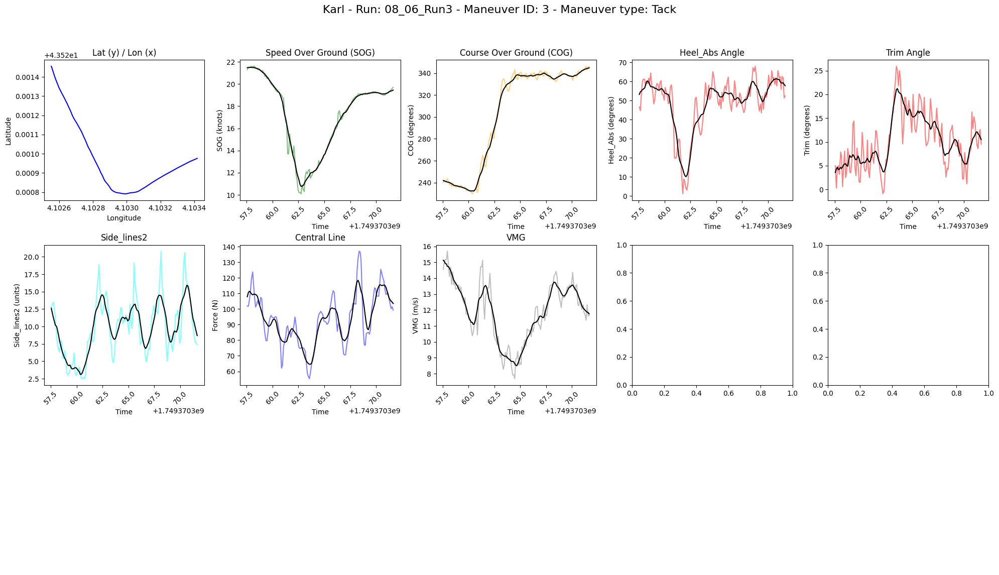


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-08 08:12:57.158000+00:00
  Maneuver Type: Tack
  Duration: 14.005000114440918 seconds
  Start Time: 1749370377.158
  End Time: 1749370391.163
  boat_name: Karl Maeder

avg TWS: 8.80 knots
avg TWA: 15.49 degrees
avg TWD: 291.90 degrees


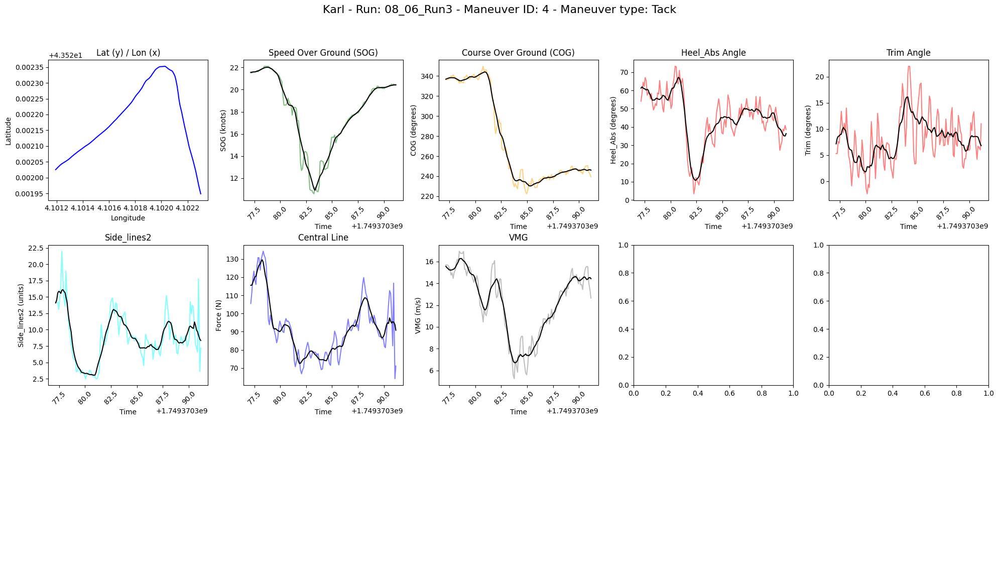


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-08 08:13:21.556000+00:00
  Maneuver Type: Jibe
  Duration: 14.003000020980837 seconds
  Start Time: 1749370401.556
  End Time: 1749370415.559
  boat_name: Karl Maeder

avg TWS: 8.31 knots
avg TWA: -61.56 degrees
avg TWD: 289.73 degrees


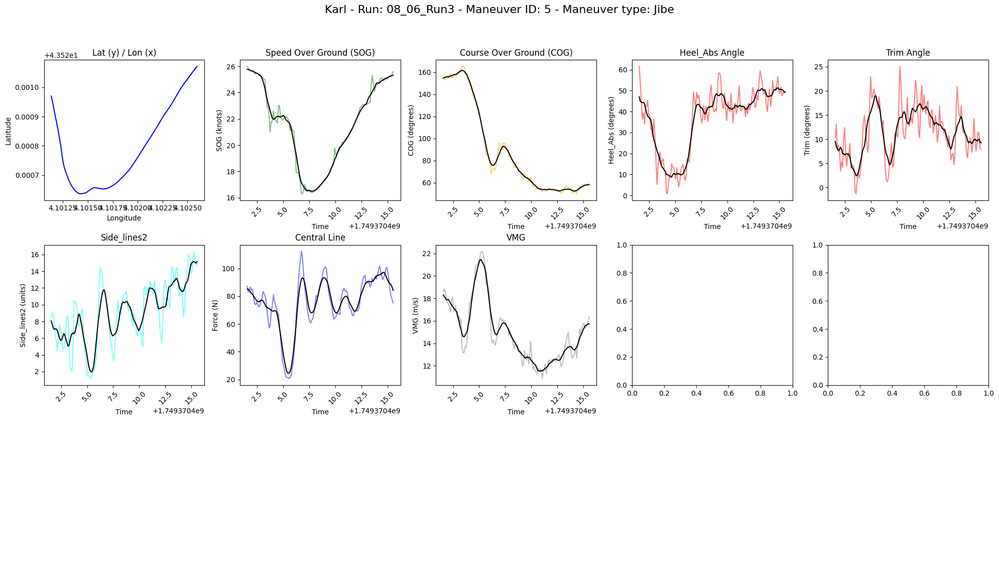


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-08 08:13:51.757000+00:00
  Maneuver Type: Jibe
  Duration: 14.101999998092651 seconds
  Start Time: 1749370431.757
  End Time: 1749370445.859
  boat_name: Karl Maeder

avg TWS: 8.16 knots
avg TWA: 31.78 degrees
avg TWD: 288.19 degrees


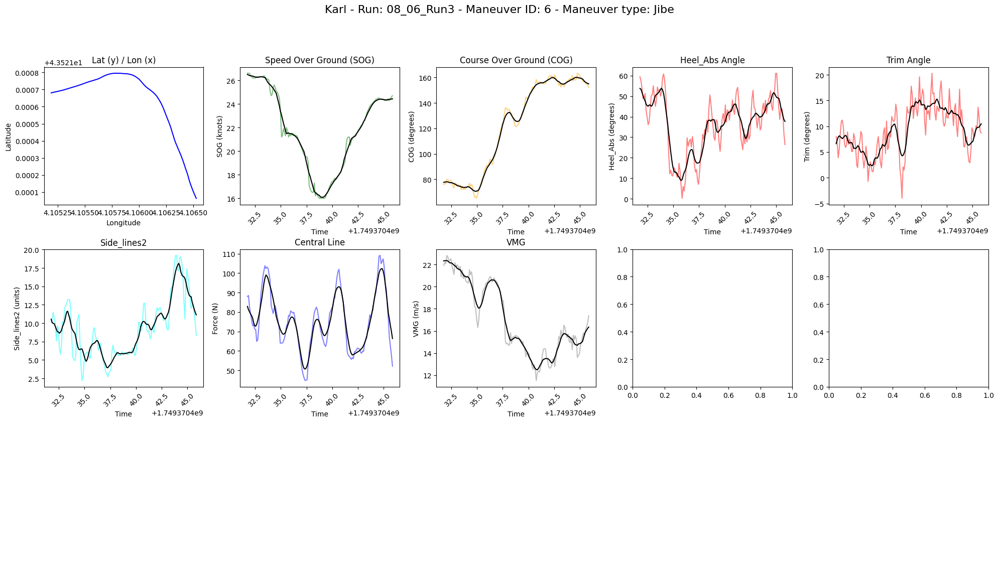


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-08 08:14:23.558000+00:00
  Maneuver Type: Tack
  Duration: 14.099999904632568 seconds
  Start Time: 1749370463.558
  End Time: 1749370477.658
  boat_name: Karl Maeder

avg TWS: 8.75 knots
avg TWA: -21.83 degrees
avg TWD: 288.07 degrees


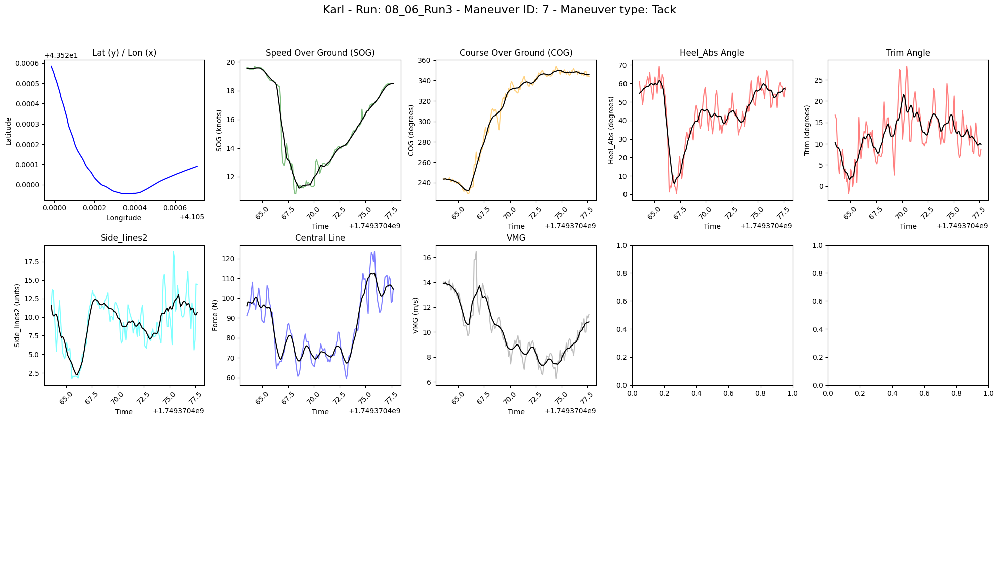


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-08 08:14:42.956000+00:00
  Maneuver Type: Tack
  Duration: 14.000999927520752 seconds
  Start Time: 1749370482.956
  End Time: 1749370496.957
  boat_name: Karl Maeder

avg TWS: 8.73 knots
avg TWA: 24.12 degrees
avg TWD: 292.49 degrees


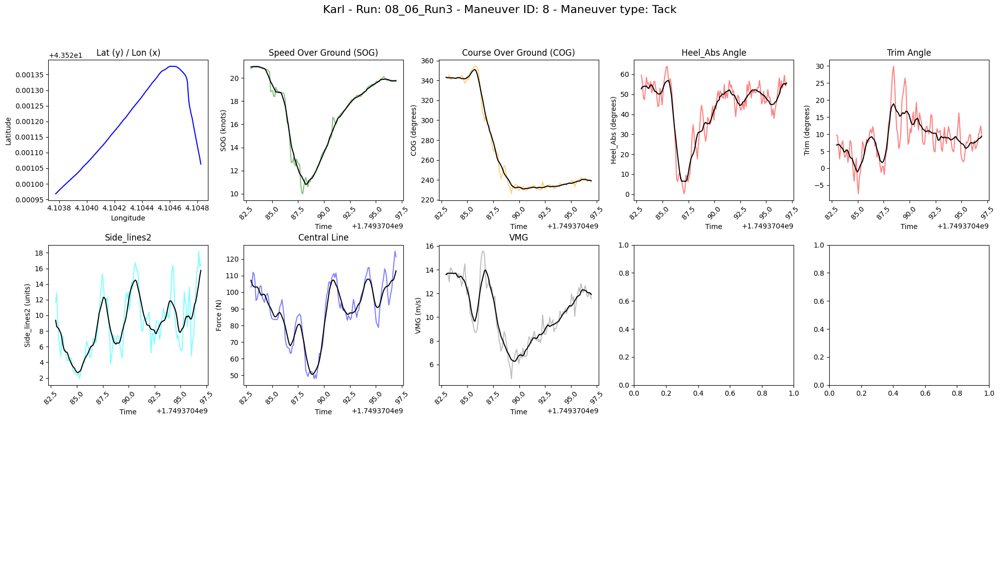


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-08 08:15:00.360000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749370500.36
  End Time: 1749370514.36
  boat_name: Karl Maeder

avg TWS: 7.83 knots
avg TWA: -22.13 degrees
avg TWD: 291.29 degrees


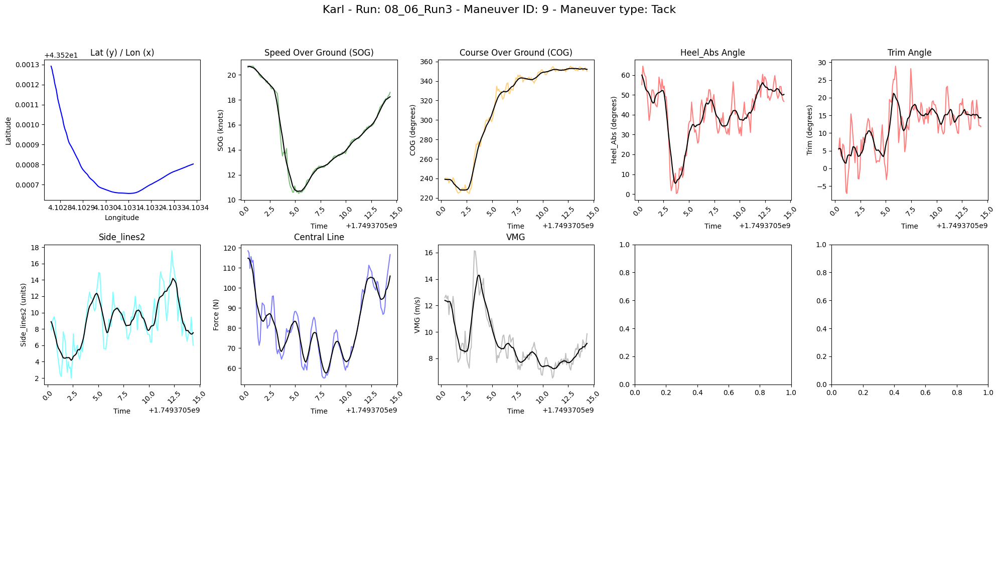


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-08 08:15:21.459000+00:00
  Maneuver Type: Tack
  Duration: 14.000999927520752 seconds
  Start Time: 1749370521.459
  End Time: 1749370535.46
  boat_name: Karl Maeder

avg TWS: 8.71 knots
avg TWA: 17.49 degrees
avg TWD: 293.73 degrees


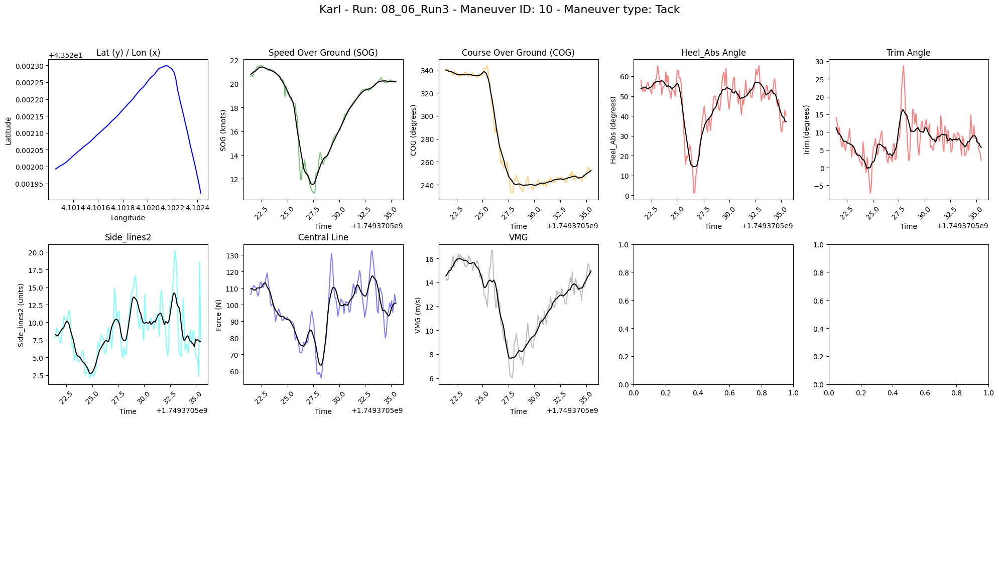


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-08 08:15:47.260000+00:00
  Maneuver Type: Jibe
  Duration: 14.002000093460085 seconds
  Start Time: 1749370547.26
  End Time: 1749370561.262
  boat_name: Karl Maeder

avg TWS: 7.65 knots
avg TWA: -61.69 degrees
avg TWD: 294.76 degrees


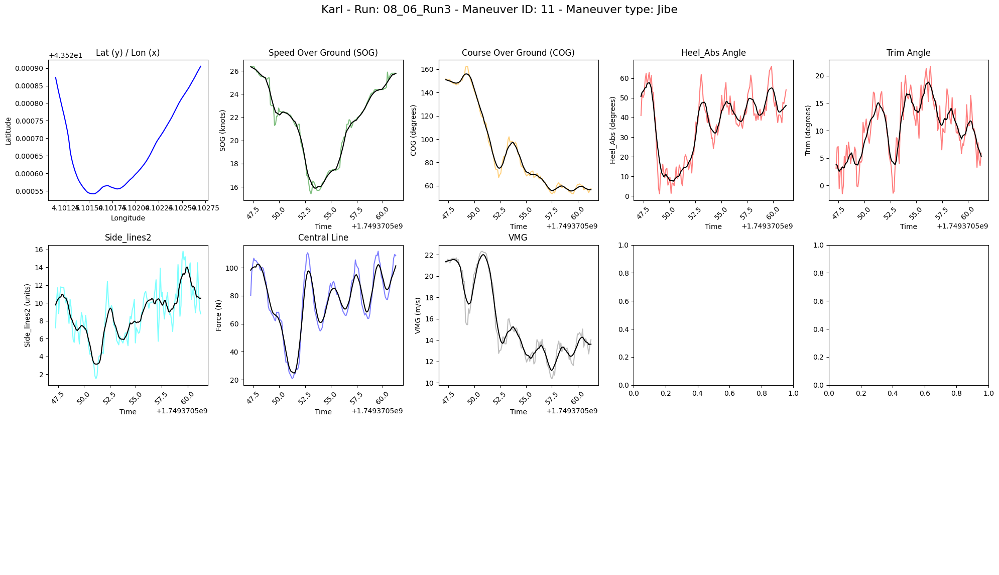


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-08 08:16:16.859000+00:00
  Maneuver Type: Jibe
  Duration: 14.0 seconds
  Start Time: 1749370576.859
  End Time: 1749370590.859
  boat_name: Karl Maeder

avg TWS: 7.45 knots
avg TWA: 48.12 degrees
avg TWD: 285.22 degrees


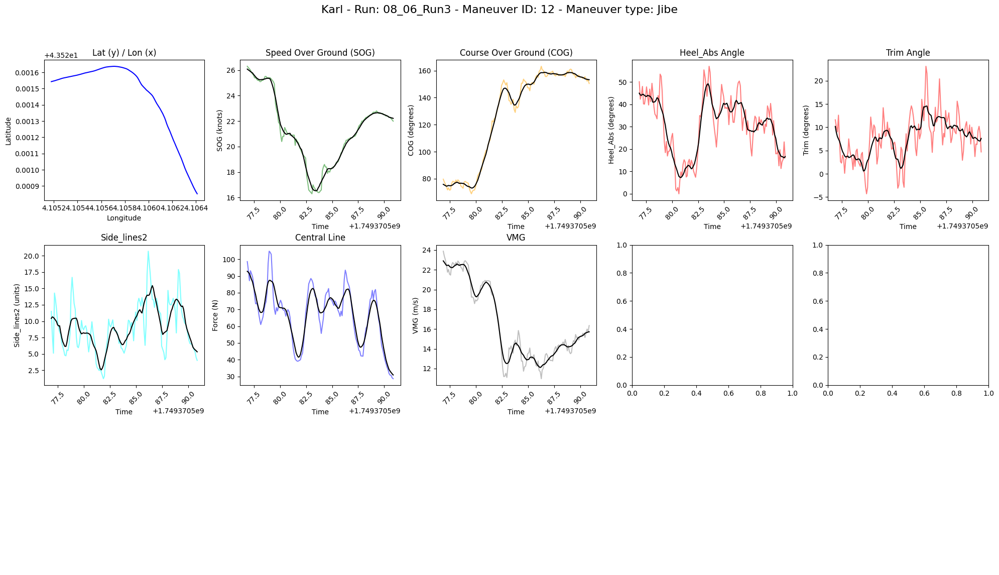


Maneuver details for Maneuver Index: 13
  Maneuver Time: 2025-06-08 08:16:31.859000+00:00
  Maneuver Type: buoy
  Duration: 14.101999998092651 seconds
  Start Time: 1749370591.859
  End Time: 1749370605.961
  boat_name: Karl Maeder

avg TWS: 8.39 knots
avg TWA: 91.89 degrees
avg TWD: 290.60 degrees


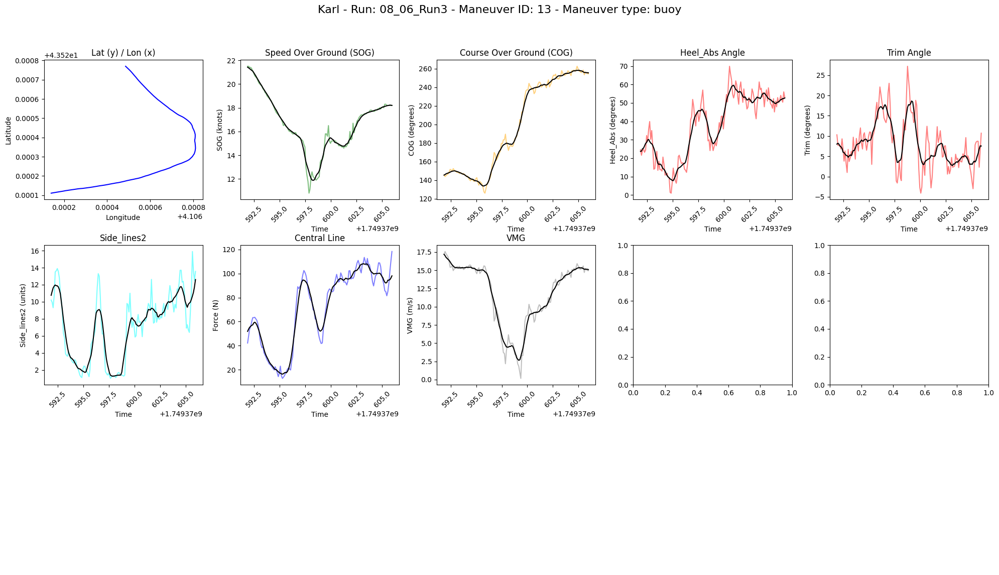

Summary for Karl - Run: 08_06_Run4

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-08 08:21:42.075000+00:00
  Maneuver Type: Tack
  Duration: 14.08899998664856 seconds
  Start Time: 1749370902.075
  End Time: 1749370916.164
  boat_name: Karl Maeder

avg TWS: 7.70 knots
avg TWA: -8.15 degrees
avg TWD: 302.30 degrees


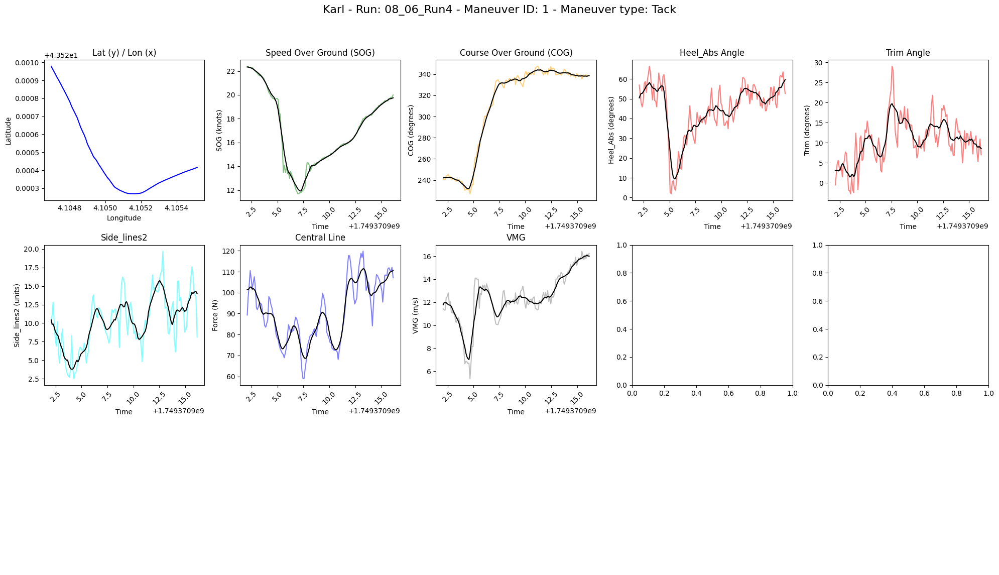


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-08 08:21:57.959000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749370917.959
  End Time: 1749370931.959
  boat_name: Karl Maeder

avg TWS: 7.33 knots
avg TWA: 23.73 degrees
avg TWD: 301.26 degrees


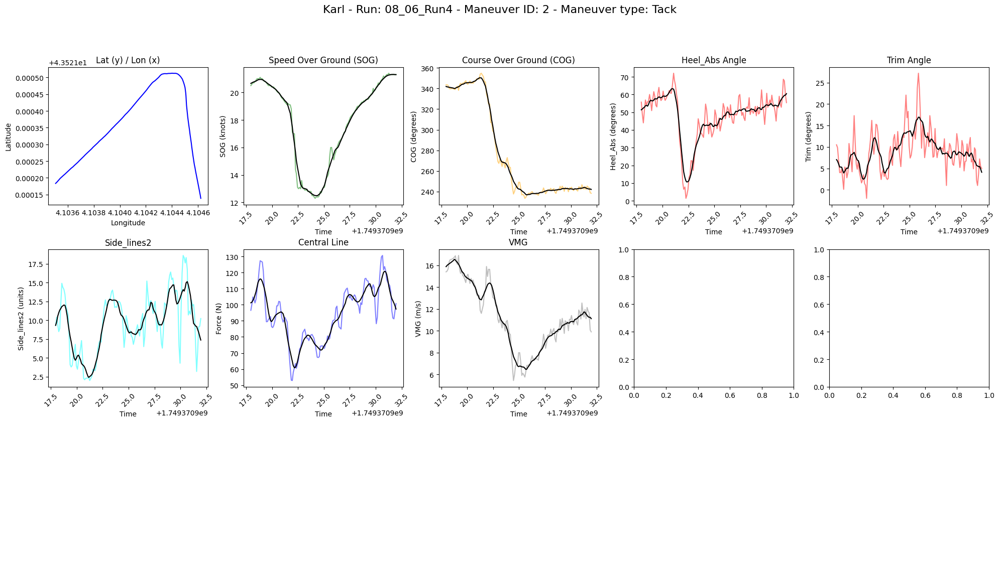


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-08 08:22:11.360000+00:00
  Maneuver Type: Tack
  Duration: 13.998000144958496 seconds
  Start Time: 1749370931.36
  End Time: 1749370945.358
  boat_name: Karl Maeder

avg TWS: 7.17 knots
avg TWA: -14.70 degrees
avg TWD: 302.62 degrees


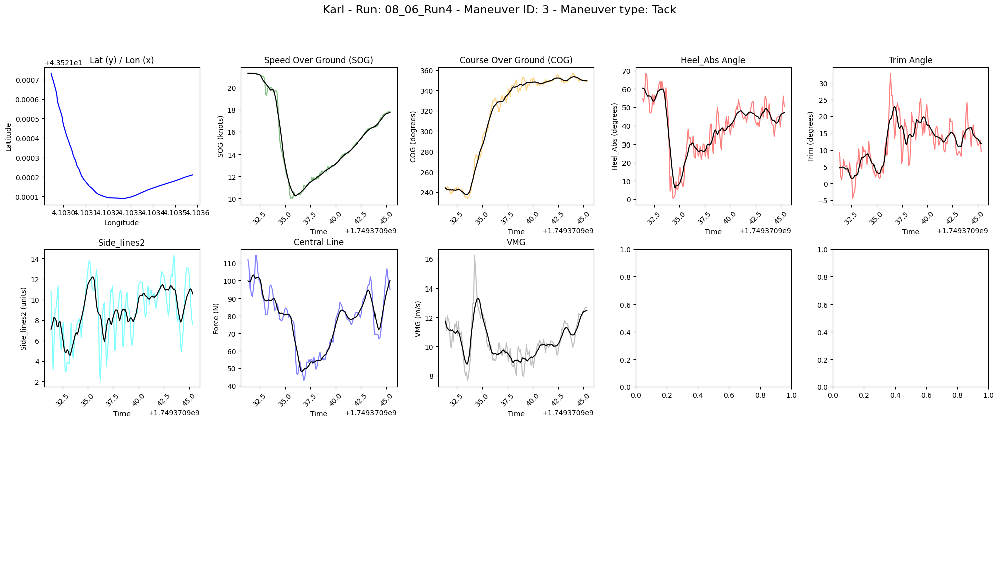


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-08 08:22:29.360000+00:00
  Maneuver Type: Tack
  Duration: 13.999000072479248 seconds
  Start Time: 1749370949.36
  End Time: 1749370963.359
  boat_name: Karl Maeder

avg TWS: 8.35 knots
avg TWA: 29.45 degrees
avg TWD: 303.44 degrees


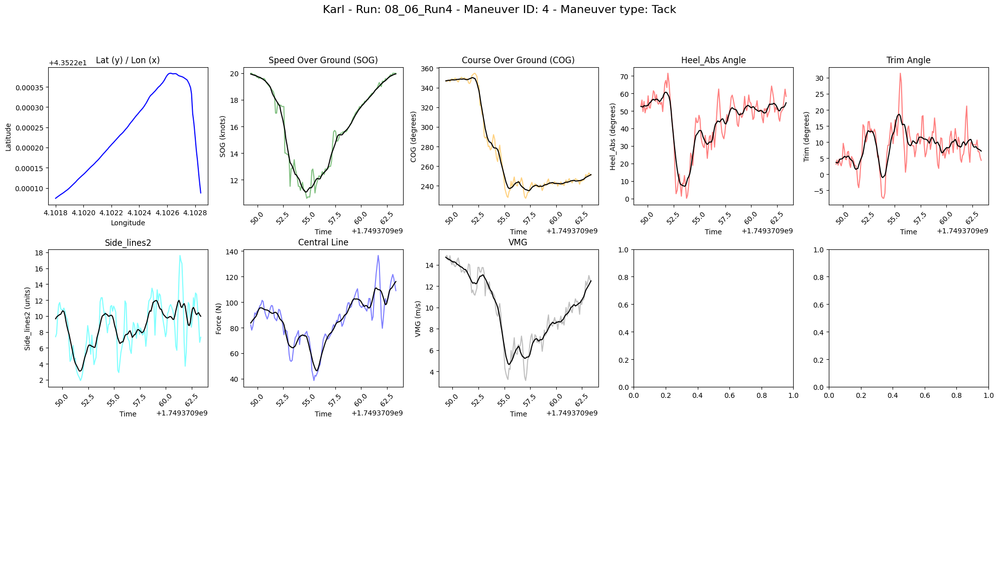


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-08 08:23:01.563000+00:00
  Maneuver Type: Jibe
  Duration: 13.998000144958496 seconds
  Start Time: 1749370981.563
  End Time: 1749370995.561
  boat_name: Karl Maeder

avg TWS: 6.48 knots
avg TWA: -42.98 degrees
avg TWD: 302.83 degrees


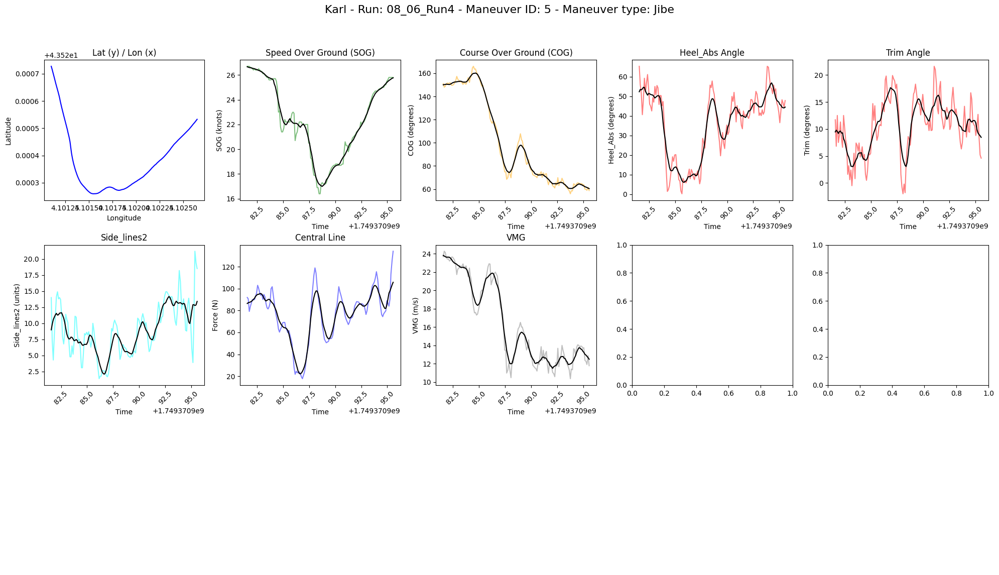


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-08 08:23:47.859000+00:00
  Maneuver Type: buoy
  Duration: 13.999000072479248 seconds
  Start Time: 1749371027.859
  End Time: 1749371041.858
  boat_name: Karl Maeder

avg TWS: 9.14 knots
avg TWA: 97.16 degrees
avg TWD: 297.73 degrees


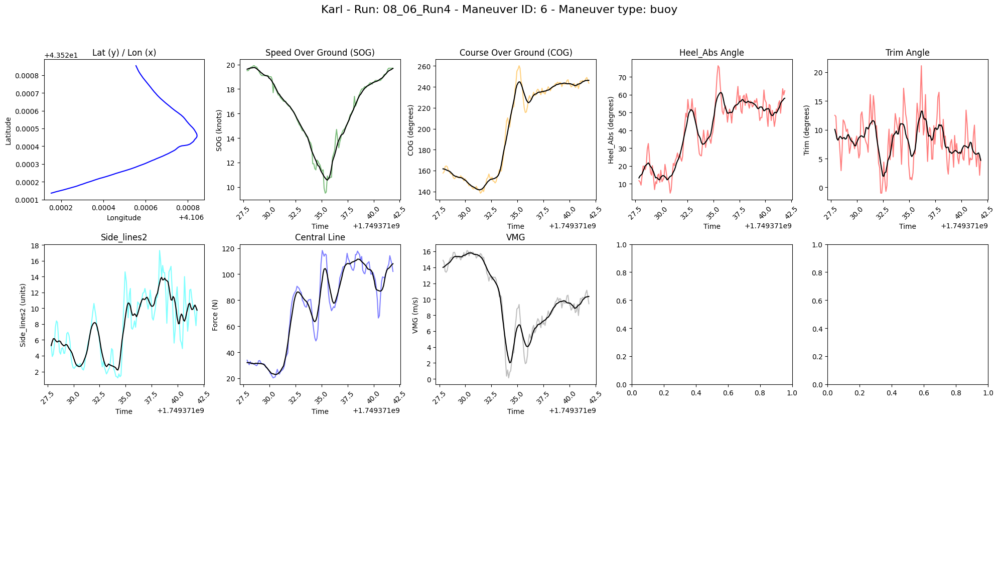


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-08 08:24:05.164000+00:00
  Maneuver Type: Tack
  Duration: 13.999000072479248 seconds
  Start Time: 1749371045.164
  End Time: 1749371059.163
  boat_name: Karl Maeder

avg TWS: 7.59 knots
avg TWA: 1.71 degrees
avg TWD: 304.00 degrees


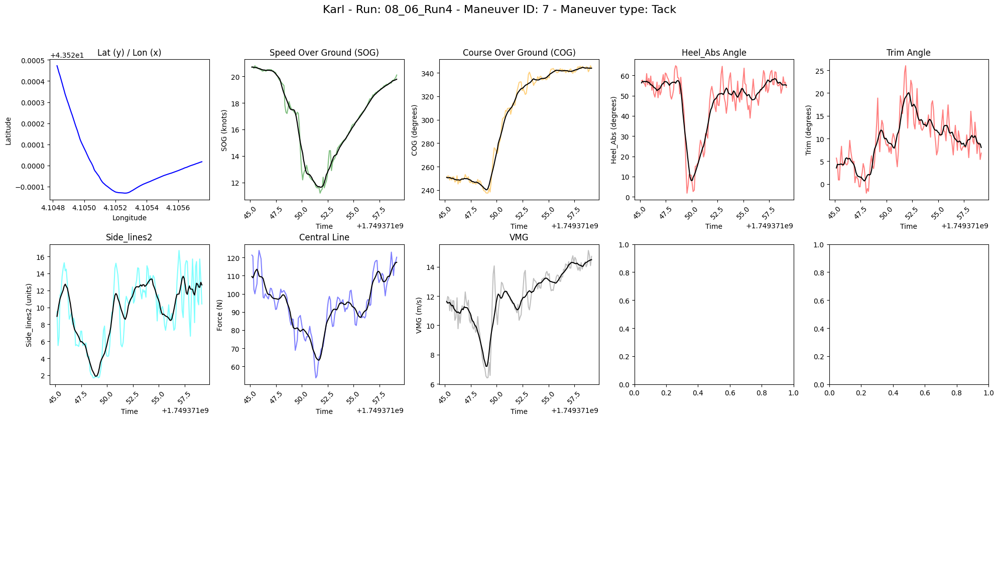


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-08 08:24:21.558000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749371061.558
  End Time: 1749371075.558
  boat_name: Karl Maeder

avg TWS: 7.86 knots
avg TWA: 30.68 degrees
avg TWD: 301.22 degrees


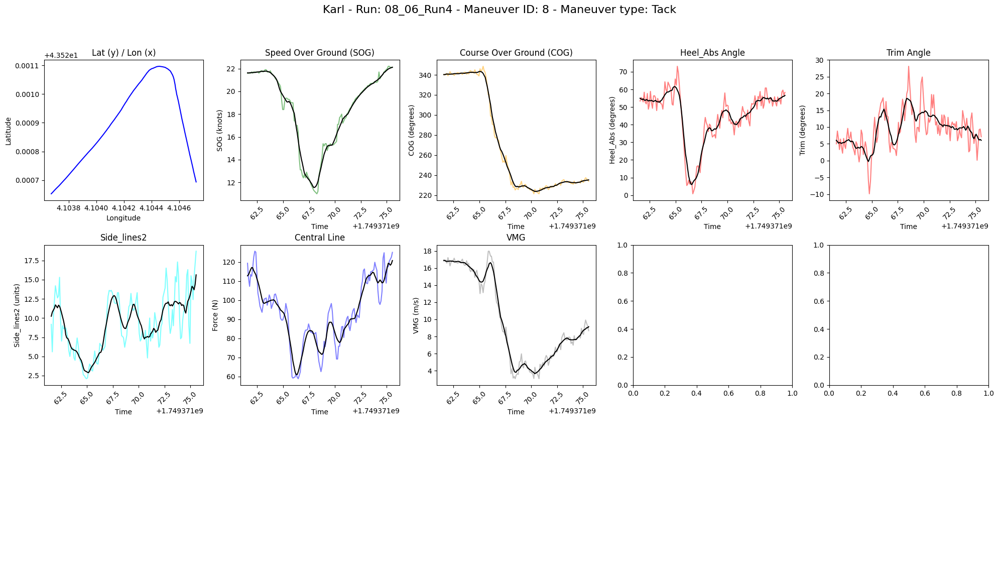


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-08 08:24:37.560000+00:00
  Maneuver Type: Tack
  Duration: 14.098000049591064 seconds
  Start Time: 1749371077.56
  End Time: 1749371091.658
  boat_name: Karl Maeder

avg TWS: 7.65 knots
avg TWA: -12.33 degrees
avg TWD: 298.40 degrees


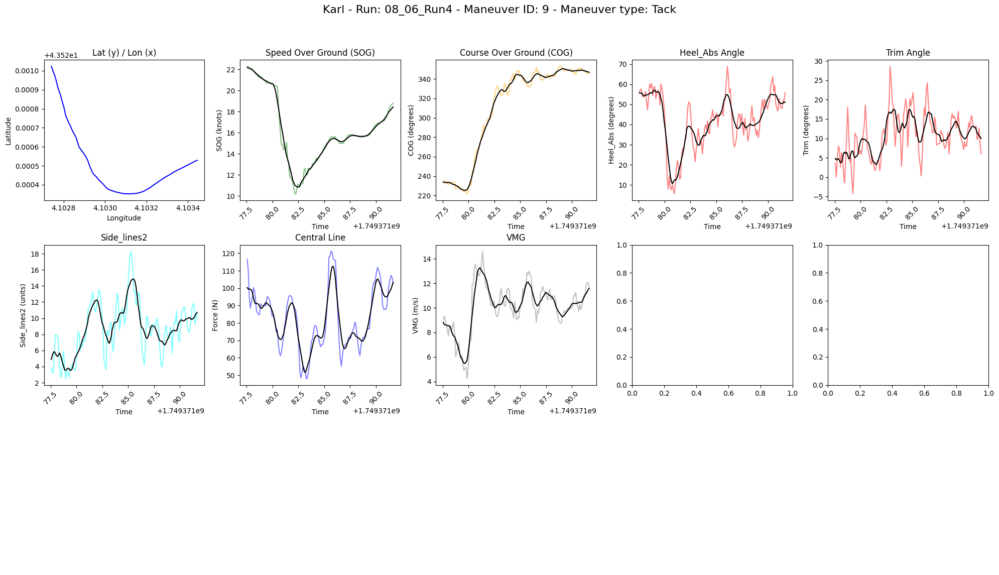


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-08 08:25:02.860000+00:00
  Maneuver Type: Tack
  Duration: 14.099000215530396 seconds
  Start Time: 1749371102.86
  End Time: 1749371116.959
  boat_name: Karl Maeder

avg TWS: 6.58 knots
avg TWA: 17.80 degrees
avg TWD: 291.85 degrees


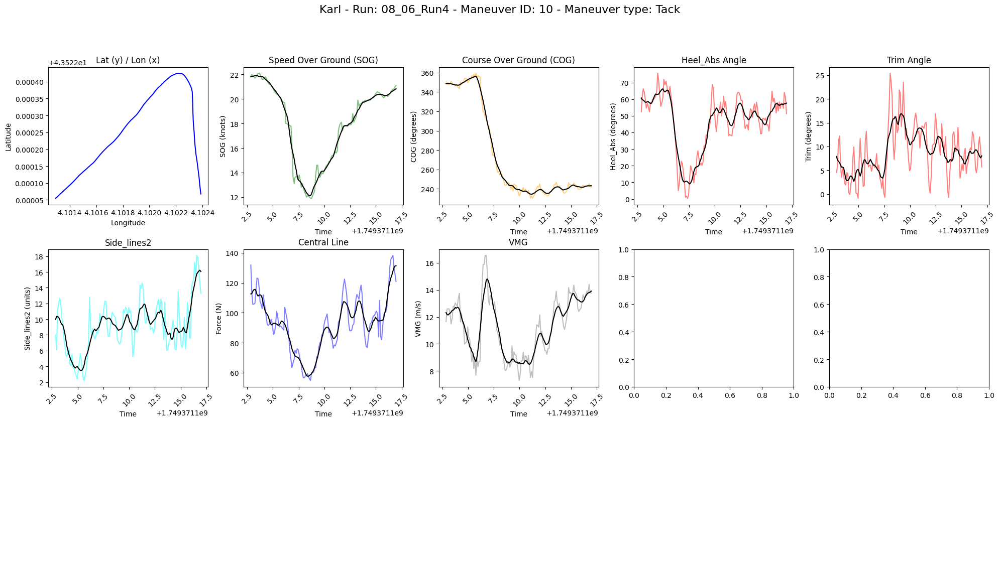


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-08 08:25:33.560000+00:00
  Maneuver Type: Jibe
  Duration: 13.999000072479248 seconds
  Start Time: 1749371133.56
  End Time: 1749371147.559
  boat_name: Karl Maeder

avg TWS: 8.27 knots
avg TWA: -73.02 degrees
avg TWD: 285.25 degrees


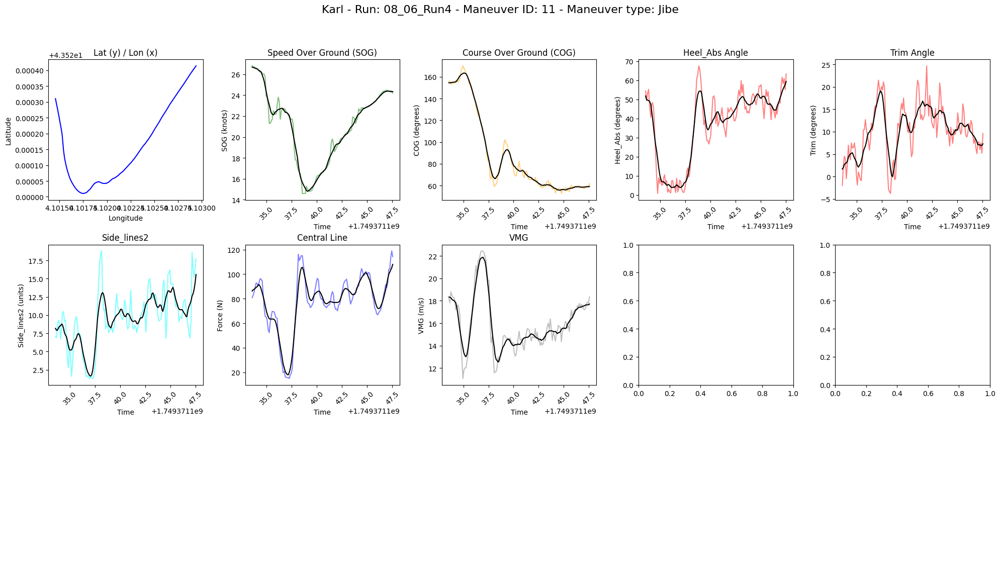


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-08 08:26:05.859000+00:00
  Maneuver Type: Jibe
  Duration: 13.999000072479248 seconds
  Start Time: 1749371165.859
  End Time: 1749371179.858
  boat_name: Karl Maeder

avg TWS: 7.40 knots
avg TWA: 46.28 degrees
avg TWD: 281.68 degrees


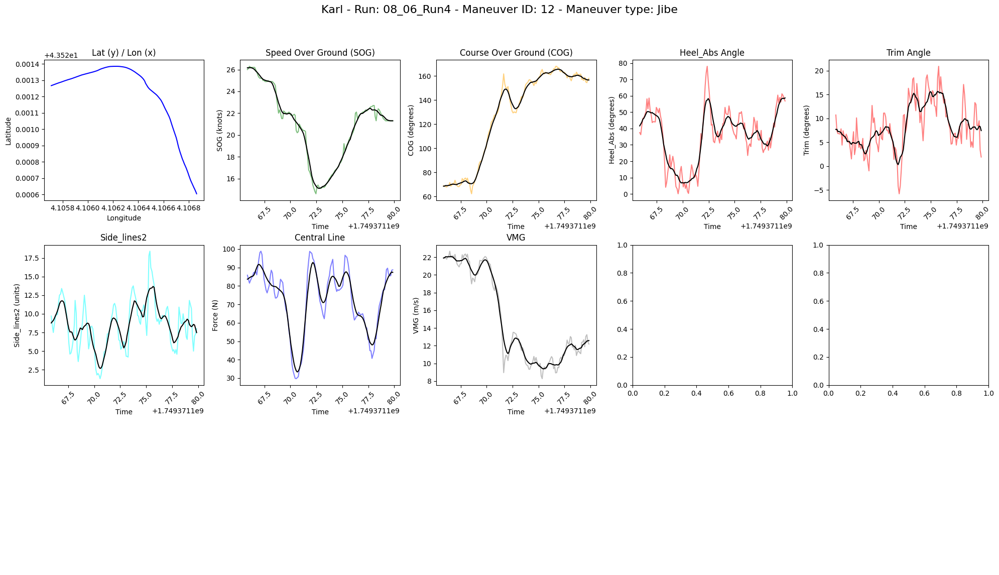

Summary for Karl - Run: 08_06_Run5

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-08 08:32:22.263000+00:00
  Maneuver Type: Tack
  Duration: 13.996999979019163 seconds
  Start Time: 1749371542.263
  End Time: 1749371556.26
  boat_name: Karl Maeder

avg TWS: 5.88 knots
avg TWA: -22.53 degrees
avg TWD: 288.40 degrees


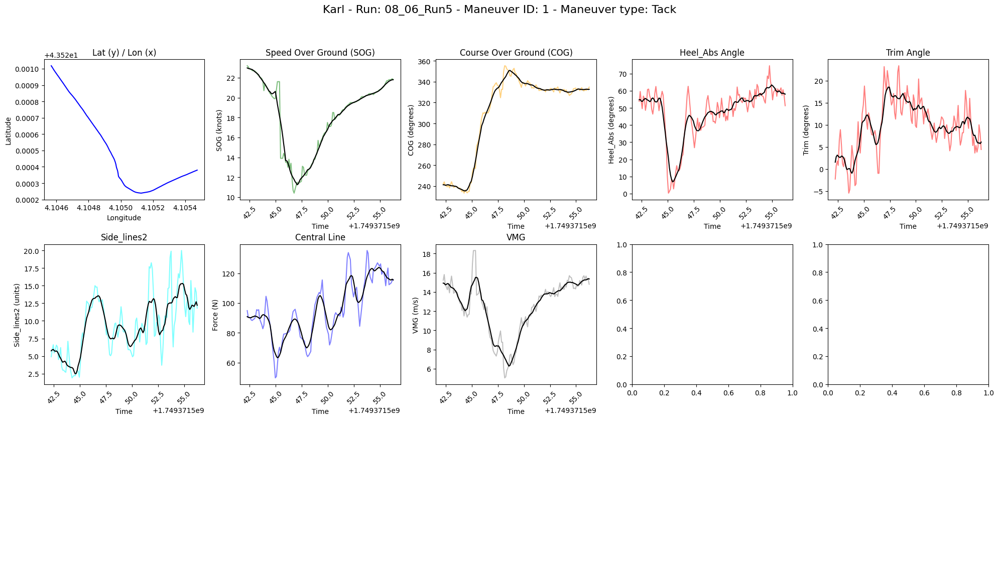


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-08 08:32:36.460000+00:00
  Maneuver Type: Tack
  Duration: 14.09599995613098 seconds
  Start Time: 1749371556.46
  End Time: 1749371570.556
  boat_name: Karl Maeder

avg TWS: 7.20 knots
avg TWA: 19.15 degrees
avg TWD: 289.45 degrees


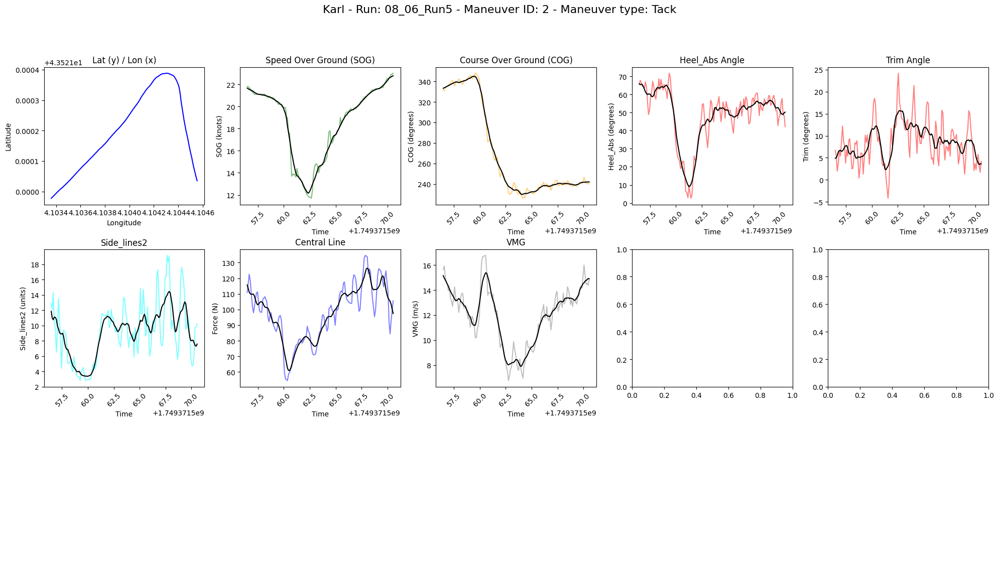


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-08 08:32:51.157000+00:00
  Maneuver Type: Tack
  Duration: 13.99399995803833 seconds
  Start Time: 1749371571.157
  End Time: 1749371585.151
  boat_name: Karl Maeder

avg TWS: 8.38 knots
avg TWA: -27.30 degrees
avg TWD: 288.66 degrees


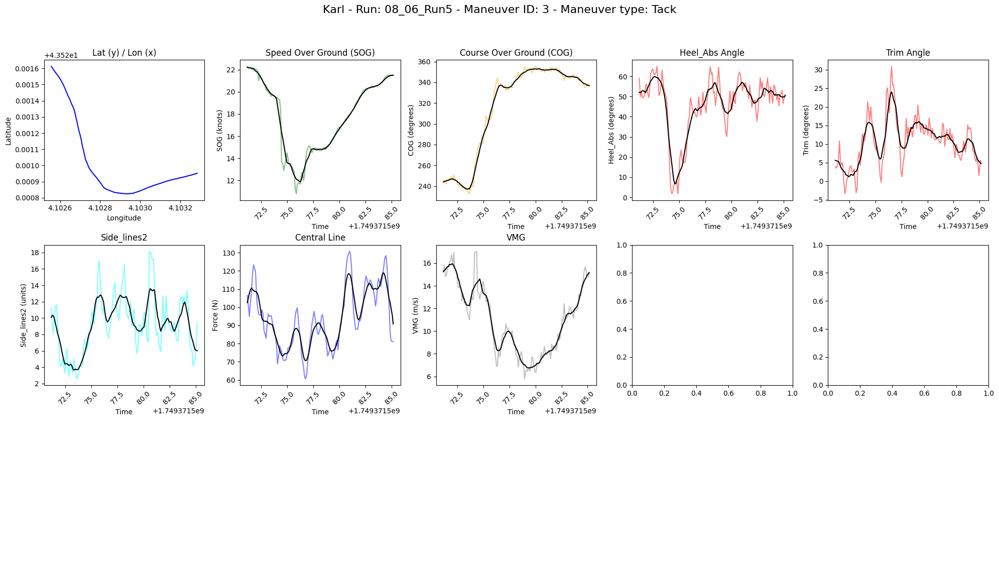


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-08 08:33:08.858000+00:00
  Maneuver Type: Tack
  Duration: 14.1010000705719 seconds
  Start Time: 1749371588.858
  End Time: 1749371602.959
  boat_name: Karl Maeder

avg TWS: 8.02 knots
avg TWA: 17.59 degrees
avg TWD: 296.97 degrees


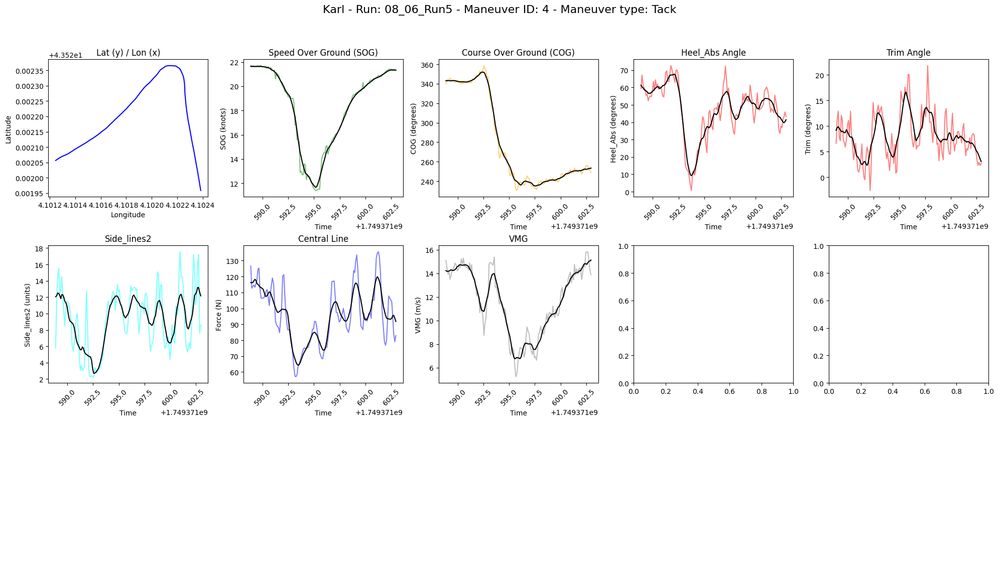


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-08 08:33:35.757000+00:00
  Maneuver Type: Jibe
  Duration: 13.999000072479248 seconds
  Start Time: 1749371615.757
  End Time: 1749371629.756
  boat_name: Karl Maeder

avg TWS: 7.01 knots
avg TWA: -59.64 degrees
avg TWD: 294.53 degrees


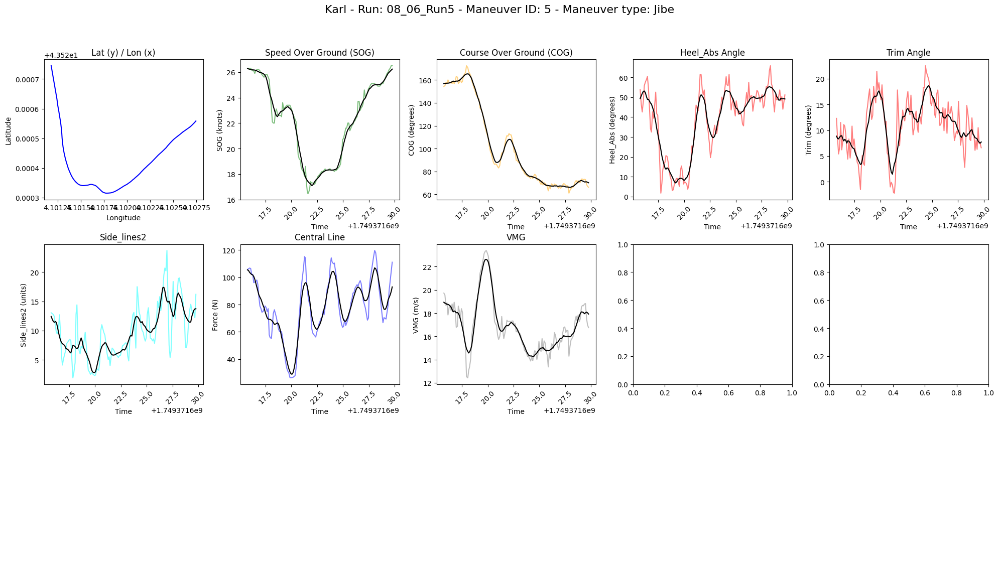


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-08 08:34:46.956000+00:00
  Maneuver Type: Tack
  Duration: 14.003000020980837 seconds
  Start Time: 1749371686.956
  End Time: 1749371700.959
  boat_name: Karl Maeder

avg TWS: 8.46 knots
avg TWA: -24.56 degrees
avg TWD: 292.36 degrees


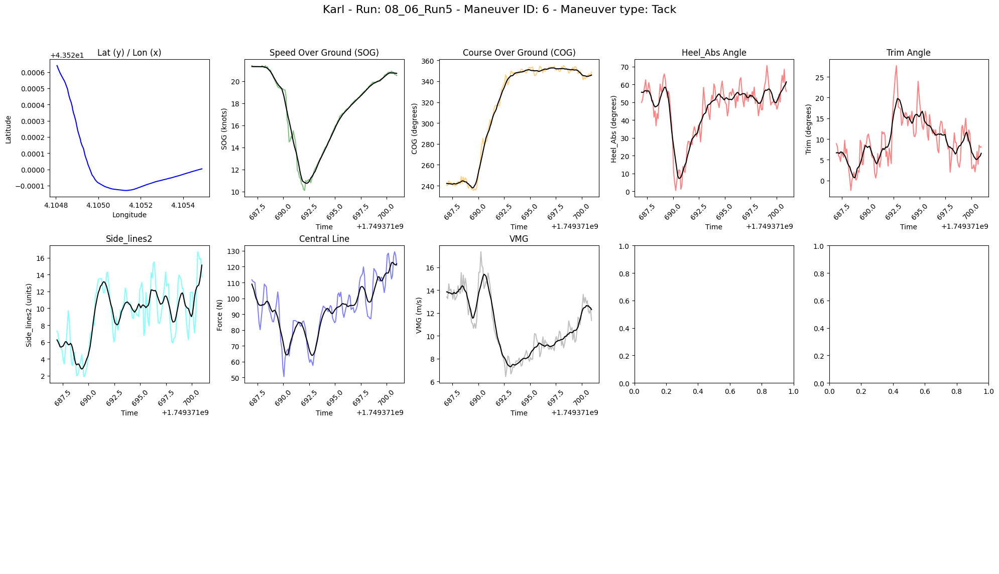


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-08 08:35:02.860000+00:00
  Maneuver Type: Tack
  Duration: 13.999000072479248 seconds
  Start Time: 1749371702.86
  End Time: 1749371716.859
  boat_name: Karl Maeder

avg TWS: 8.25 knots
avg TWA: 11.79 degrees
avg TWD: 294.69 degrees


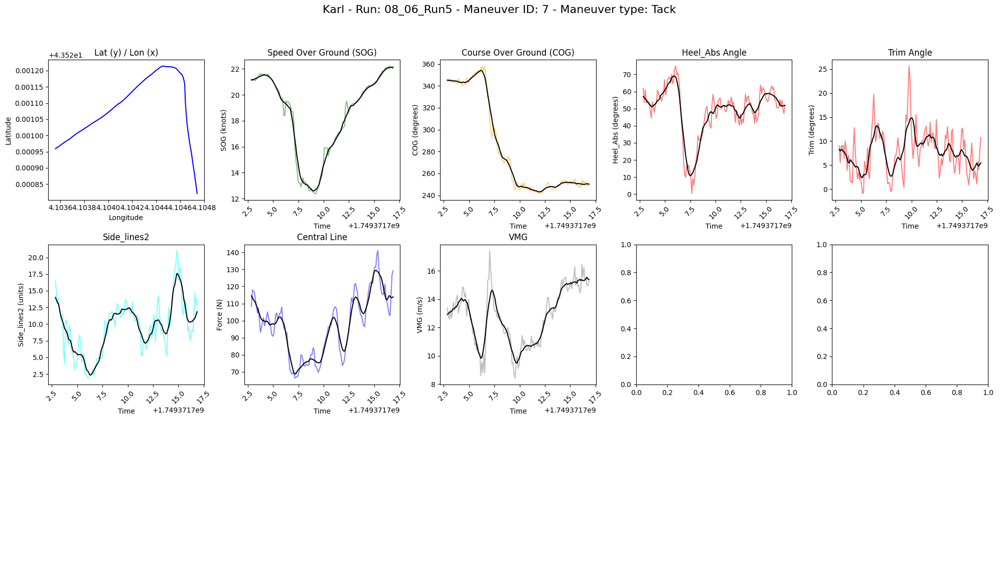


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-08 08:35:17.858000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749371717.858
  End Time: 1749371731.858
  boat_name: Karl Maeder

avg TWS: 8.00 knots
avg TWA: -27.47 degrees
avg TWD: 296.78 degrees


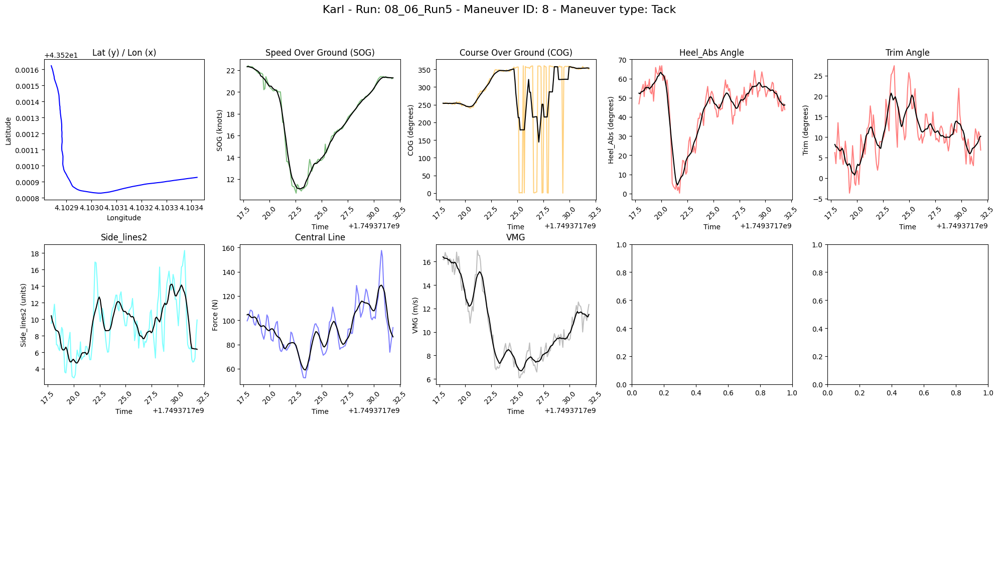


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-08 08:35:35.556000+00:00
  Maneuver Type: Tack
  Duration: 13.903000116348268 seconds
  Start Time: 1749371735.556
  End Time: 1749371749.459
  boat_name: Karl Maeder

avg TWS: 7.73 knots
avg TWA: 34.20 degrees
avg TWD: 295.38 degrees


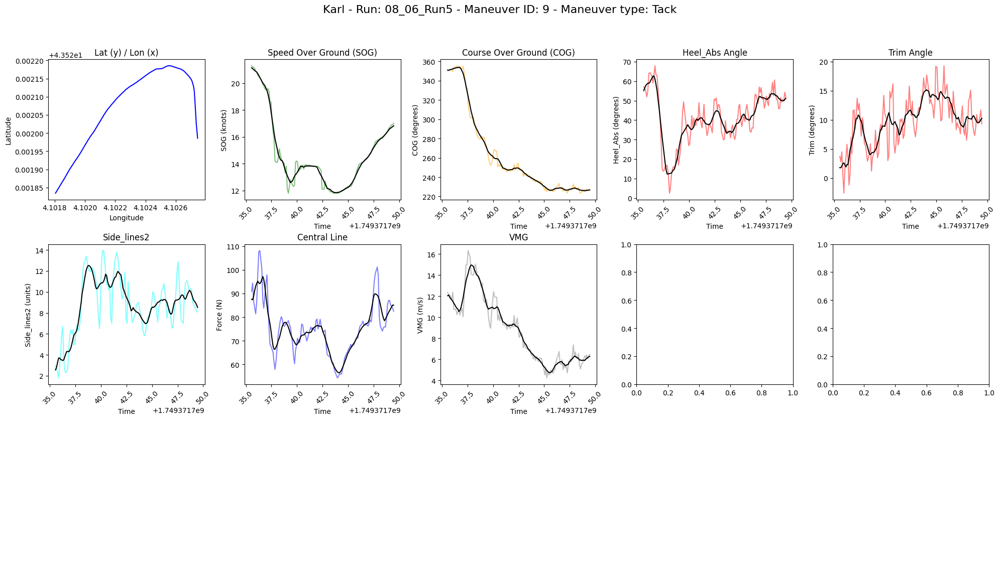


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-08 08:36:24.558000+00:00
  Maneuver Type: Jibe
  Duration: 13.997999906539915 seconds
  Start Time: 1749371784.558
  End Time: 1749371798.556
  boat_name: Karl Maeder

avg TWS: 6.97 knots
avg TWA: -68.43 degrees
avg TWD: 309.05 degrees


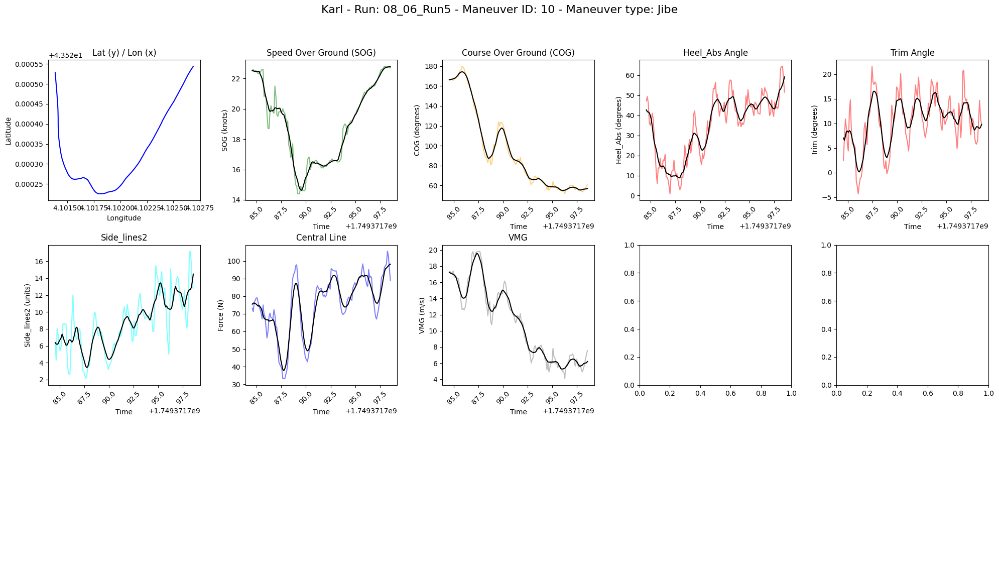


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-08 08:36:57.756000+00:00
  Maneuver Type: Jibe
  Duration: 14.003000020980837 seconds
  Start Time: 1749371817.756
  End Time: 1749371831.759
  boat_name: Karl Maeder

avg TWS: 7.84 knots
avg TWA: 68.31 degrees
avg TWD: 302.72 degrees


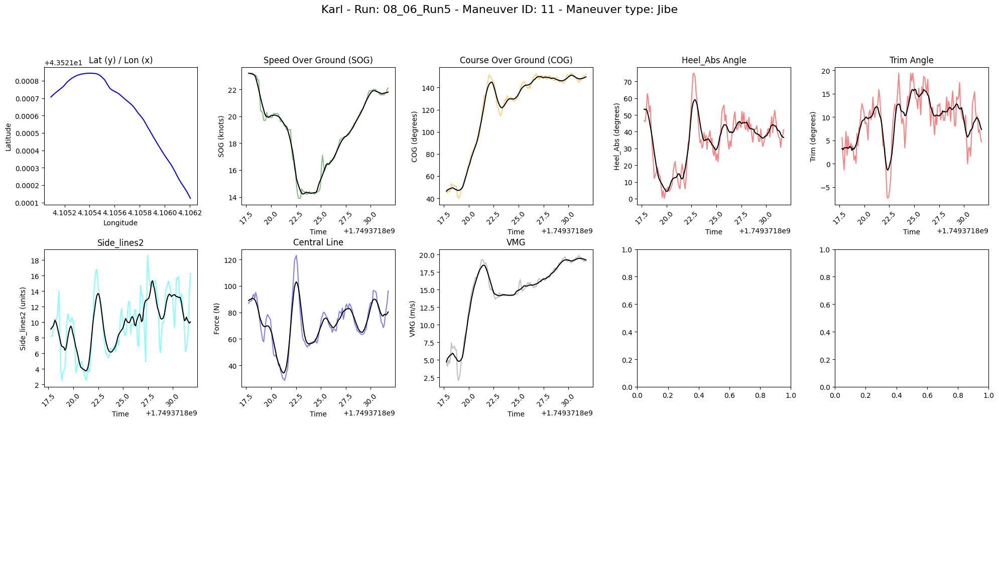


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-08 08:37:16.756000+00:00
  Maneuver Type: buoy
  Duration: 14.000999927520752 seconds
  Start Time: 1749371836.756
  End Time: 1749371850.757
  boat_name: Karl Maeder

avg TWS: 5.88 knots
avg TWA: 85.10 degrees
avg TWD: 301.65 degrees


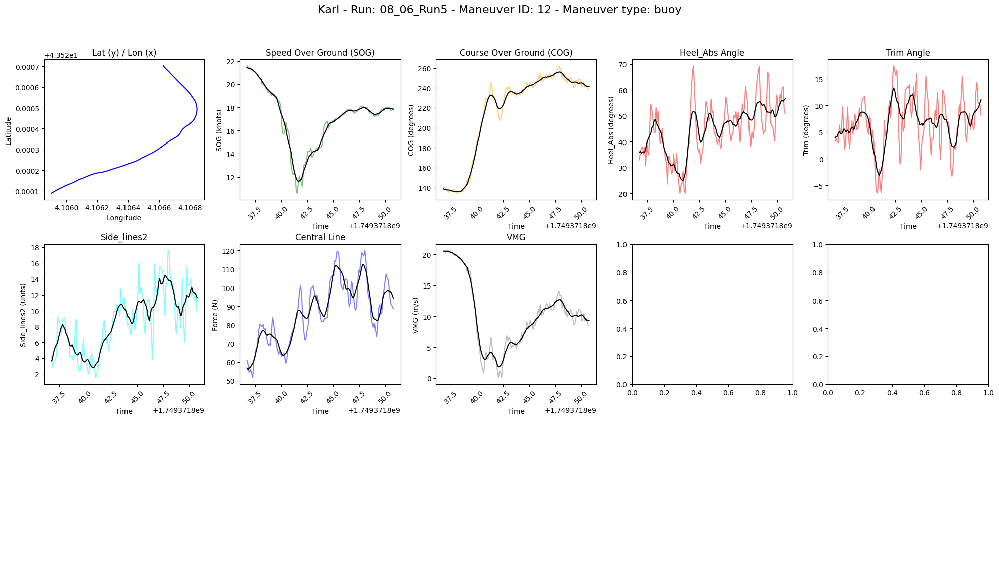

Summary for Karl - Run: 08_06_Run6

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-08 08:44:10.259000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749372250.259
  End Time: 1749372264.259
  boat_name: Karl Maeder

avg TWS: 6.61 knots
avg TWA: -14.83 degrees
avg TWD: 293.57 degrees


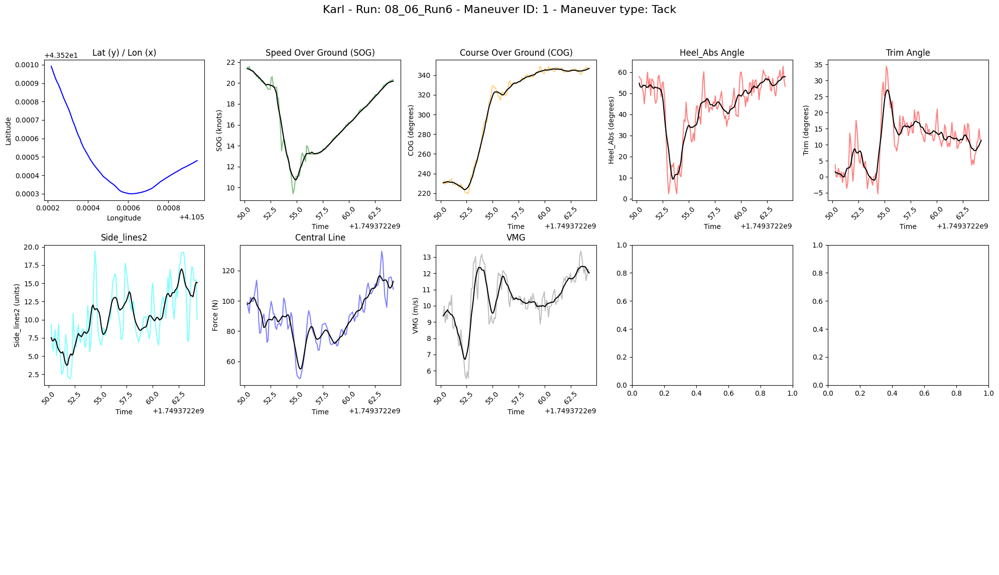


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-08 08:44:27.956000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749372267.956
  End Time: 1749372281.956
  boat_name: Karl Maeder

avg TWS: 8.18 knots
avg TWA: 35.99 degrees
avg TWD: 300.03 degrees


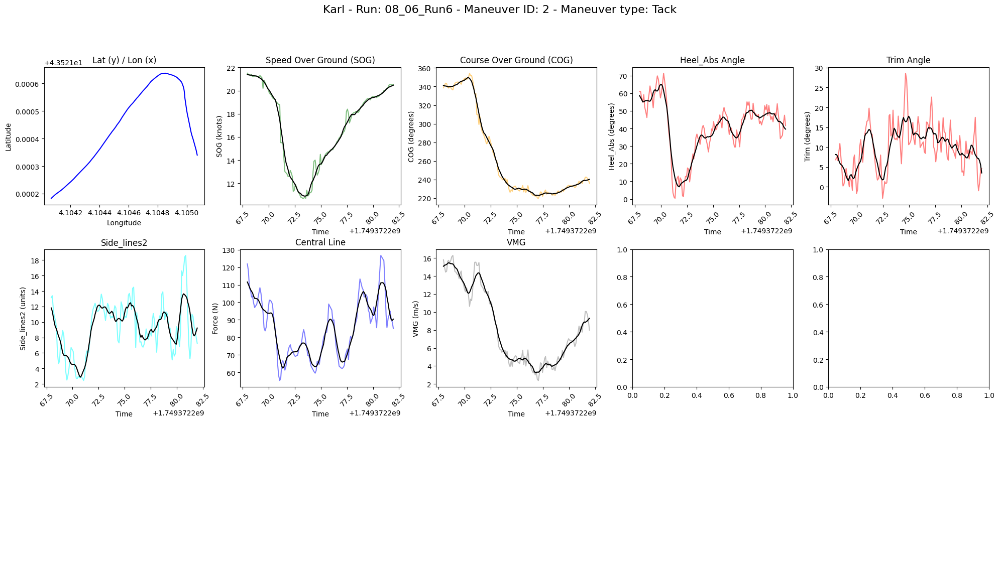


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-08 08:44:46.456000+00:00
  Maneuver Type: Tack
  Duration: 14.098999977111816 seconds
  Start Time: 1749372286.456
  End Time: 1749372300.555
  boat_name: Karl Maeder

avg TWS: 7.69 knots
avg TWA: -13.93 degrees
avg TWD: 306.06 degrees


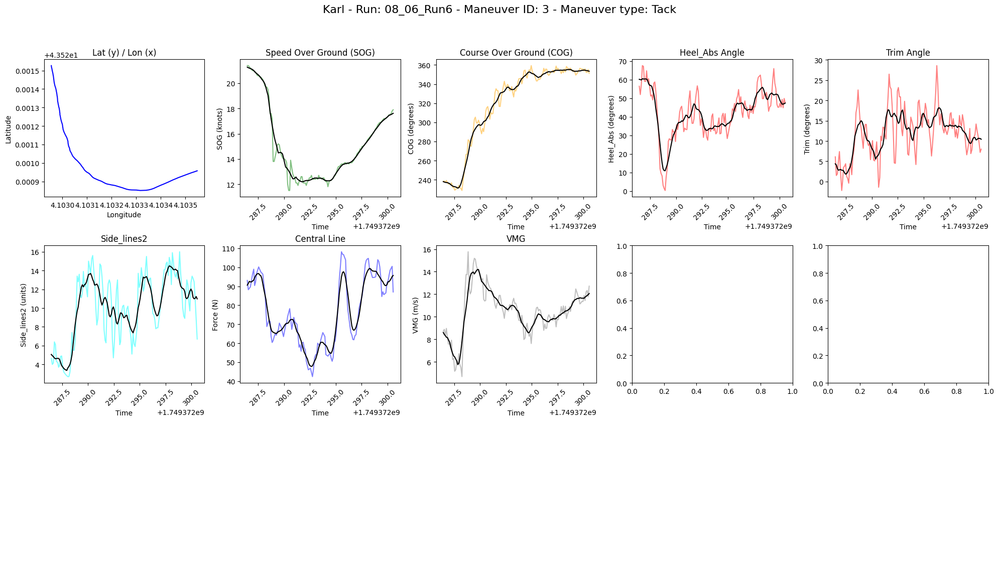


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-08 08:45:07.064000+00:00
  Maneuver Type: Tack
  Duration: 14.093000173568726 seconds
  Start Time: 1749372307.064
  End Time: 1749372321.157
  boat_name: Karl Maeder

avg TWS: 5.93 knots
avg TWA: 25.75 degrees
avg TWD: 298.86 degrees


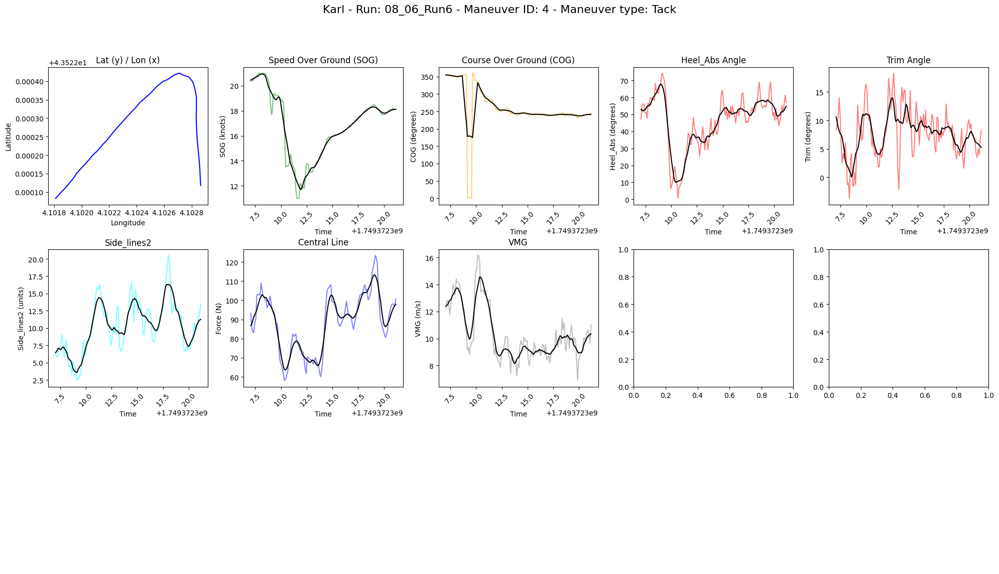


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-08 08:45:49.657000+00:00
  Maneuver Type: Jibe
  Duration: 14.098999977111816 seconds
  Start Time: 1749372349.657
  End Time: 1749372363.756
  boat_name: Karl Maeder

avg TWS: 8.22 knots
avg TWA: -62.55 degrees
avg TWD: 287.55 degrees


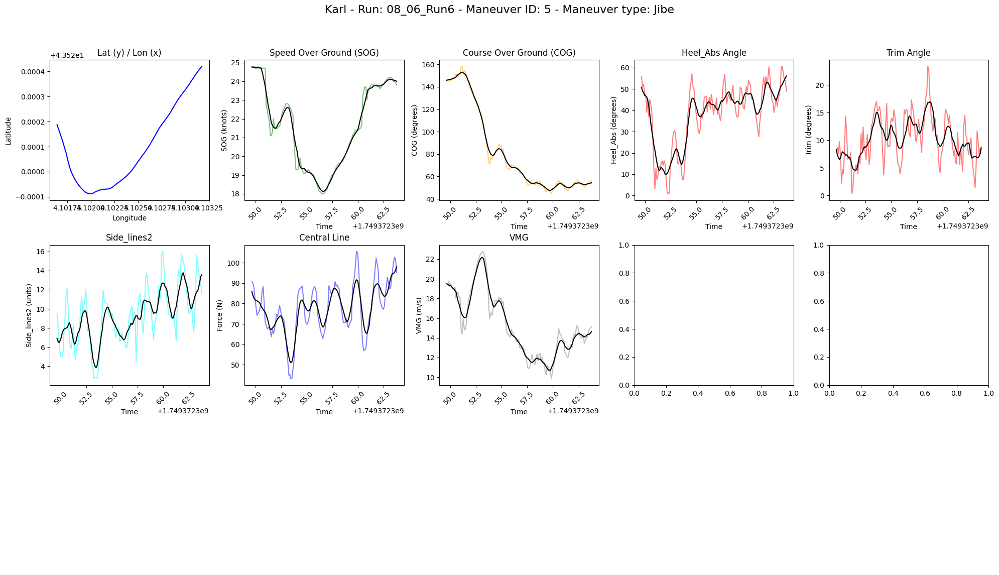


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-08 08:47:02.164000+00:00
  Maneuver Type: Tack
  Duration: 13.99399995803833 seconds
  Start Time: 1749372422.164
  End Time: 1749372436.158
  boat_name: Karl Maeder

avg TWS: 7.07 knots
avg TWA: -22.81 degrees
avg TWD: 280.94 degrees


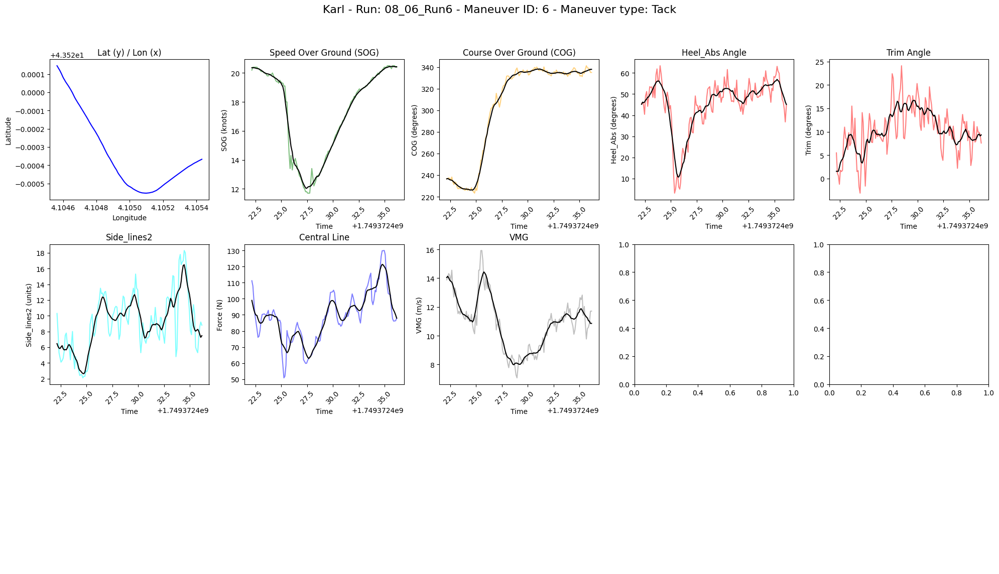


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-08 08:47:19.559000+00:00
  Maneuver Type: Tack
  Duration: 14.098000049591064 seconds
  Start Time: 1749372439.559
  End Time: 1749372453.657
  boat_name: Karl Maeder

avg TWS: 7.14 knots
avg TWA: 18.43 degrees
avg TWD: 280.07 degrees


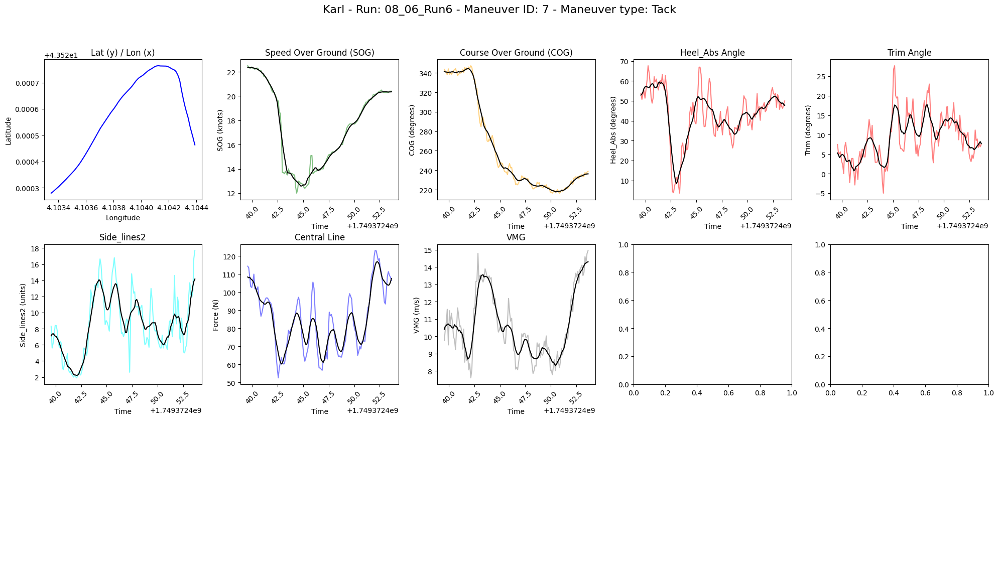


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-08 08:47:36.459000+00:00
  Maneuver Type: Tack
  Duration: 14.096999883651732 seconds
  Start Time: 1749372456.459
  End Time: 1749372470.556
  boat_name: Karl Maeder

avg TWS: 6.73 knots
avg TWA: -24.73 degrees
avg TWD: 286.75 degrees


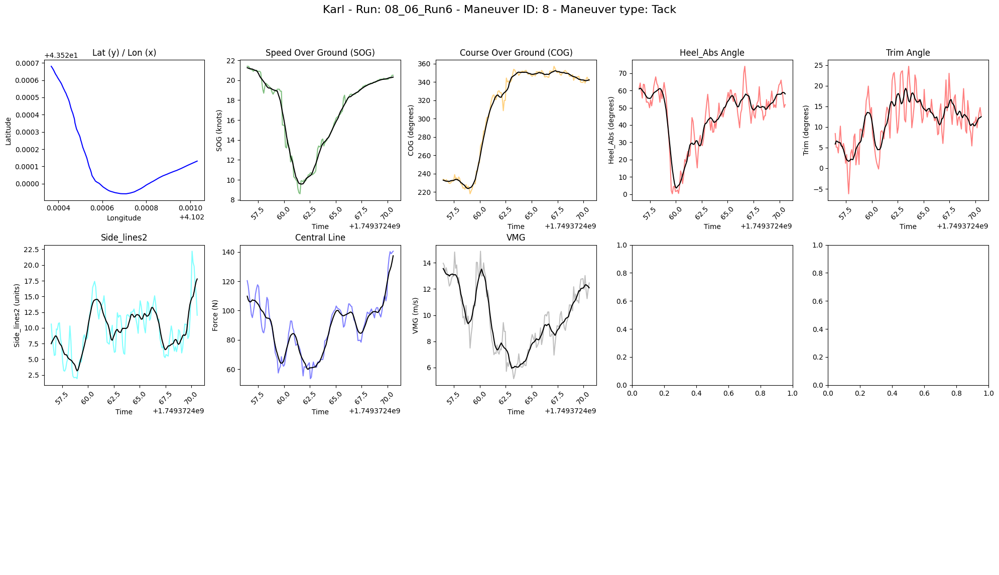


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-08 08:48:03.157000+00:00
  Maneuver Type: buoy
  Duration: 14.003999948501589 seconds
  Start Time: 1749372483.157
  End Time: 1749372497.161
  boat_name: Karl Maeder

avg TWS: 5.76 knots
avg TWA: 18.36 degrees
avg TWD: 281.25 degrees


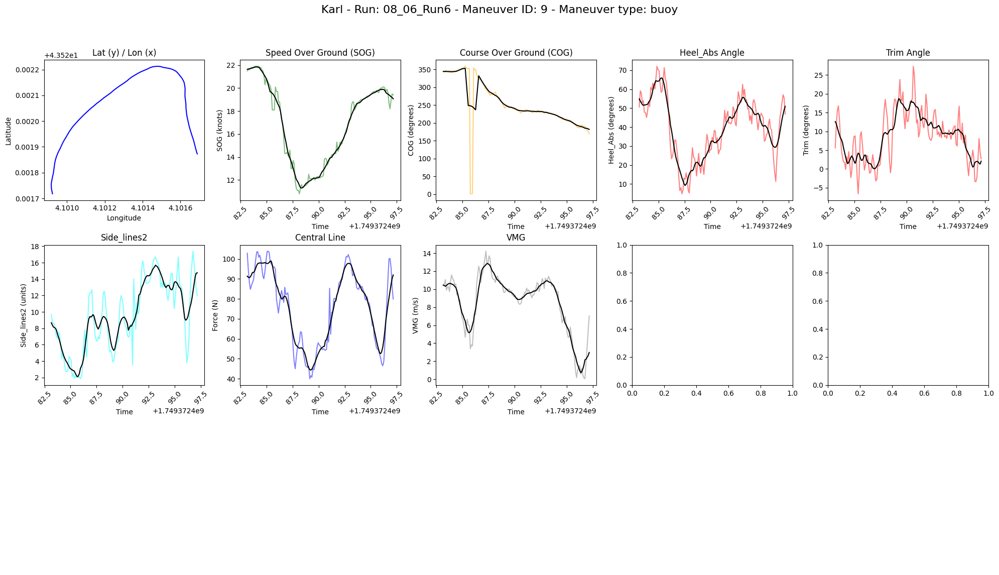


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-08 08:48:31.053000+00:00
  Maneuver Type: Jibe
  Duration: 14.104000091552734 seconds
  Start Time: 1749372511.053
  End Time: 1749372525.157
  boat_name: Karl Maeder

avg TWS: 5.97 knots
avg TWA: -55.18 degrees
avg TWD: 290.65 degrees


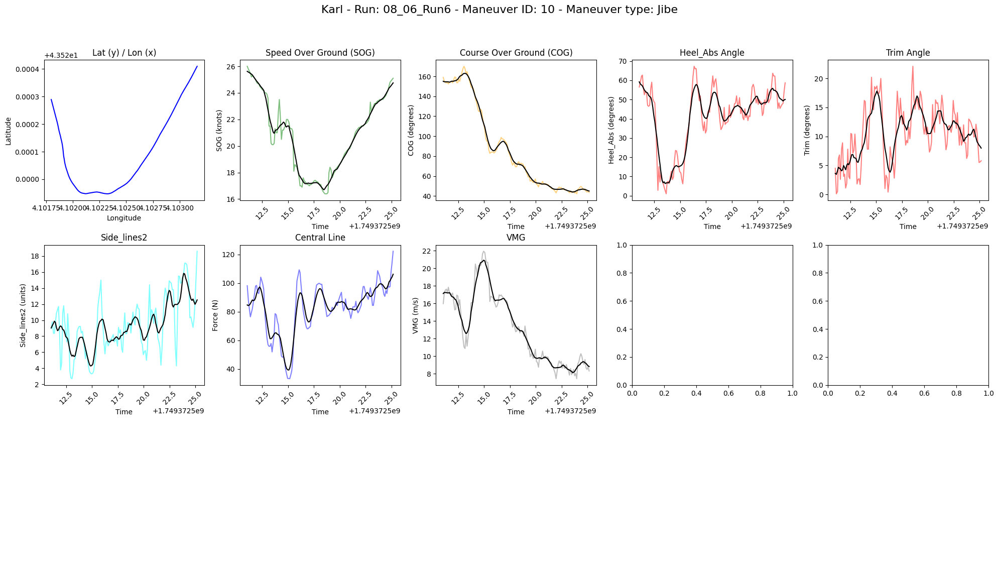


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-08 08:49:03.262000+00:00
  Maneuver Type: Jibe
  Duration: 14.001999855041504 seconds
  Start Time: 1749372543.262
  End Time: 1749372557.264
  boat_name: Karl Maeder

avg TWS: 5.19 knots
avg TWA: 57.15 degrees
avg TWD: 298.22 degrees


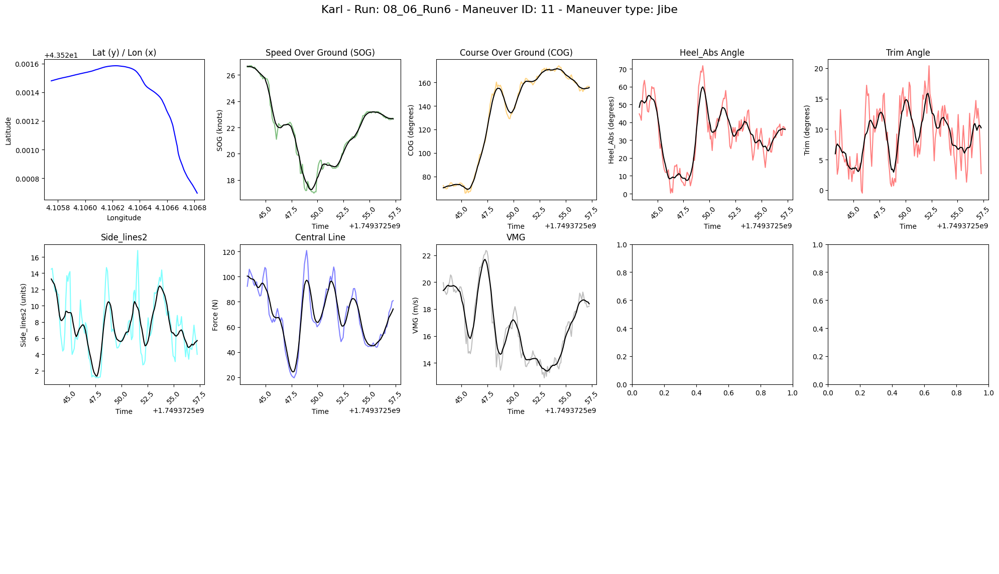

Summary for Karl - Run: 11_06_Run1

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-11 12:24:52.759000+00:00
  Maneuver Type: Tack
  Duration: 14.000999927520752 seconds
  Start Time: 1749644692.759
  End Time: 1749644706.76
  boat_name: Karl Maeder

avg TWS: 5.43 knots
avg TWA: -22.59 degrees
avg TWD: 194.24 degrees


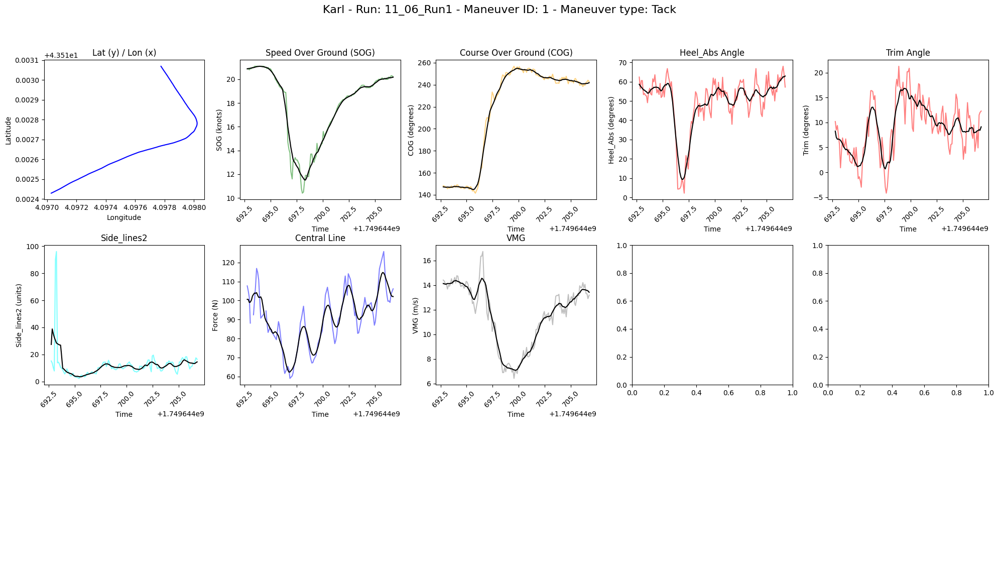


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-11 12:25:14.560000+00:00
  Maneuver Type: Tack
  Duration: 13.998000144958496 seconds
  Start Time: 1749644714.56
  End Time: 1749644728.558
  boat_name: Karl Maeder

avg TWS: 5.25 knots
avg TWA: 19.59 degrees
avg TWD: 193.38 degrees


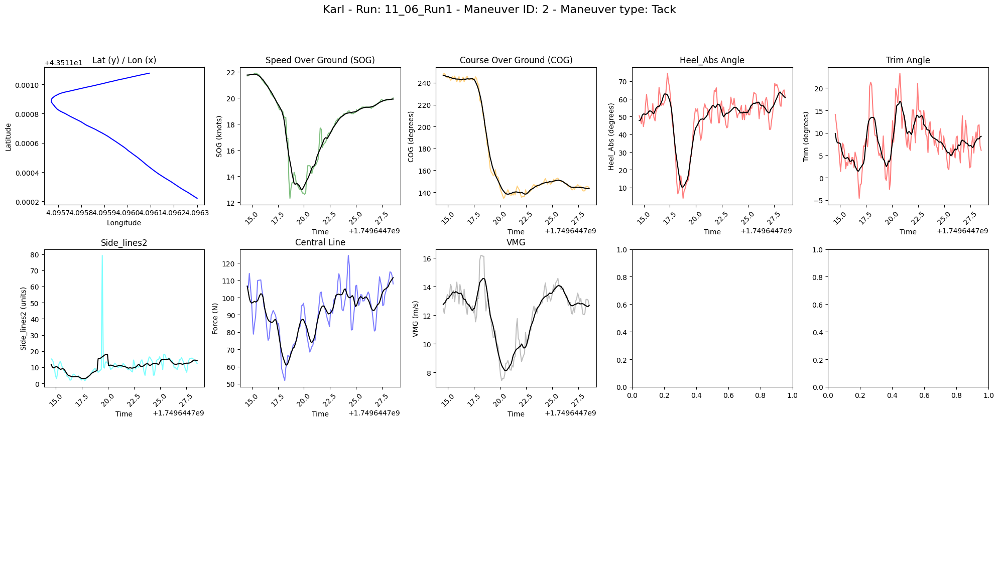


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-11 12:25:31.360000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749644731.36
  End Time: 1749644745.36
  boat_name: Karl Maeder

avg TWS: 6.14 knots
avg TWA: -23.85 degrees
avg TWD: 193.57 degrees


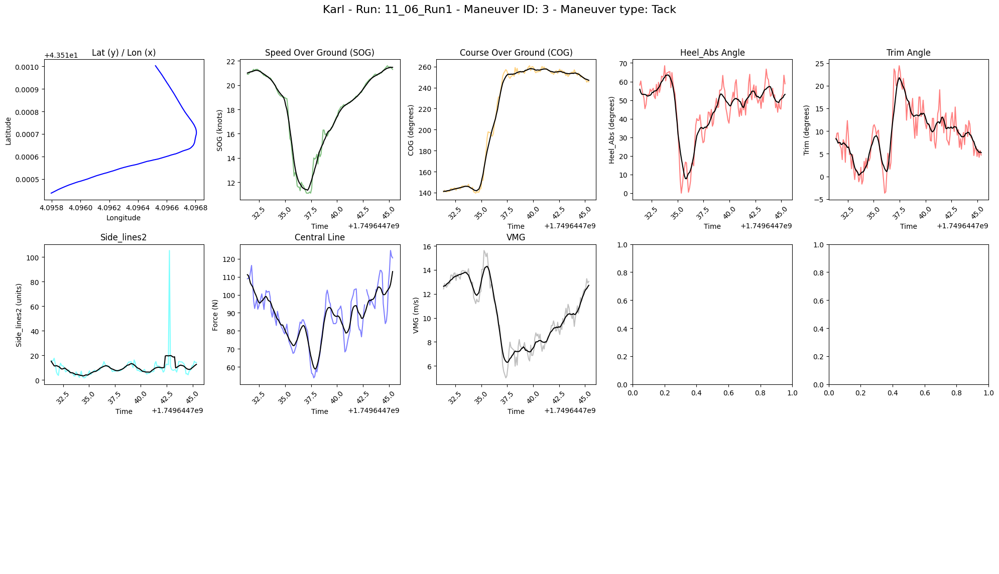


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-11 12:25:59.657000+00:00
  Maneuver Type: Tack
  Duration: 14.101999998092651 seconds
  Start Time: 1749644759.657
  End Time: 1749644773.759
  boat_name: Karl Maeder

avg TWS: 5.55 knots
avg TWA: 26.57 degrees
avg TWD: 194.20 degrees


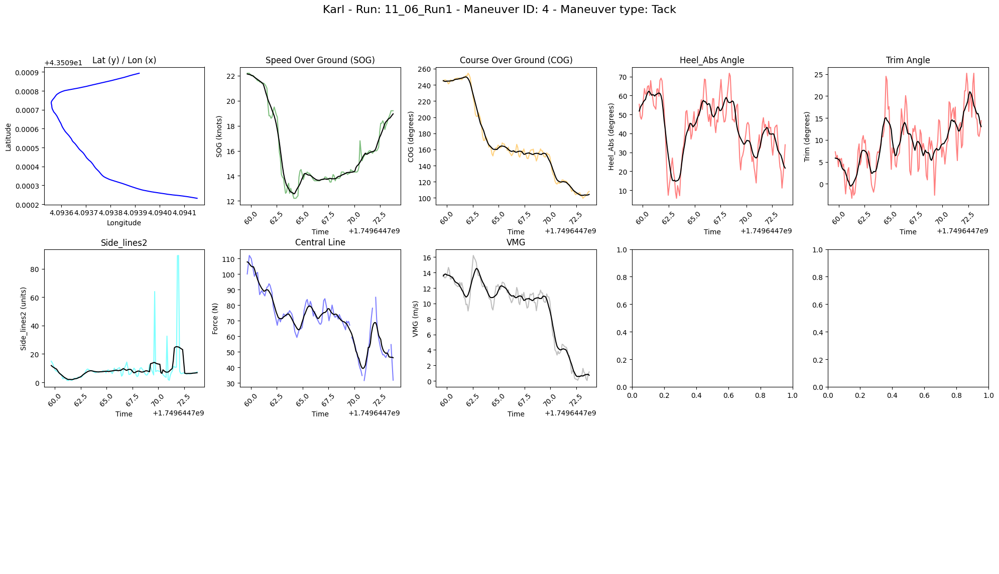


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-11 12:26:22.959000+00:00
  Maneuver Type: Jibe
  Duration: 13.997999906539915 seconds
  Start Time: 1749644782.959
  End Time: 1749644796.957
  boat_name: Karl Maeder

avg TWS: 5.23 knots
avg TWA: -76.06 degrees
avg TWD: 192.85 degrees


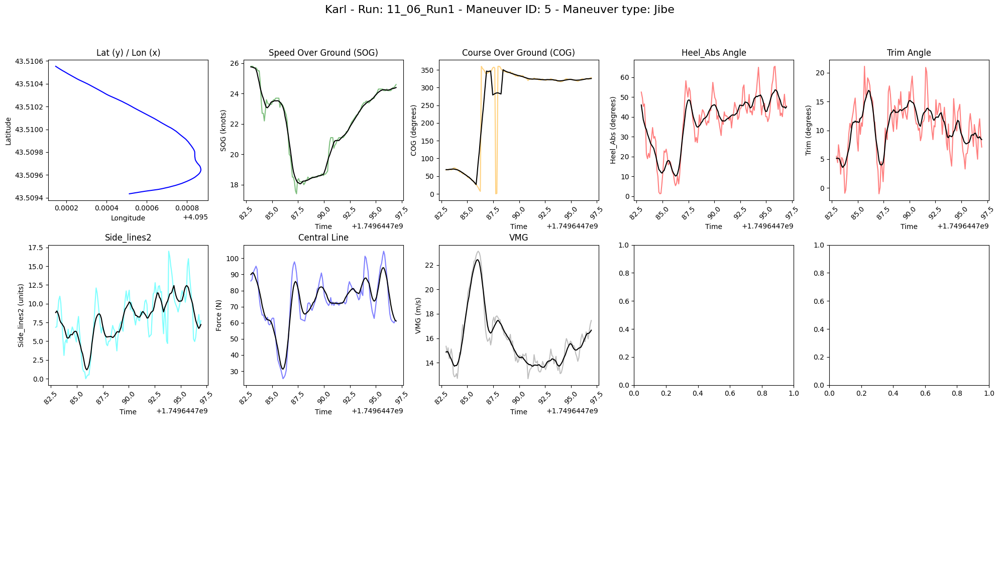


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-11 12:26:54.956000+00:00
  Maneuver Type: Jibe
  Duration: 14.003000020980837 seconds
  Start Time: 1749644814.956
  End Time: 1749644828.959
  boat_name: Karl Maeder

avg TWS: 4.92 knots
avg TWA: 37.63 degrees
avg TWD: 189.47 degrees


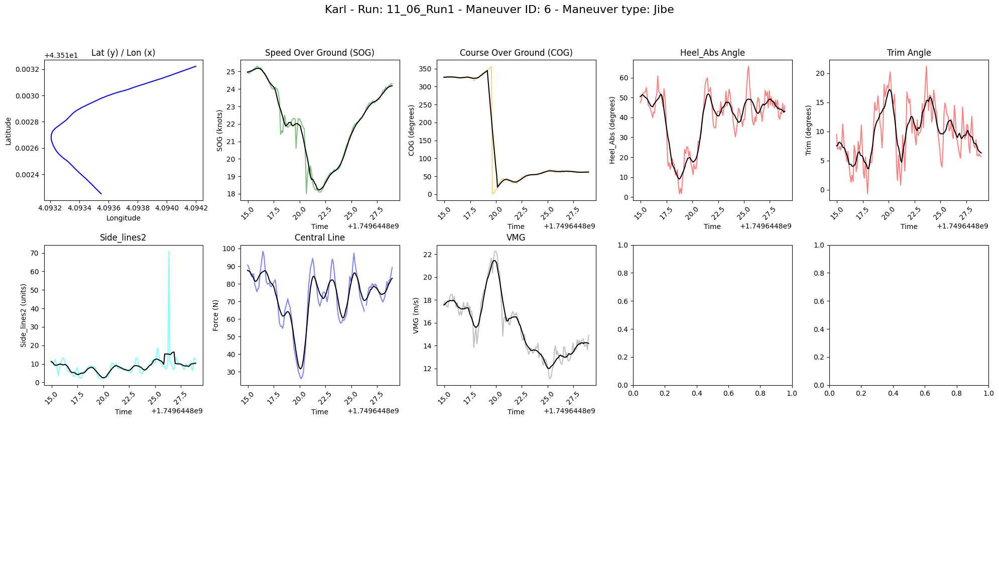


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-11 12:27:25.559000+00:00
  Maneuver Type: buoy
  Duration: 14.0 seconds
  Start Time: 1749644845.559
  End Time: 1749644859.559
  boat_name: Karl Maeder

avg TWS: 5.20 knots
avg TWA: 55.94 degrees
avg TWD: 189.85 degrees


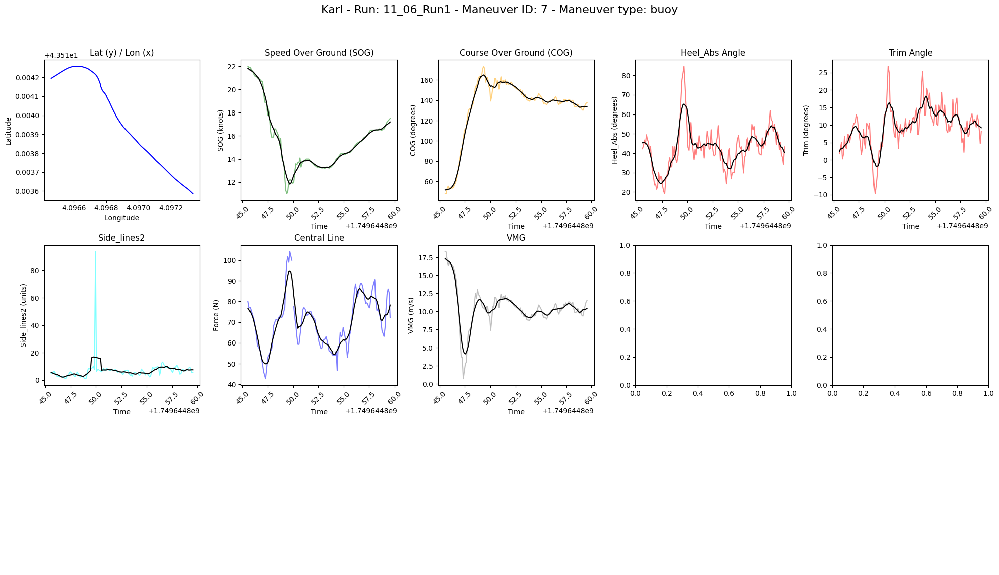


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-11 12:27:43.759000+00:00
  Maneuver Type: Tack
  Duration: 14.098000049591064 seconds
  Start Time: 1749644863.759
  End Time: 1749644877.857
  boat_name: Karl Maeder

avg TWS: 6.08 knots
avg TWA: -25.08 degrees
avg TWD: 184.59 degrees


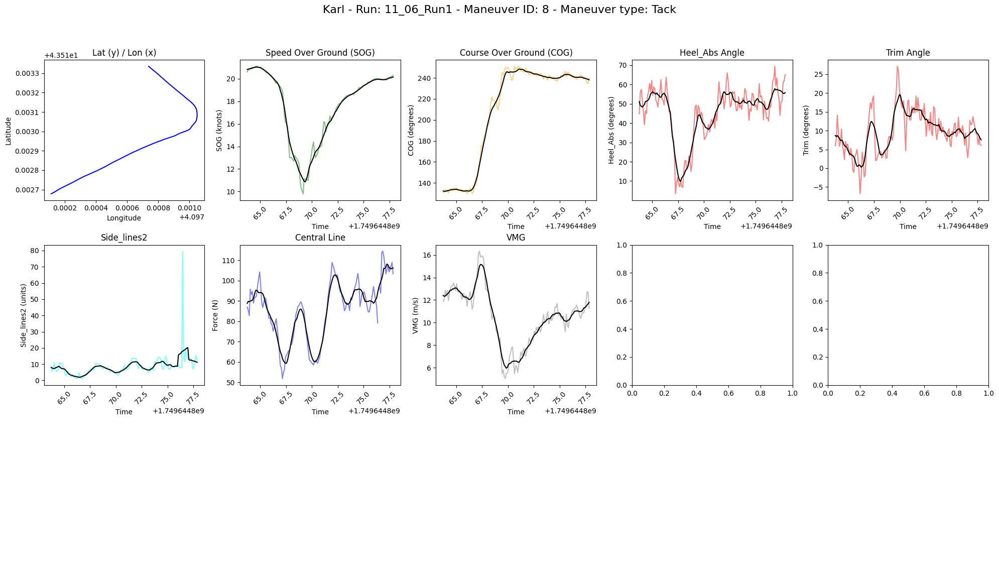


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-11 12:28:02.161000+00:00
  Maneuver Type: Tack
  Duration: 14.09500002861023 seconds
  Start Time: 1749644882.161
  End Time: 1749644896.256
  boat_name: Karl Maeder

avg TWS: 5.85 knots
avg TWA: 20.85 degrees
avg TWD: 184.37 degrees


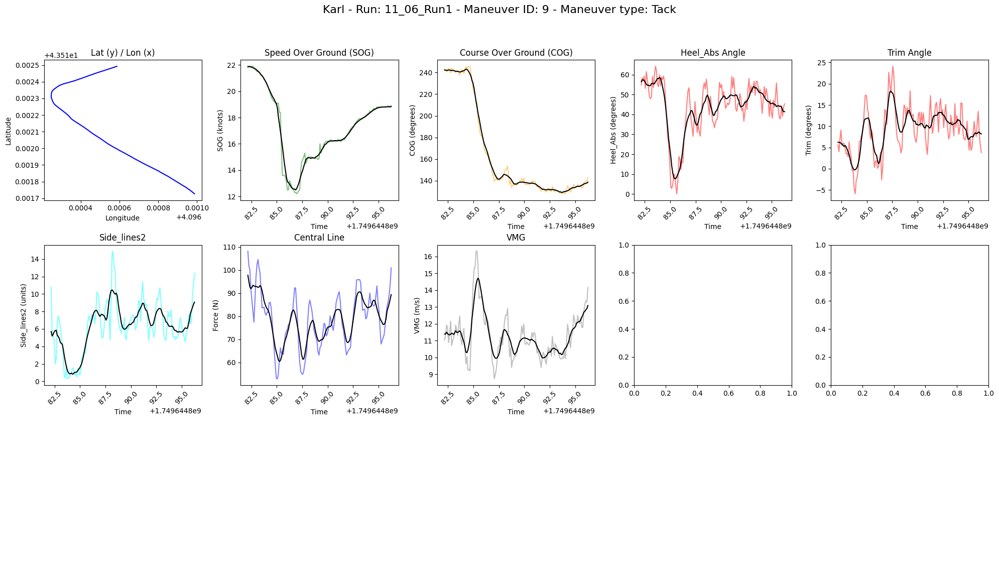


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-11 12:28:21.856000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749644901.856
  End Time: 1749644915.856
  boat_name: Karl Maeder

avg TWS: 6.32 knots
avg TWA: -27.39 degrees
avg TWD: 187.67 degrees


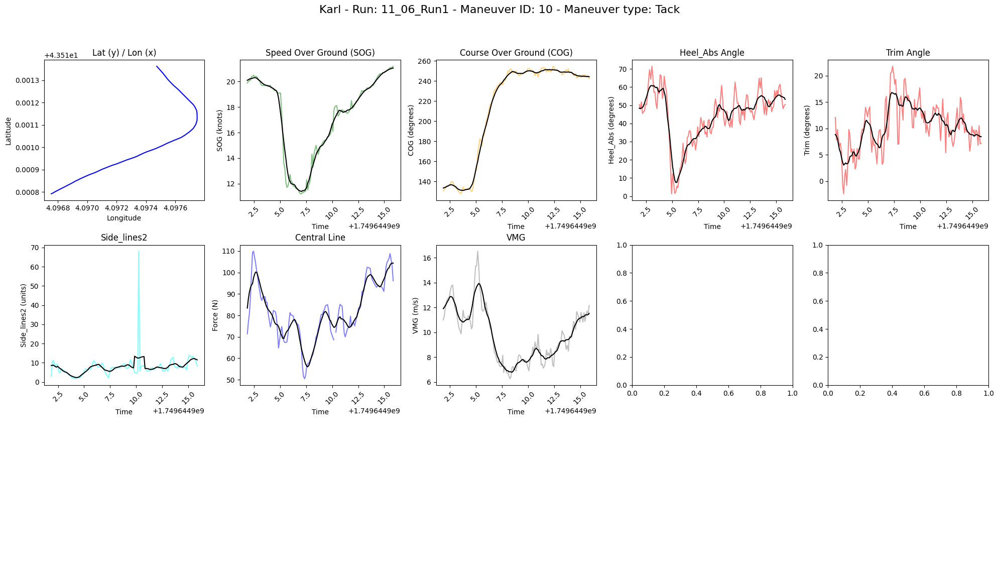


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-11 12:29:31.559000+00:00
  Maneuver Type: Jibe
  Duration: 14.096999883651732 seconds
  Start Time: 1749644971.559
  End Time: 1749644985.656
  boat_name: Karl Maeder

avg TWS: 5.80 knots
avg TWA: -80.40 degrees
avg TWD: 191.54 degrees


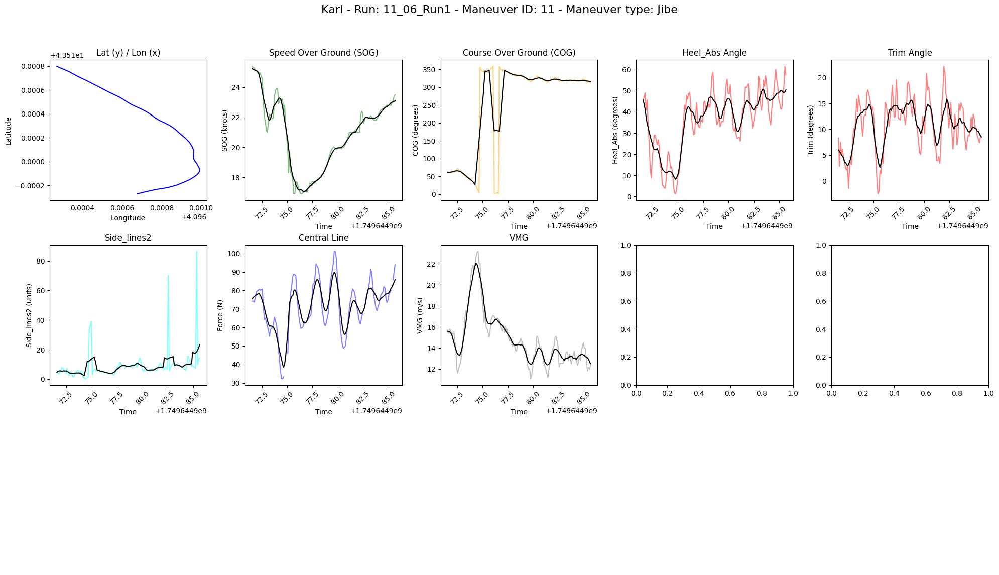


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-11 12:30:04.855000+00:00
  Maneuver Type: Jibe
  Duration: 14.092999935150146 seconds
  Start Time: 1749645004.855
  End Time: 1749645018.948
  boat_name: Karl Maeder

avg TWS: 5.62 knots
avg TWA: 65.08 degrees
avg TWD: 194.39 degrees


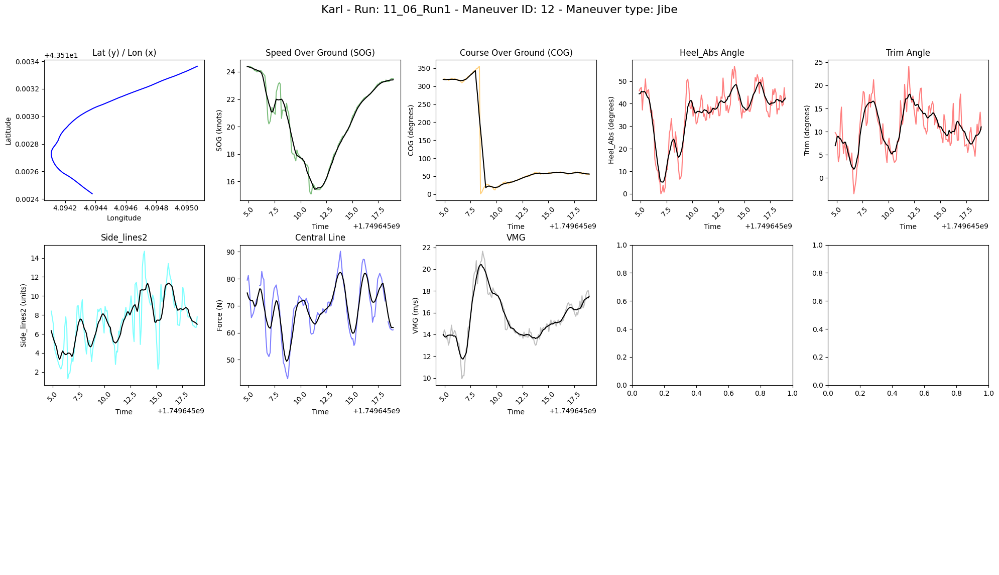

Summary for Karl - Run: 11_06_Run2

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-11 12:36:20.747000+00:00
  Maneuver Type: Jibe
  Duration: 13.910000085830688 seconds
  Start Time: 1749645380.747
  End Time: 1749645394.657
  boat_name: Karl Maeder

avg TWS: 5.97 knots
avg TWA: 85.50 degrees
avg TWD: 183.57 degrees


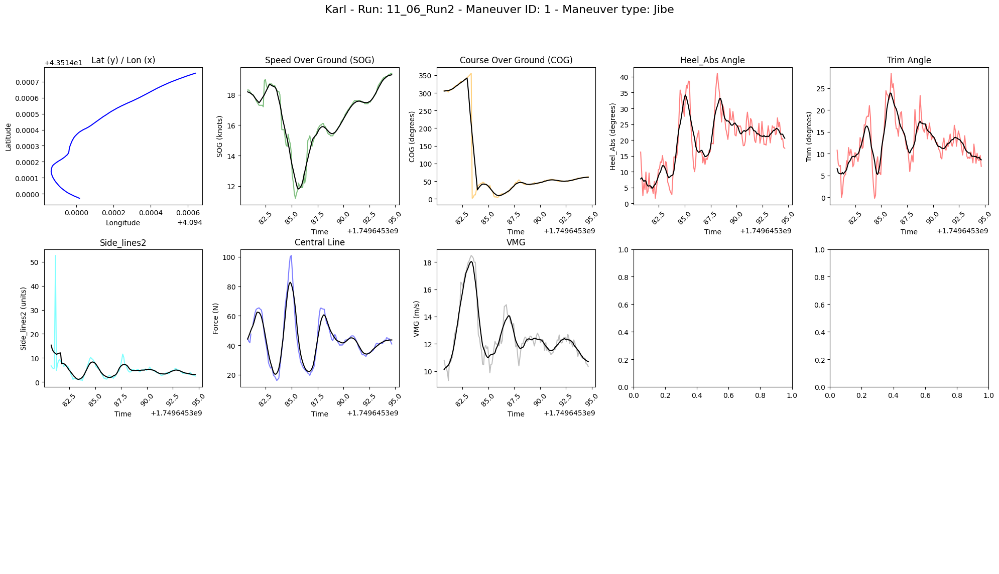


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-11 12:37:09.456000+00:00
  Maneuver Type: Tack
  Duration: 14.102999925613403 seconds
  Start Time: 1749645429.456
  End Time: 1749645443.559
  boat_name: Karl Maeder

avg TWS: 6.42 knots
avg TWA: -25.86 degrees
avg TWD: 181.49 degrees


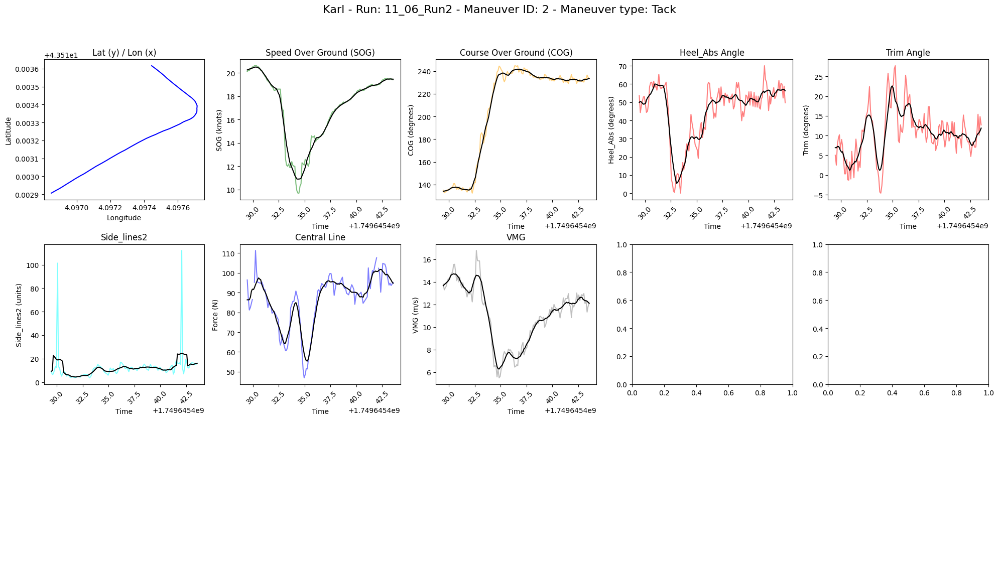


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-11 12:37:24.856000+00:00
  Maneuver Type: Tack
  Duration: 14.105000019073486 seconds
  Start Time: 1749645444.856
  End Time: 1749645458.961
  boat_name: Karl Maeder

avg TWS: 6.44 knots
avg TWA: 15.15 degrees
avg TWD: 181.41 degrees


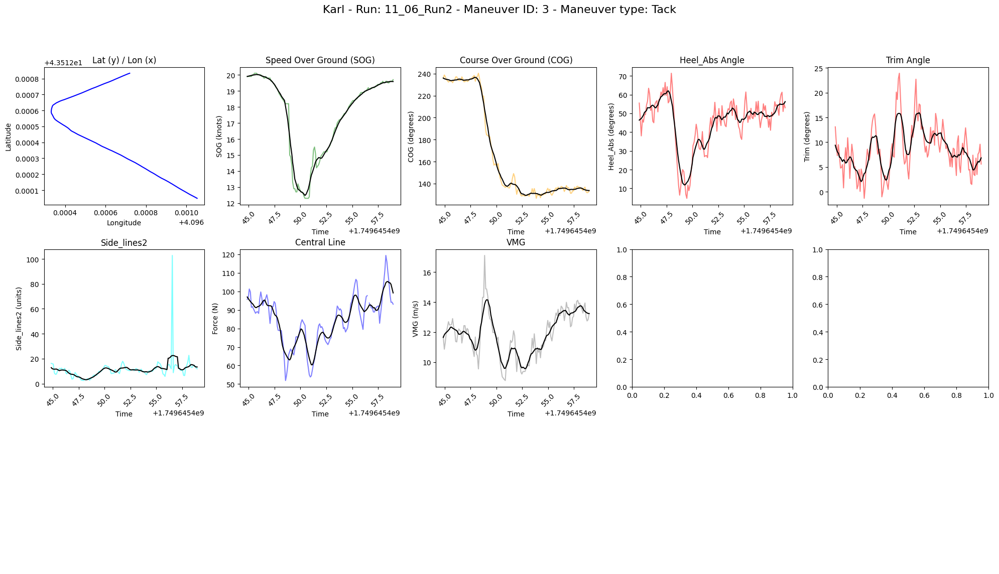


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-11 12:37:40.760000+00:00
  Maneuver Type: Tack
  Duration: 13.999000072479248 seconds
  Start Time: 1749645460.76
  End Time: 1749645474.759
  boat_name: Karl Maeder

avg TWS: 6.47 knots
avg TWA: -27.39 degrees
avg TWD: 180.37 degrees


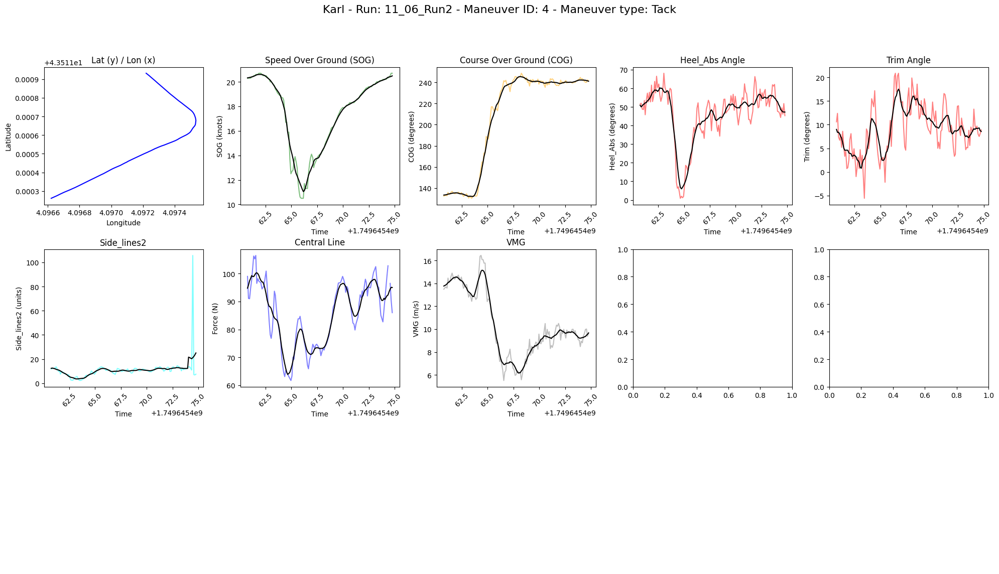


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-11 12:38:20.757000+00:00
  Maneuver Type: buoy
  Duration: 14.003000020980837 seconds
  Start Time: 1749645500.757
  End Time: 1749645514.76
  boat_name: Karl Maeder

avg TWS: 5.73 knots
avg TWA: 25.35 degrees
avg TWD: 184.84 degrees


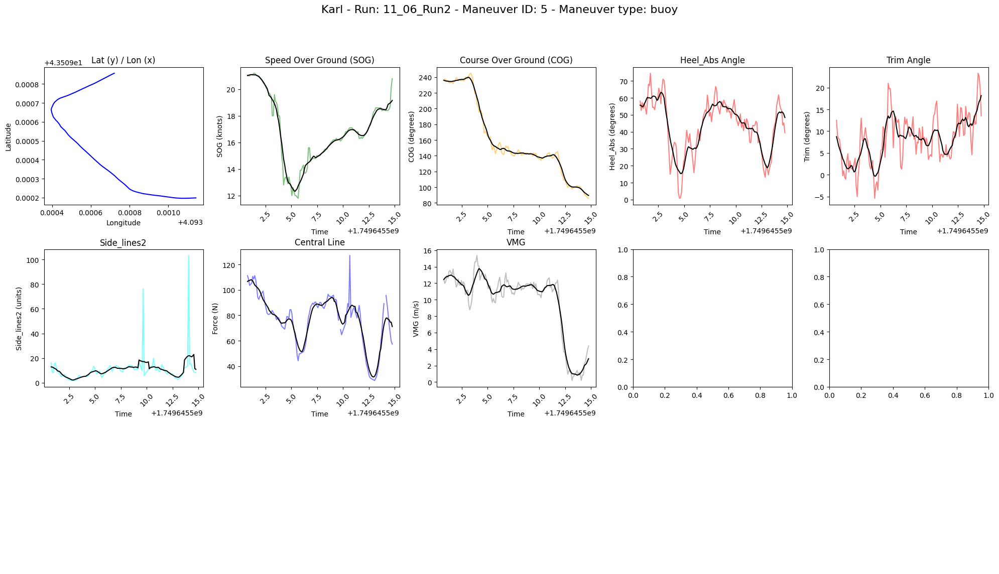


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-11 12:38:49.255000+00:00
  Maneuver Type: Jibe
  Duration: 13.911999940872192 seconds
  Start Time: 1749645529.255
  End Time: 1749645543.167
  boat_name: Karl Maeder

avg TWS: 5.95 knots
avg TWA: -80.79 degrees
avg TWD: 191.05 degrees


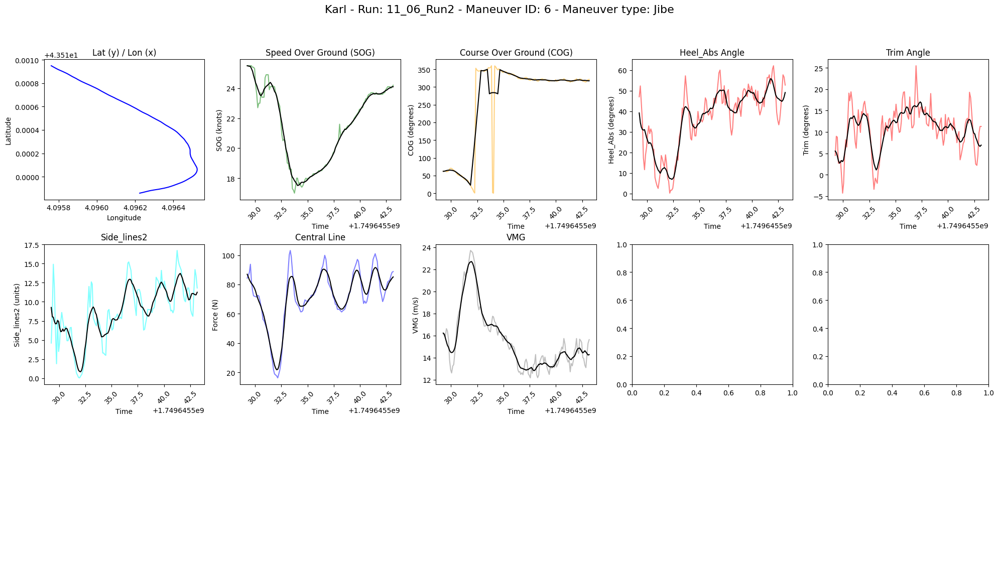


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-11 12:39:17.960000+00:00
  Maneuver Type: Jibe
  Duration: 13.999000072479248 seconds
  Start Time: 1749645557.96
  End Time: 1749645571.959
  boat_name: Karl Maeder

avg TWS: 6.56 knots
avg TWA: 38.80 degrees
avg TWD: 188.42 degrees


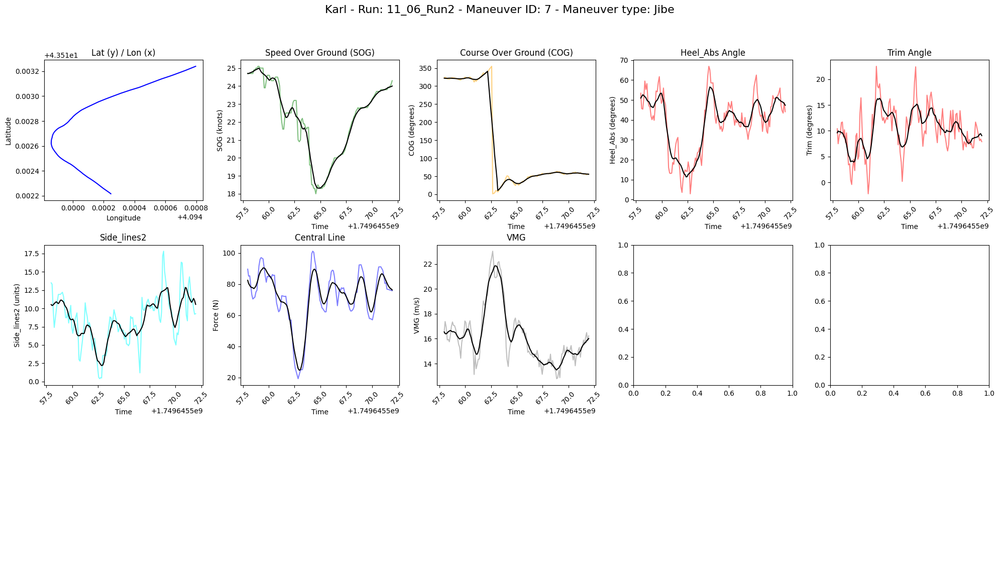


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-11 12:39:45.160000+00:00
  Maneuver Type: buoy
  Duration: 14.0 seconds
  Start Time: 1749645585.16
  End Time: 1749645599.16
  boat_name: Karl Maeder

avg TWS: 5.71 knots
avg TWA: 61.44 degrees
avg TWD: 190.34 degrees


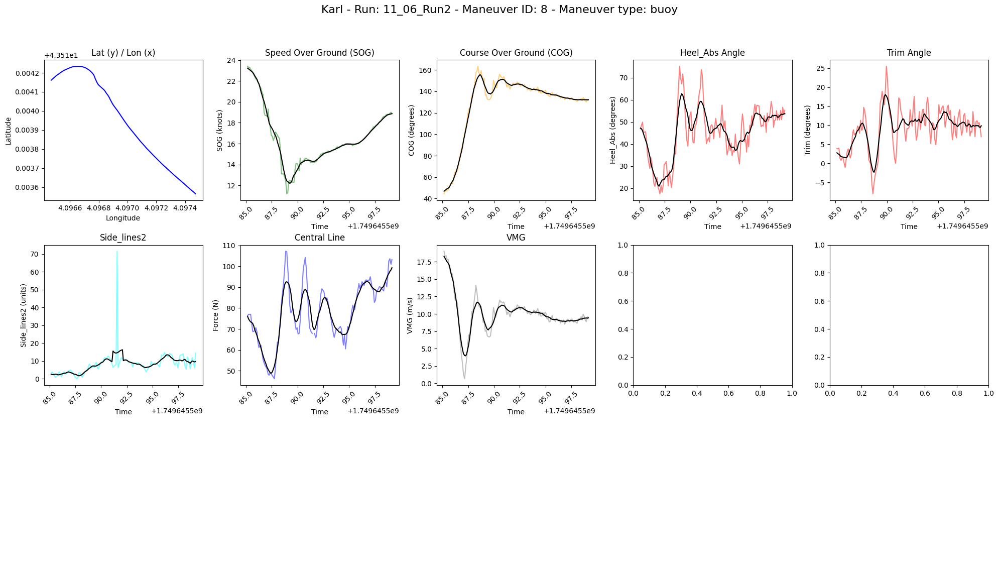


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-11 12:40:01.359000+00:00
  Maneuver Type: Tack
  Duration: 14.09500002861023 seconds
  Start Time: 1749645601.359
  End Time: 1749645615.454
  boat_name: Karl Maeder

avg TWS: 5.75 knots
avg TWA: -19.28 degrees
avg TWD: 192.19 degrees


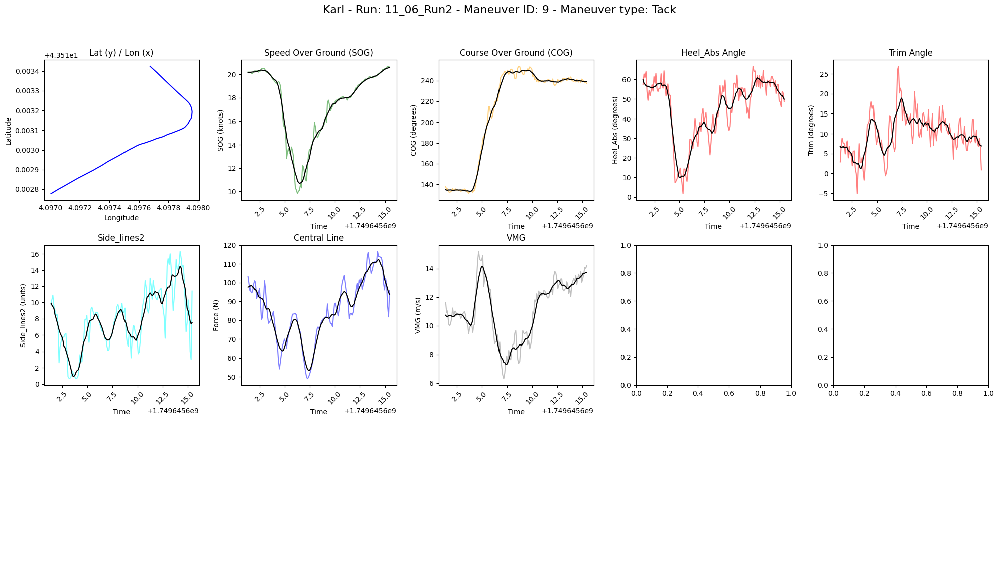


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-11 12:40:21.360000+00:00
  Maneuver Type: Tack
  Duration: 14.094000101089478 seconds
  Start Time: 1749645621.36
  End Time: 1749645635.454
  boat_name: Karl Maeder

avg TWS: 6.14 knots
avg TWA: 27.93 degrees
avg TWD: 196.87 degrees


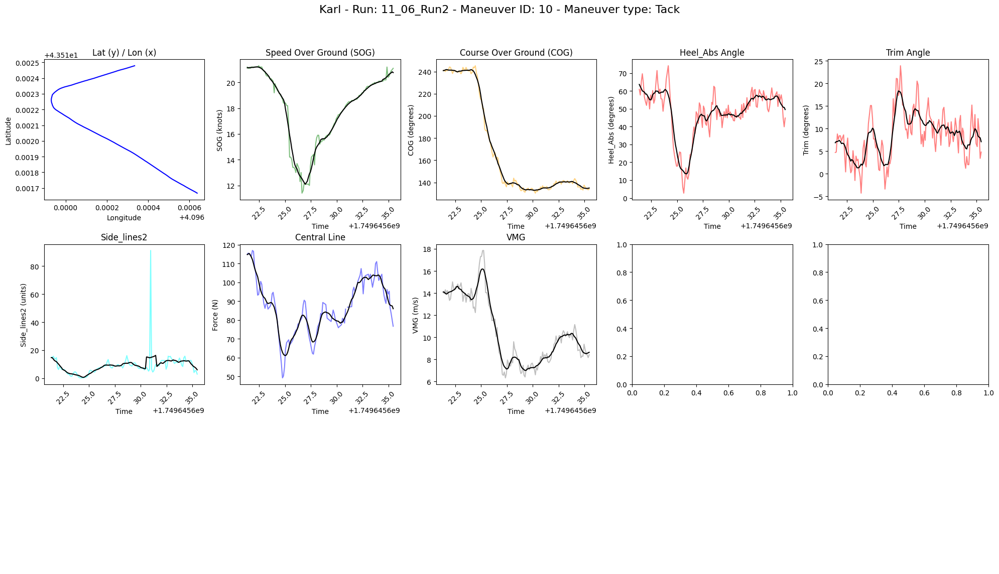


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-11 12:40:39.160000+00:00
  Maneuver Type: Tack
  Duration: 14.003000020980837 seconds
  Start Time: 1749645639.16
  End Time: 1749645653.163
  boat_name: Karl Maeder

avg TWS: 6.13 knots
avg TWA: -13.11 degrees
avg TWD: 199.62 degrees


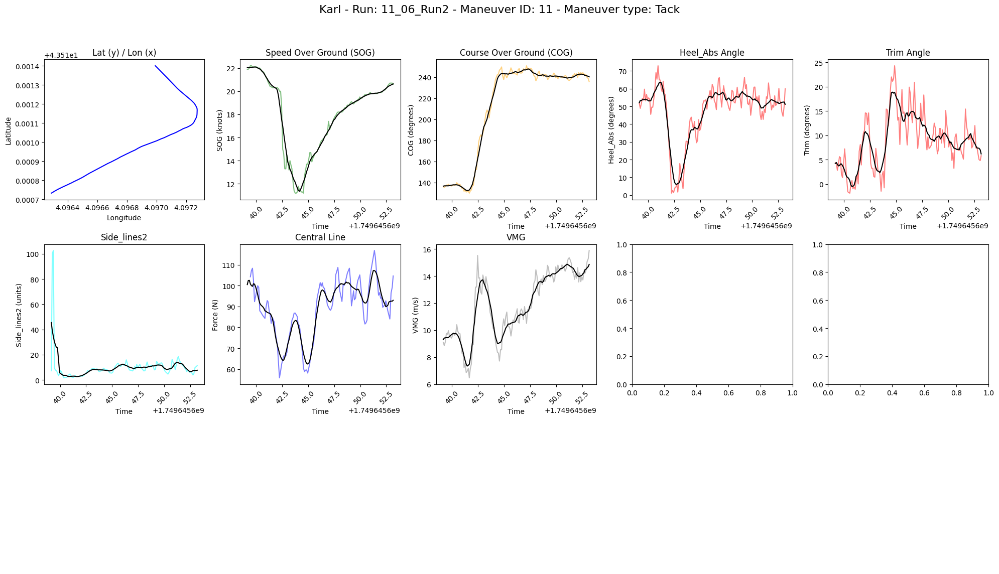


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-11 12:41:06.561000+00:00
  Maneuver Type: Tack
  Duration: 14.093999862670898 seconds
  Start Time: 1749645666.561
  End Time: 1749645680.655
  boat_name: Karl Maeder

avg TWS: 5.40 knots
avg TWA: 20.20 degrees
avg TWD: 190.39 degrees


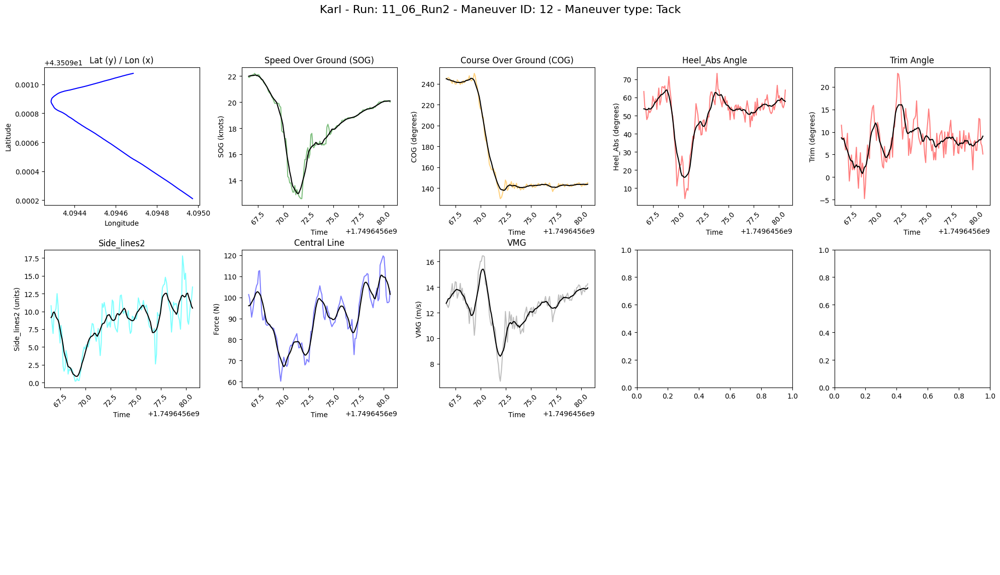


Maneuver details for Maneuver Index: 13
  Maneuver Time: 2025-06-11 12:41:44.655000+00:00
  Maneuver Type: Jibe
  Duration: 13.90400004386902 seconds
  Start Time: 1749645704.655
  End Time: 1749645718.559
  boat_name: Karl Maeder

avg TWS: 5.42 knots
avg TWA: -76.03 degrees
avg TWD: 188.73 degrees


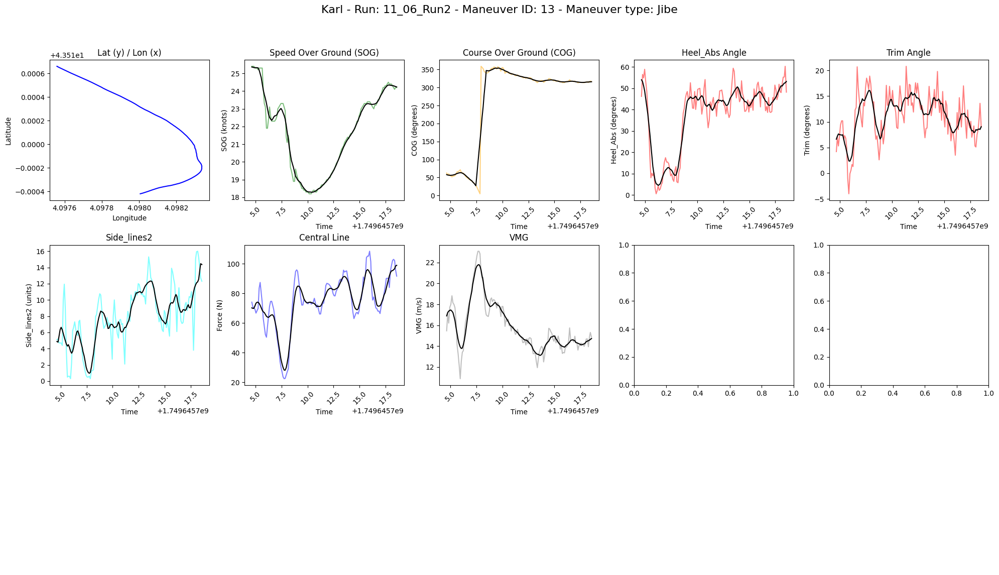


Maneuver details for Maneuver Index: 14
  Maneuver Time: 2025-06-11 12:42:19.657000+00:00
  Maneuver Type: Jibe
  Duration: 13.90400004386902 seconds
  Start Time: 1749645739.657
  End Time: 1749645753.561
  boat_name: Karl Maeder

avg TWS: 5.32 knots
avg TWA: 46.70 degrees
avg TWD: 185.99 degrees


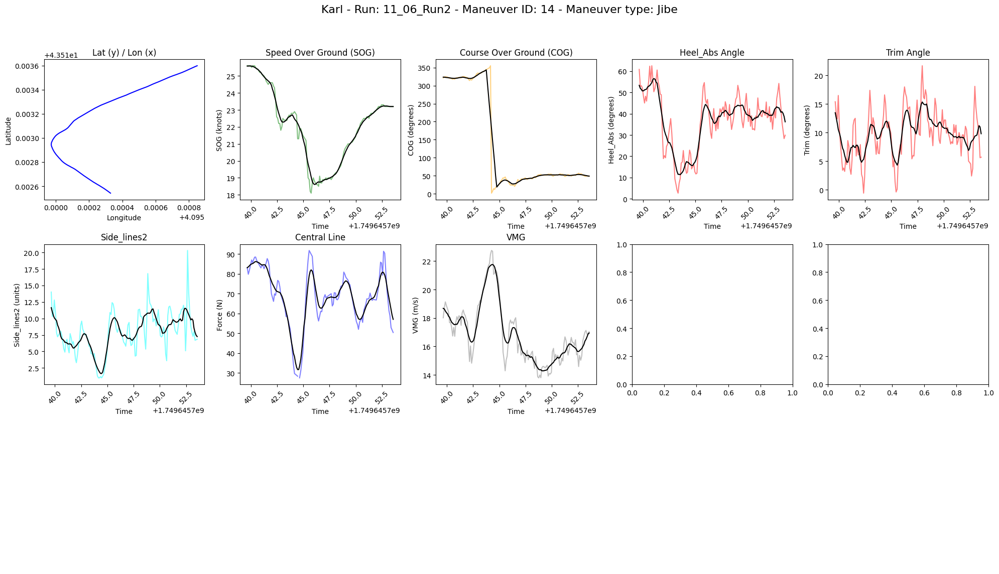

Summary for Karl - Run: 11_06_Run3

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-11 12:48:07.056000+00:00
  Maneuver Type: Tack
  Duration: 13.996000051498411 seconds
  Start Time: 1749646087.056
  End Time: 1749646101.052
  boat_name: Karl Maeder

avg TWS: 6.03 knots
avg TWA: -27.29 degrees
avg TWD: 191.17 degrees


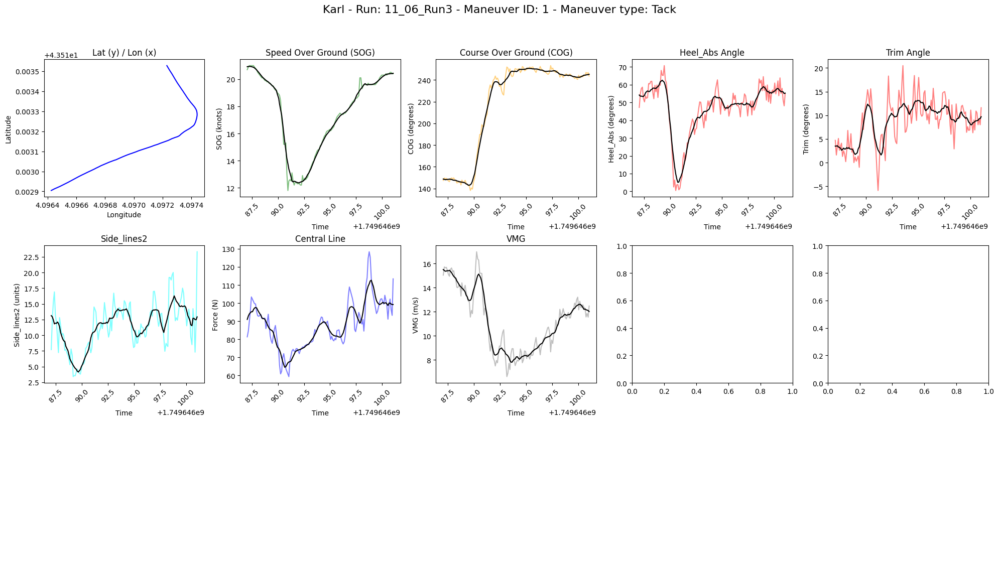


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-11 12:48:26.359000+00:00
  Maneuver Type: Tack
  Duration: 13.999000072479248 seconds
  Start Time: 1749646106.359
  End Time: 1749646120.358
  boat_name: Karl Maeder

avg TWS: 6.30 knots
avg TWA: 19.18 degrees
avg TWD: 192.92 degrees


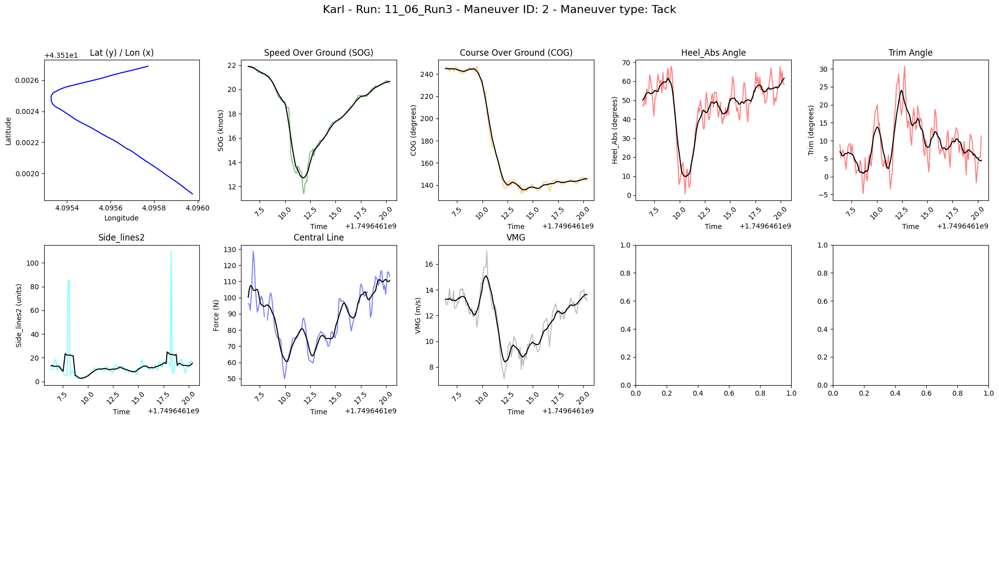


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-11 12:48:44.957000+00:00
  Maneuver Type: Tack
  Duration: 14.08899998664856 seconds
  Start Time: 1749646124.957
  End Time: 1749646139.046
  boat_name: Karl Maeder

avg TWS: 6.16 knots
avg TWA: -20.11 degrees
avg TWD: 194.62 degrees


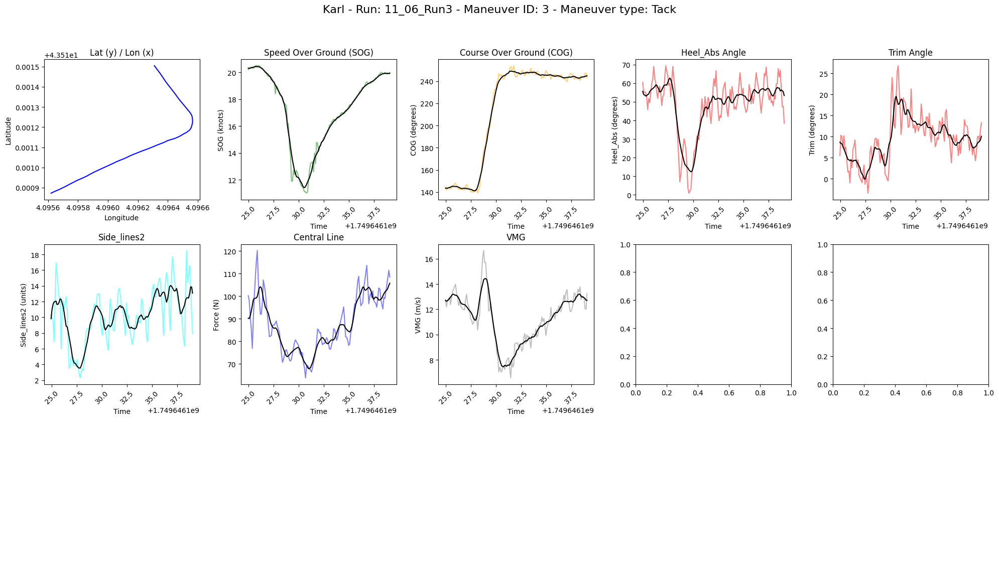


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-11 12:49:08.756000+00:00
  Maneuver Type: Tack
  Duration: 14.000999927520752 seconds
  Start Time: 1749646148.756
  End Time: 1749646162.757
  boat_name: Karl Maeder

avg TWS: 6.14 knots
avg TWA: 17.77 degrees
avg TWD: 193.81 degrees


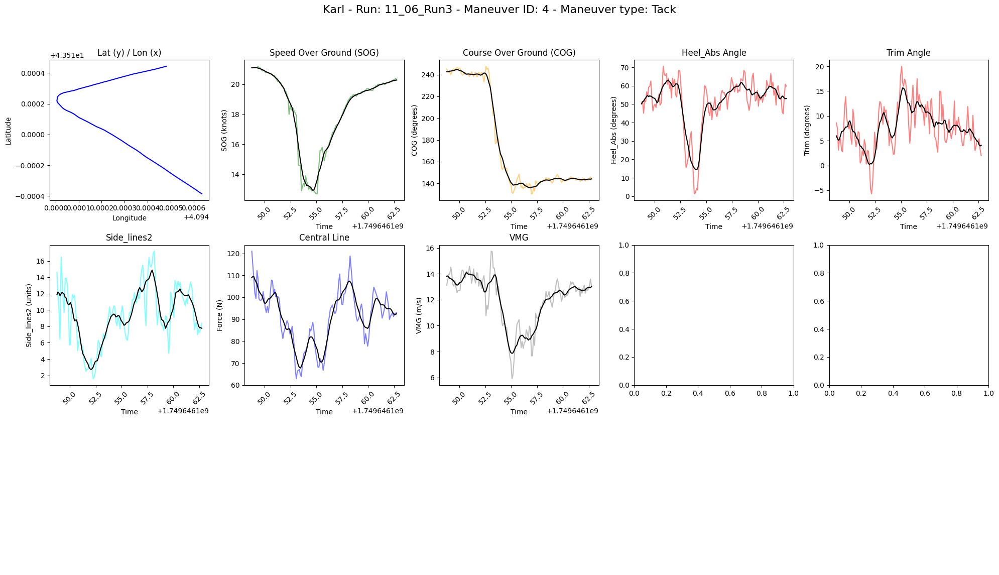


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-11 12:49:51.059000+00:00
  Maneuver Type: Jibe
  Duration: 14.1010000705719 seconds
  Start Time: 1749646191.059
  End Time: 1749646205.16
  boat_name: Karl Maeder

avg TWS: 6.15 knots
avg TWA: -82.46 degrees
avg TWD: 194.75 degrees


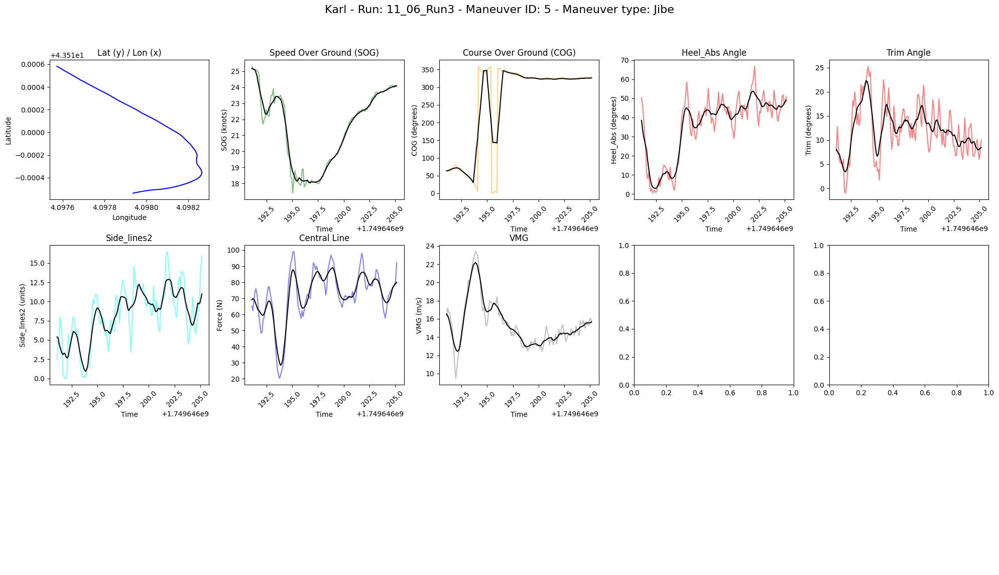


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-11 12:50:31.052000+00:00
  Maneuver Type: Jibe
  Duration: 13.907000064849854 seconds
  Start Time: 1749646231.052
  End Time: 1749646244.959
  boat_name: Karl Maeder

avg TWS: 5.87 knots
avg TWA: 88.75 degrees
avg TWD: 196.85 degrees


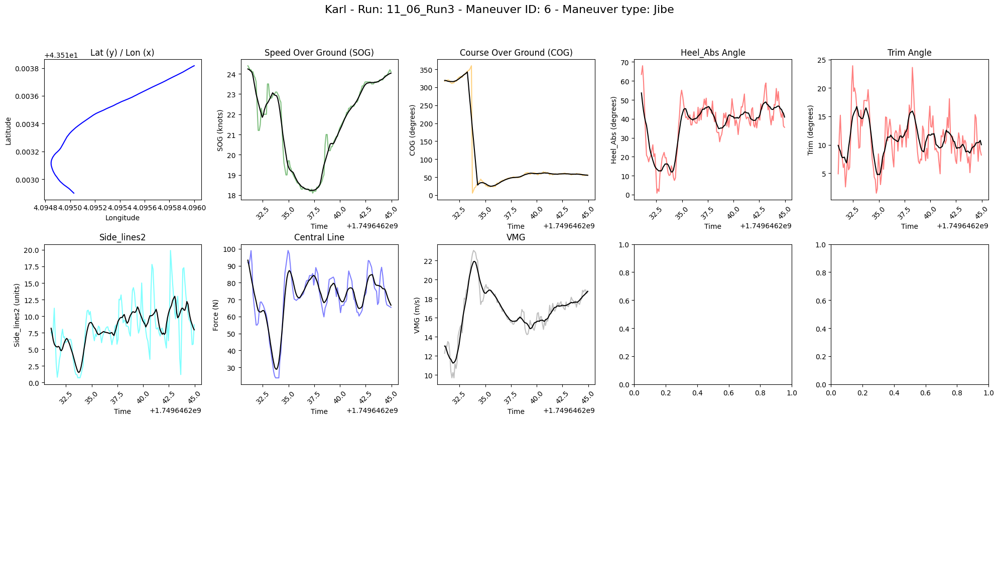


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-11 12:50:48.656000+00:00
  Maneuver Type: buoy
  Duration: 14.100000143051147 seconds
  Start Time: 1749646248.656
  End Time: 1749646262.756
  boat_name: Karl Maeder

avg TWS: 5.79 knots
avg TWA: 65.96 degrees
avg TWD: 196.29 degrees


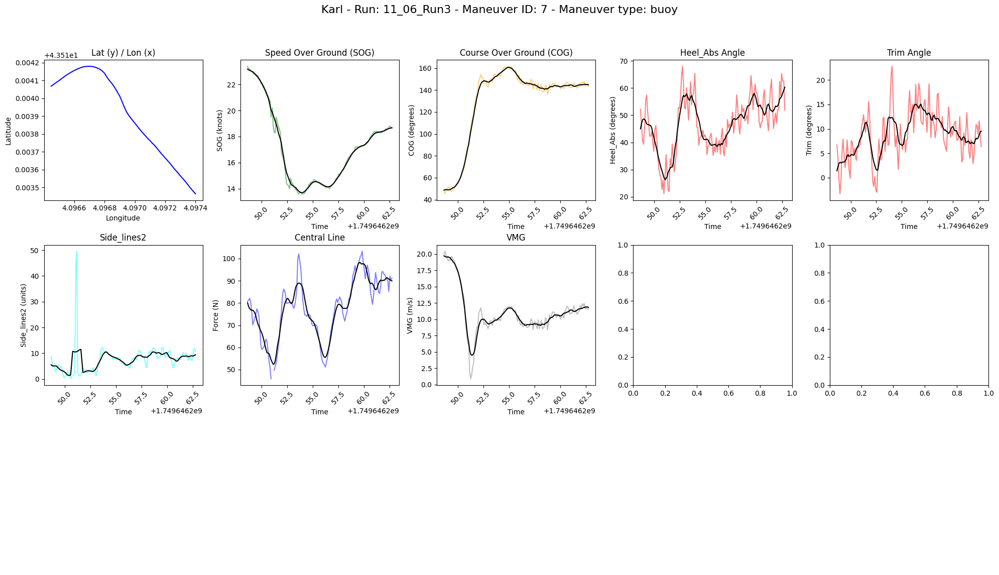


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-11 12:51:05.456000+00:00
  Maneuver Type: Tack
  Duration: 14.102999925613403 seconds
  Start Time: 1749646265.456
  End Time: 1749646279.559
  boat_name: Karl Maeder

avg TWS: 5.58 knots
avg TWA: -19.42 degrees
avg TWD: 194.77 degrees


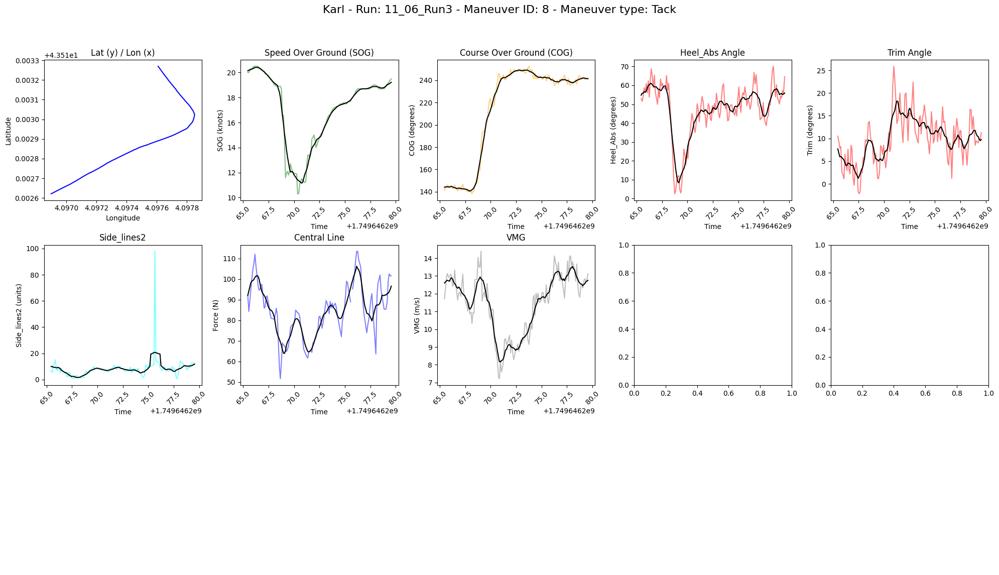


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-11 12:51:27.259000+00:00
  Maneuver Type: Tack
  Duration: 13.90499997138977 seconds
  Start Time: 1749646287.259
  End Time: 1749646301.164
  boat_name: Karl Maeder

avg TWS: 5.69 knots
avg TWA: 21.55 degrees
avg TWD: 187.69 degrees


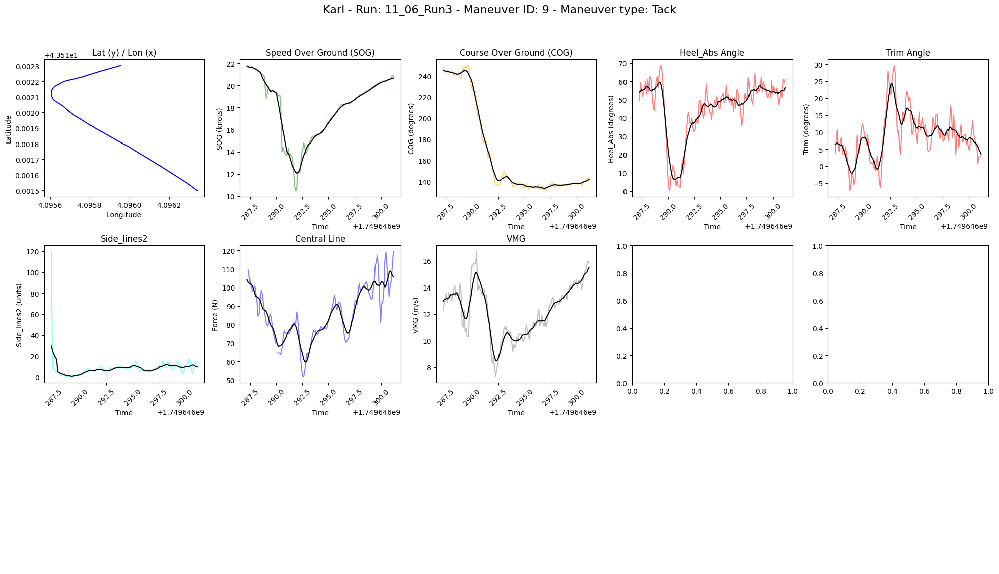


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-11 12:51:43.857000+00:00
  Maneuver Type: Tack
  Duration: 14.101999998092651 seconds
  Start Time: 1749646303.857
  End Time: 1749646317.959
  boat_name: Karl Maeder

avg TWS: 5.62 knots
avg TWA: -22.14 degrees
avg TWD: 190.08 degrees


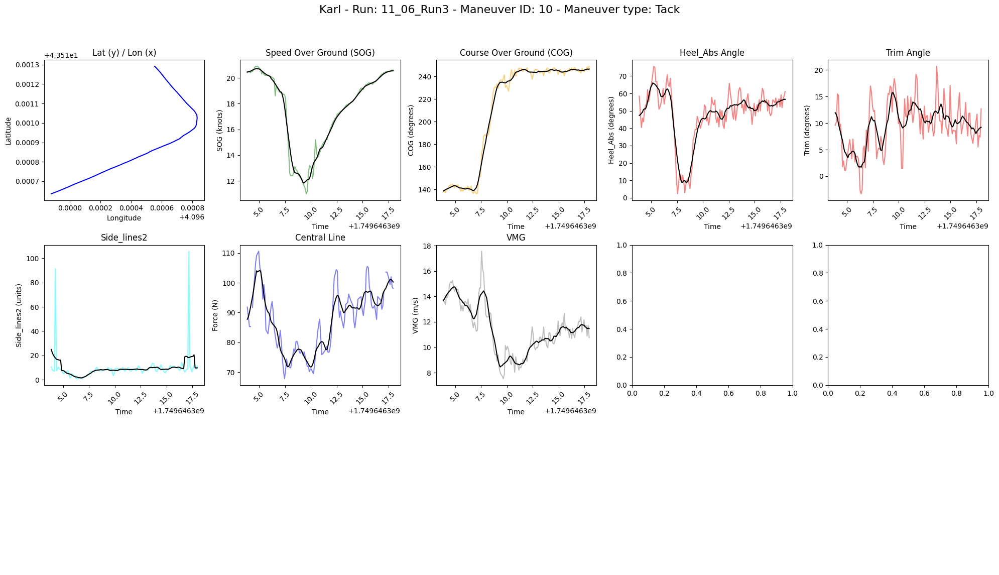


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-11 12:52:09.760000+00:00
  Maneuver Type: Tack
  Duration: 13.895999908447266 seconds
  Start Time: 1749646329.76
  End Time: 1749646343.656
  boat_name: Karl Maeder

avg TWS: 6.30 knots
avg TWA: 23.02 degrees
avg TWD: 193.17 degrees


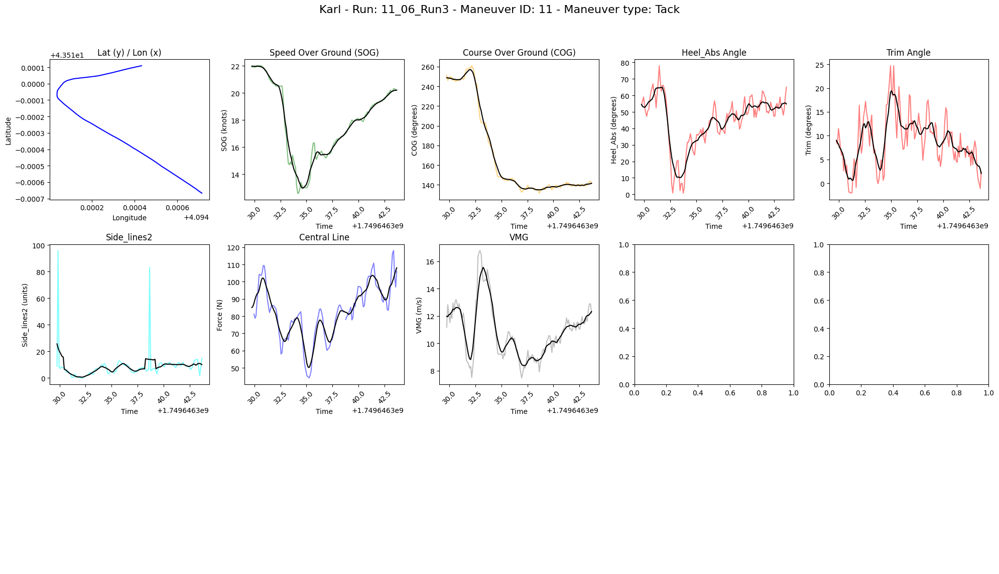


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-11 12:52:50.257000+00:00
  Maneuver Type: Jibe
  Duration: 14.0 seconds
  Start Time: 1749646370.257
  End Time: 1749646384.257
  boat_name: Karl Maeder

avg TWS: 5.46 knots
avg TWA: -77.51 degrees
avg TWD: 193.30 degrees


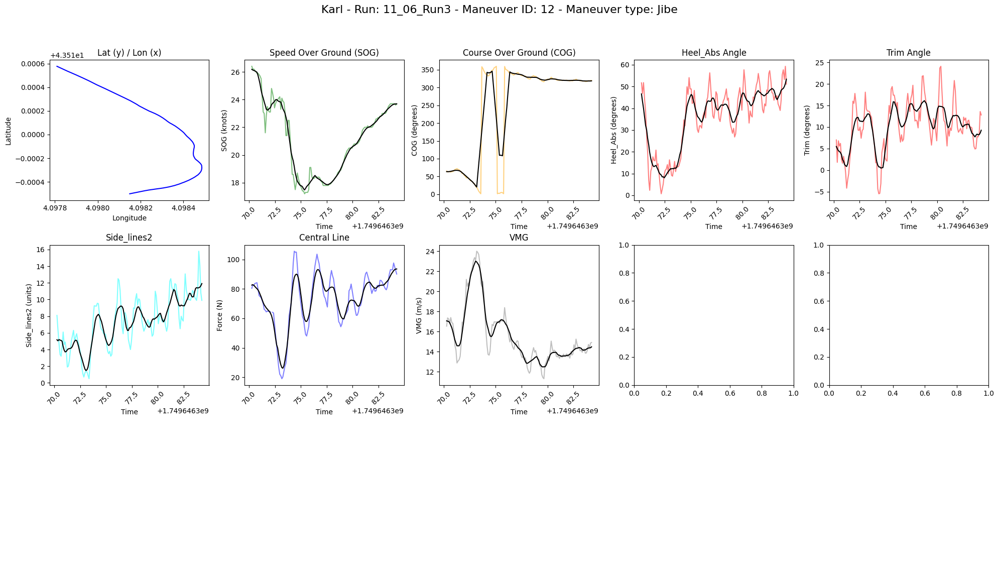


Maneuver details for Maneuver Index: 13
  Maneuver Time: 2025-06-11 12:53:29.657000+00:00
  Maneuver Type: Jibe
  Duration: 14.101999998092651 seconds
  Start Time: 1749646409.657
  End Time: 1749646423.759
  boat_name: Karl Maeder

avg TWS: 6.06 knots
avg TWA: 47.03 degrees
avg TWD: 189.92 degrees


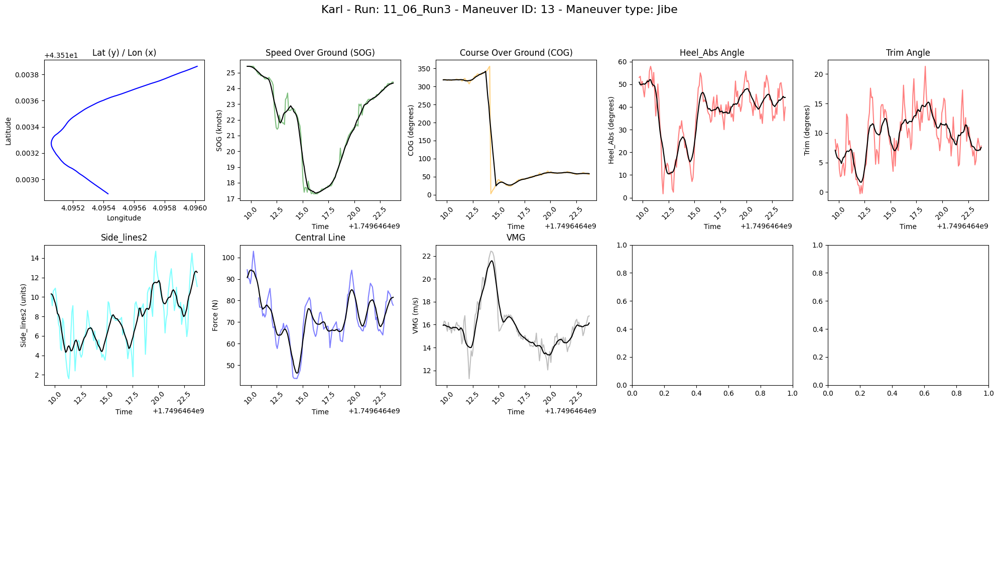

Summary for Karl - Run: 11_06_Run4

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-11 12:59:02.072000+00:00
  Maneuver Type: Tack
  Duration: 13.98300004005432 seconds
  Start Time: 1749646742.072
  End Time: 1749646756.055
  boat_name: Karl Maeder

avg TWS: 6.07 knots
avg TWA: -16.91 degrees
avg TWD: 190.63 degrees


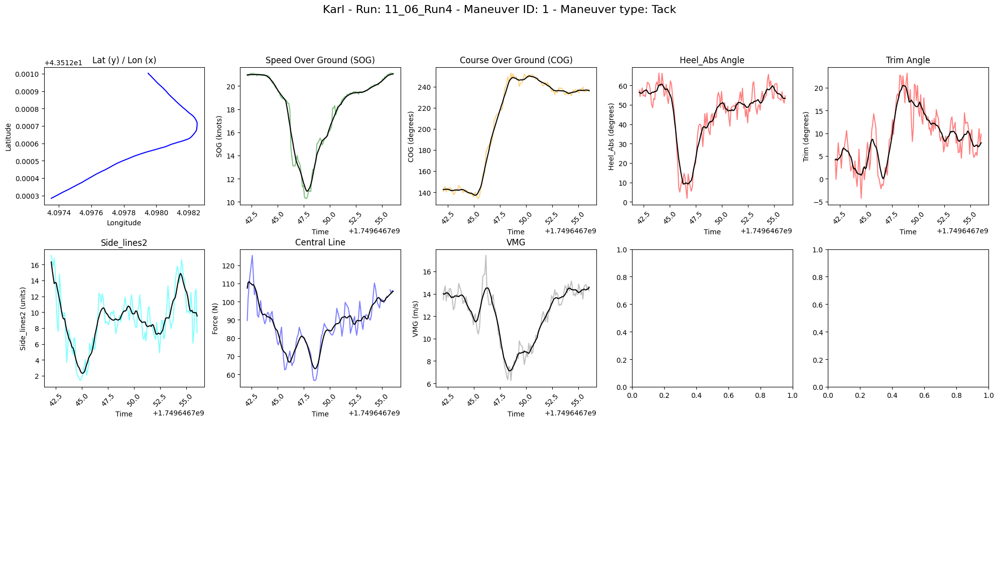


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-11 12:59:19.957000+00:00
  Maneuver Type: Tack
  Duration: 13.900000095367432 seconds
  Start Time: 1749646759.957
  End Time: 1749646773.857
  boat_name: Karl Maeder

avg TWS: 6.16 knots
avg TWA: 19.23 degrees
avg TWD: 189.23 degrees


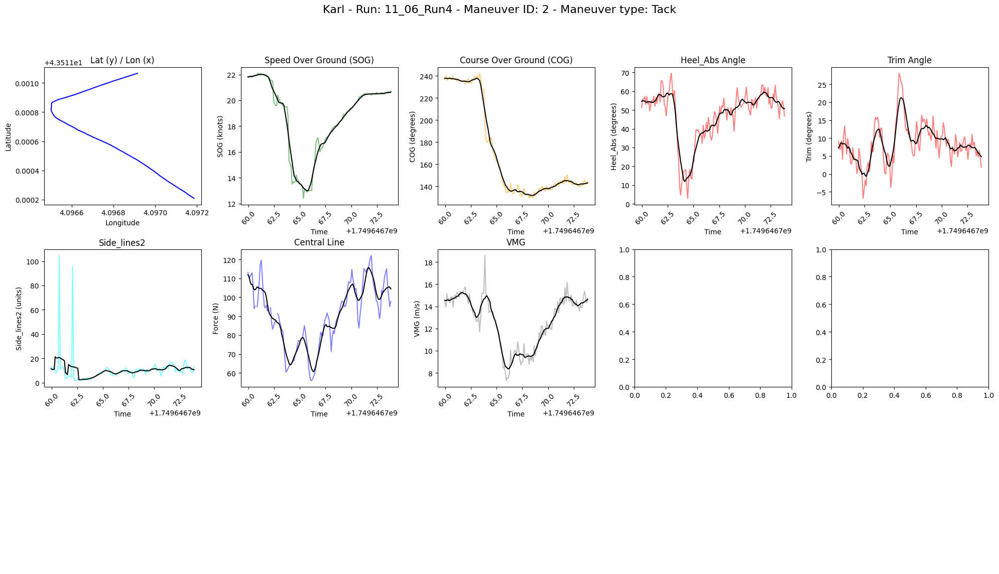


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-11 12:59:40.073000+00:00
  Maneuver Type: Tack
  Duration: 14.08400011062622 seconds
  Start Time: 1749646780.073
  End Time: 1749646794.157
  boat_name: Karl Maeder

avg TWS: 5.35 knots
avg TWA: -30.37 degrees
avg TWD: 179.25 degrees


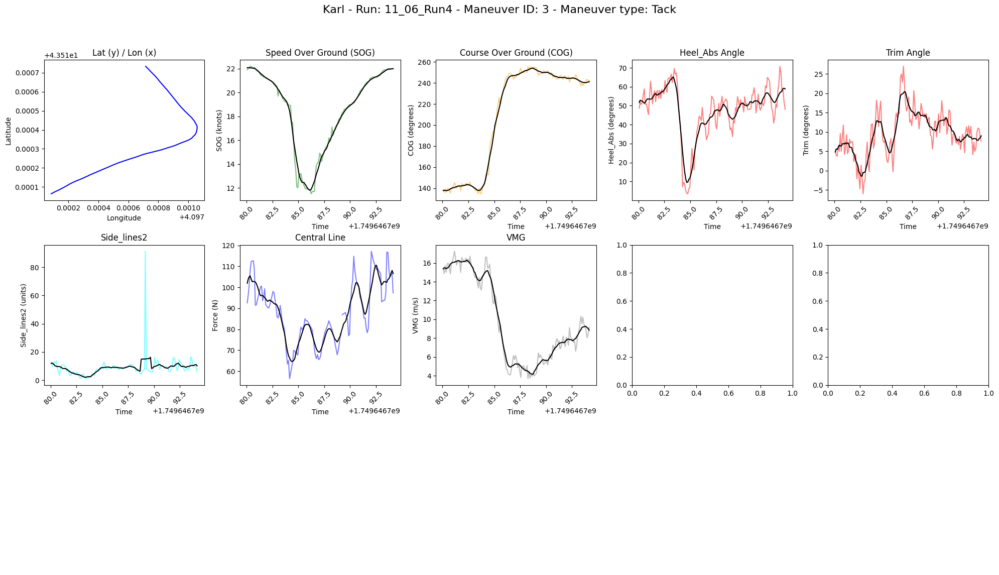


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-11 13:00:07.076000+00:00
  Maneuver Type: Tack
  Duration: 13.9760000705719 seconds
  Start Time: 1749646807.076
  End Time: 1749646821.052
  boat_name: Karl Maeder

avg TWS: 5.67 knots
avg TWA: 12.16 degrees
avg TWD: 176.35 degrees


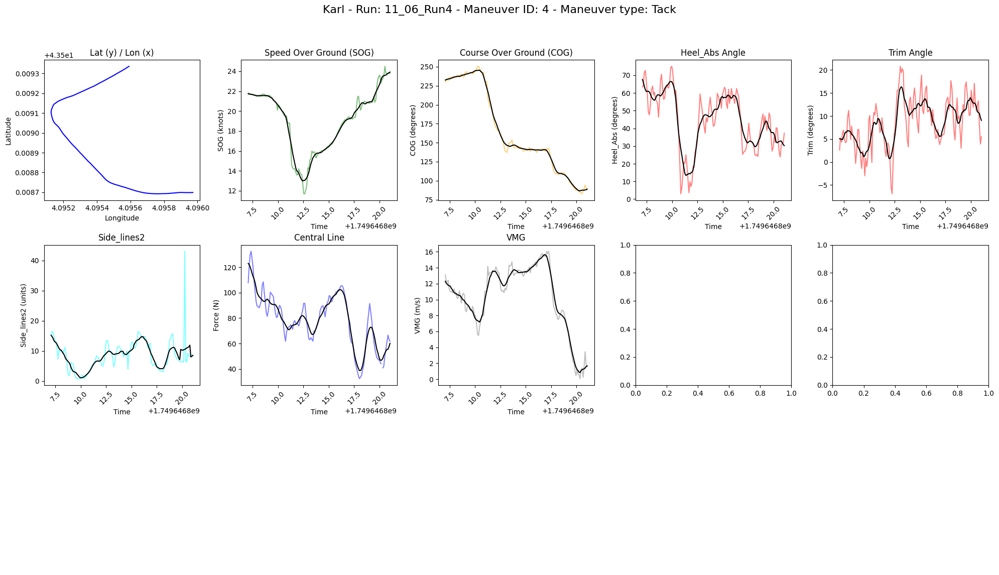


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-11 13:00:39.956000+00:00
  Maneuver Type: Jibe
  Duration: 14.09500002861023 seconds
  Start Time: 1749646839.956
  End Time: 1749646854.051
  boat_name: Karl Maeder

avg TWS: 5.61 knots
avg TWA: -12.48 degrees
avg TWD: 174.32 degrees


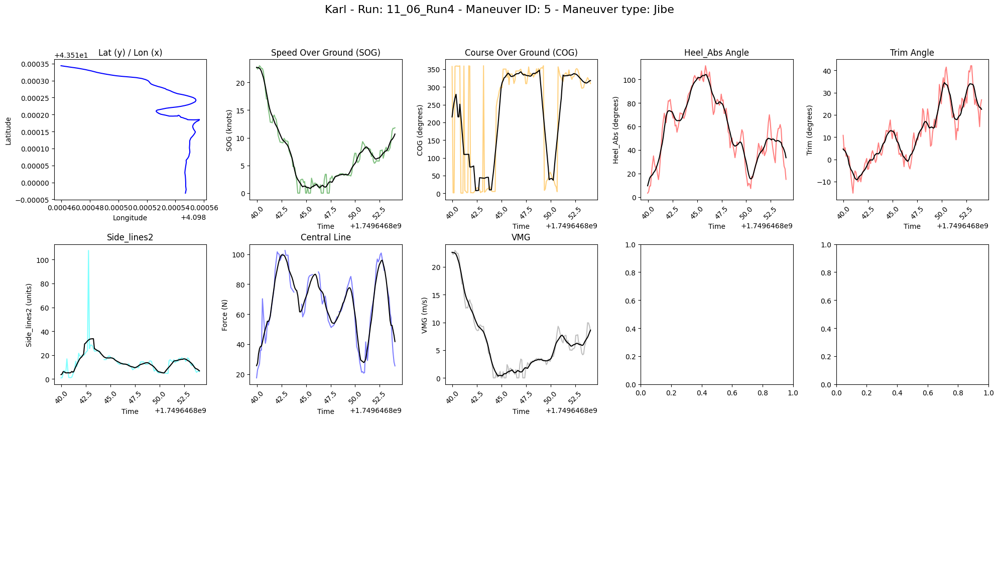


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-11 13:01:43.564000+00:00
  Maneuver Type: buoy
  Duration: 14.091000080108644 seconds
  Start Time: 1749646903.564
  End Time: 1749646917.655
  boat_name: Karl Maeder

avg TWS: 6.62 knots
avg TWA: 48.00 degrees
avg TWD: 184.63 degrees


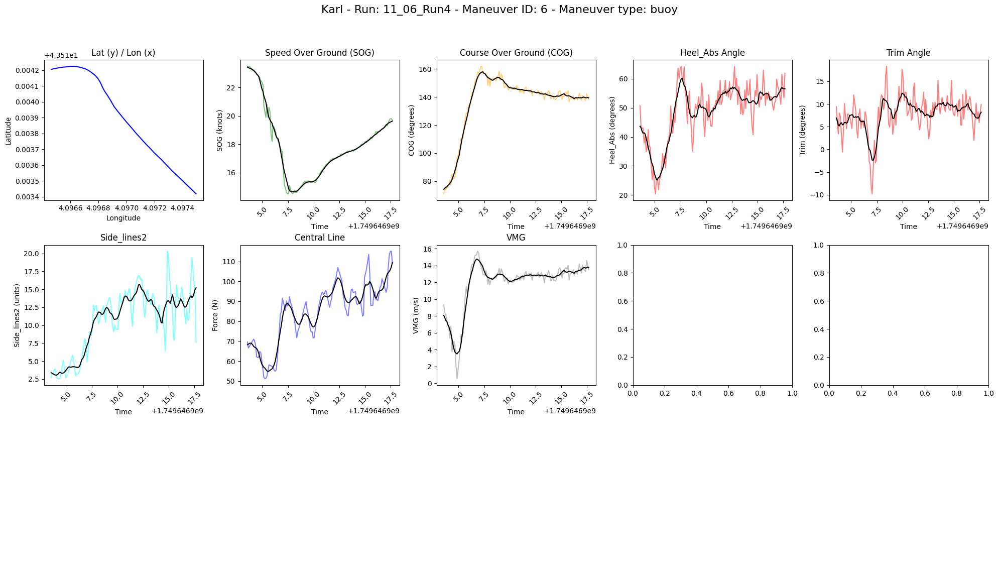


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-11 13:01:56.956000+00:00
  Maneuver Type: Tack
  Duration: 14.003000020980837 seconds
  Start Time: 1749646916.956
  End Time: 1749646930.959
  boat_name: Karl Maeder

avg TWS: 6.66 knots
avg TWA: -23.71 degrees
avg TWD: 184.57 degrees


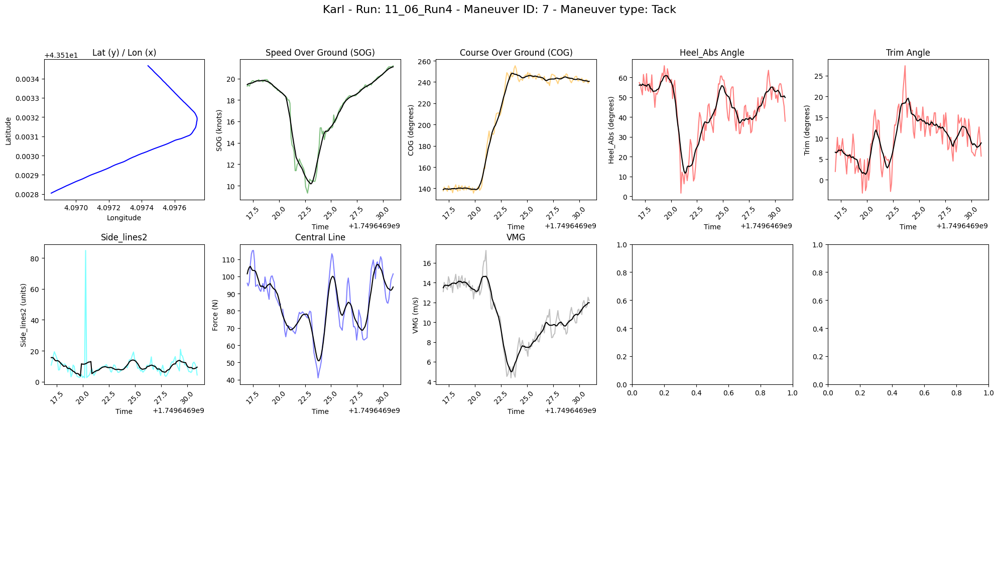


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-11 13:02:15.256000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749646935.256
  End Time: 1749646949.256
  boat_name: Karl Maeder

avg TWS: 6.44 knots
avg TWA: 22.13 degrees
avg TWD: 185.91 degrees


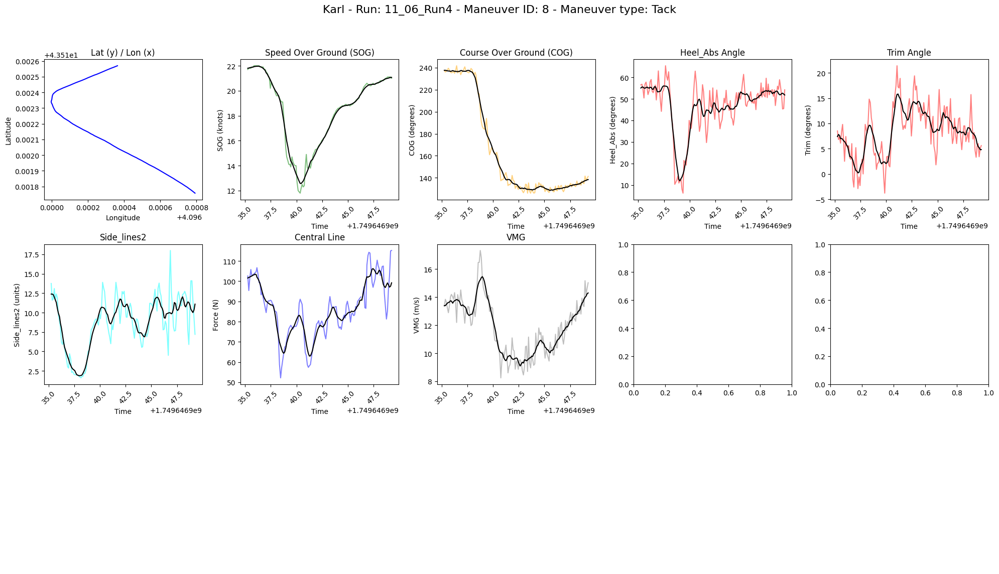


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-11 13:02:33.058000+00:00
  Maneuver Type: Tack
  Duration: 14.01799988746643 seconds
  Start Time: 1749646953.058
  End Time: 1749646967.076
  boat_name: Karl Maeder

avg TWS: 6.39 knots
avg TWA: -13.50 degrees
avg TWD: 185.05 degrees


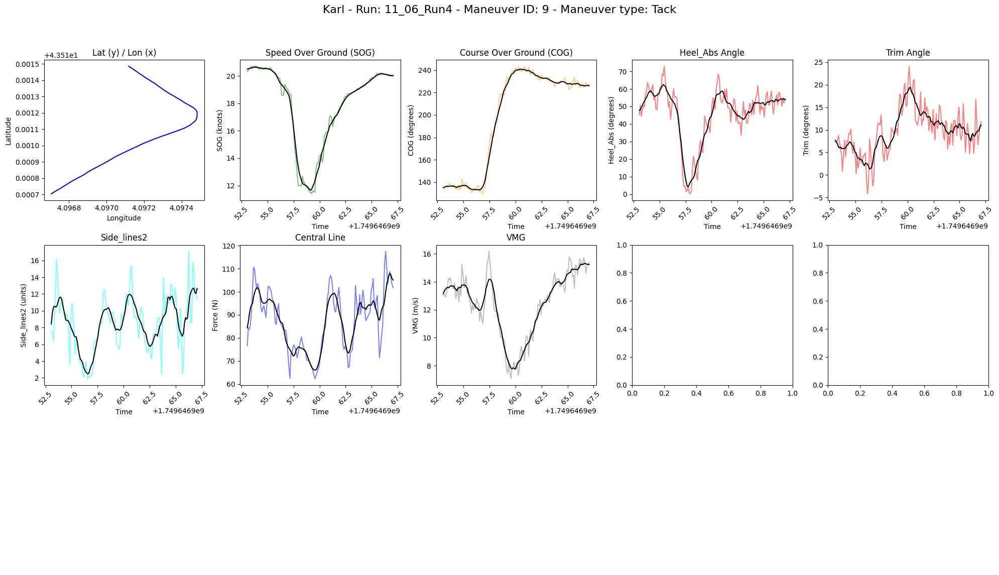


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-11 13:03:05.656000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749646985.656
  End Time: 1749646999.656
  boat_name: Karl Maeder

avg TWS: 6.97 knots
avg TWA: 24.42 degrees
avg TWD: 182.60 degrees


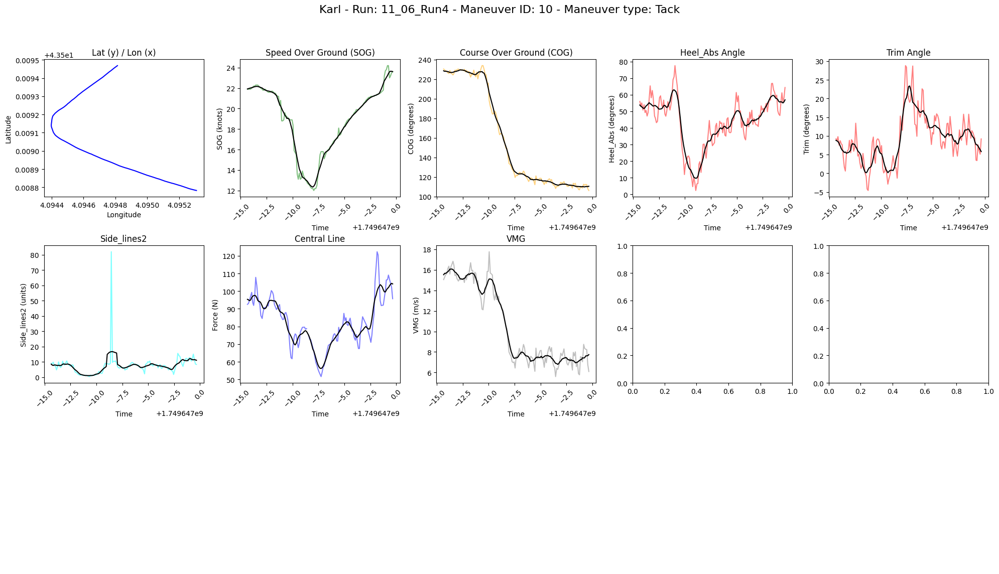


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-11 13:03:35.061000+00:00
  Maneuver Type: Jibe
  Duration: 14.09599995613098 seconds
  Start Time: 1749647015.061
  End Time: 1749647029.157
  boat_name: Karl Maeder

avg TWS: 6.93 knots
avg TWA: -80.62 degrees
avg TWD: 180.90 degrees


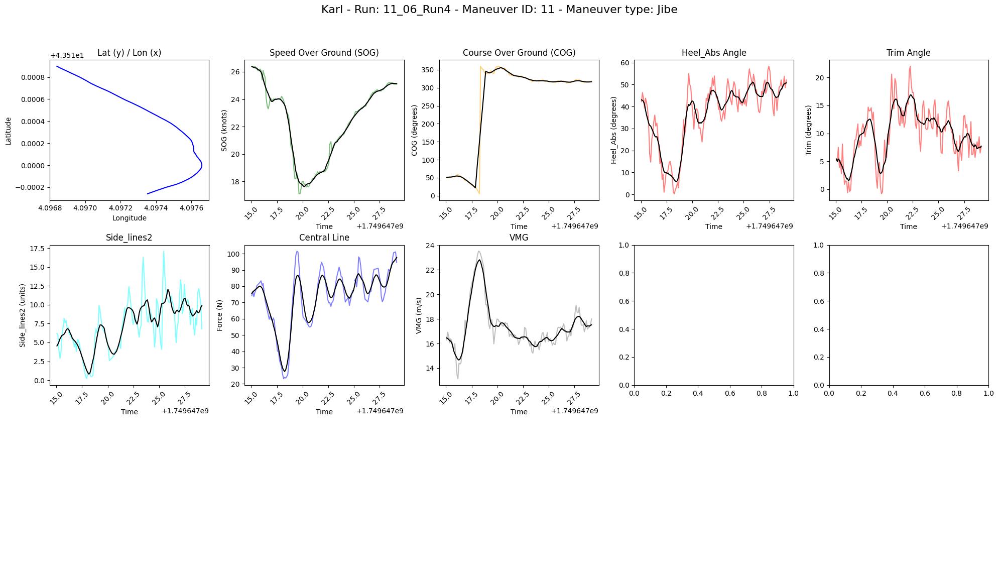


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-11 13:04:03.157000+00:00
  Maneuver Type: Jibe
  Duration: 14.101999998092651 seconds
  Start Time: 1749647043.157
  End Time: 1749647057.259
  boat_name: Karl Maeder

avg TWS: 6.72 knots
avg TWA: 43.53 degrees
avg TWD: 184.75 degrees


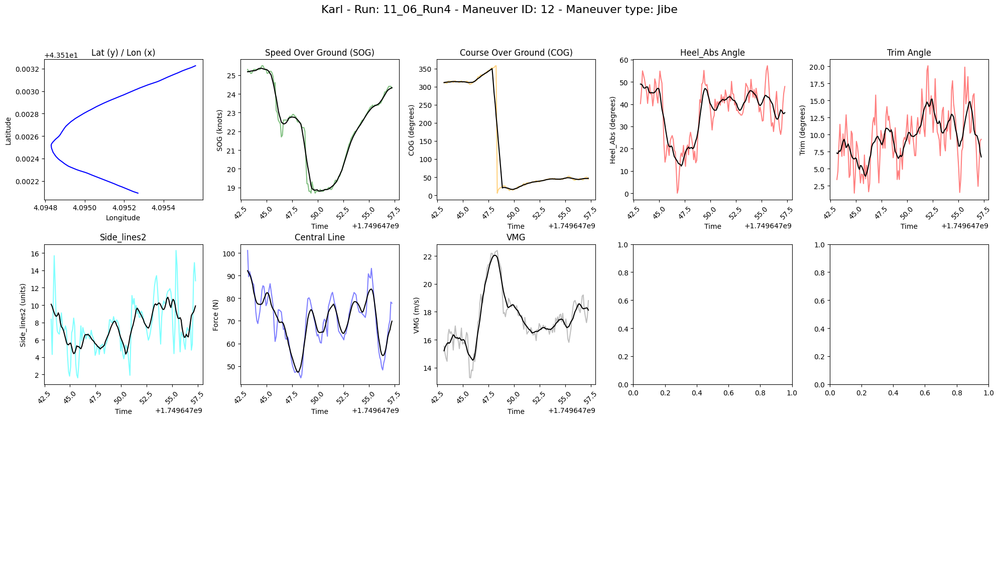


Maneuver details for Maneuver Index: 13
  Maneuver Time: 2025-06-11 13:04:25.655000+00:00
  Maneuver Type: buoy
  Duration: 14.1010000705719 seconds
  Start Time: 1749647065.655
  End Time: 1749647079.756
  boat_name: Karl Maeder

avg TWS: 6.19 knots
avg TWA: 68.70 degrees
avg TWD: 187.44 degrees


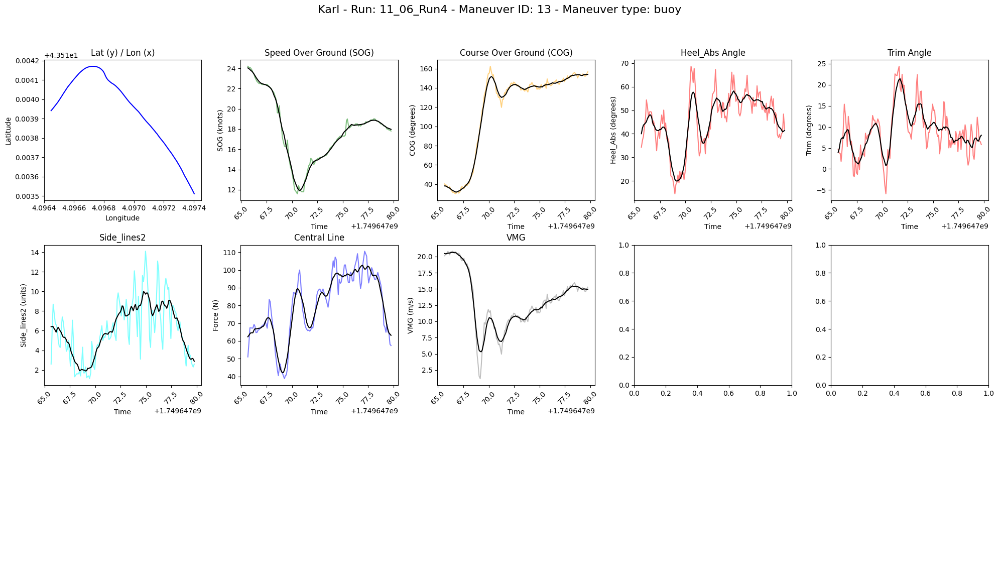

Summary for Karl - Run: 11_06_Run5

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-11 13:09:47.556000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749647387.556
  End Time: 1749647401.556
  boat_name: Karl Maeder

avg TWS: 6.31 knots
avg TWA: -30.01 degrees
avg TWD: 178.16 degrees


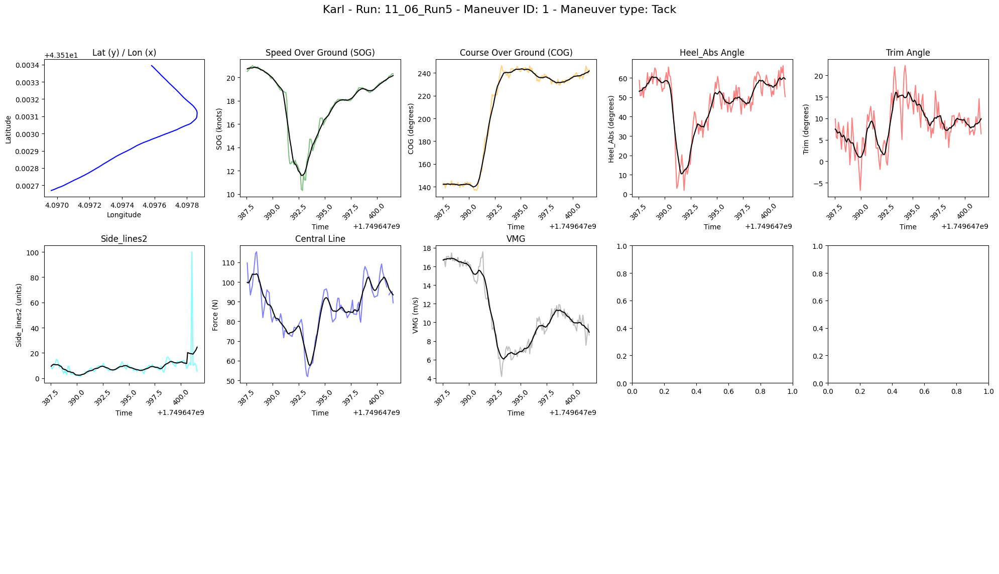


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-11 13:10:05.857000+00:00
  Maneuver Type: Tack
  Duration: 14.101999998092651 seconds
  Start Time: 1749647405.857
  End Time: 1749647419.959
  boat_name: Karl Maeder

avg TWS: 6.56 knots
avg TWA: 7.68 degrees
avg TWD: 178.43 degrees


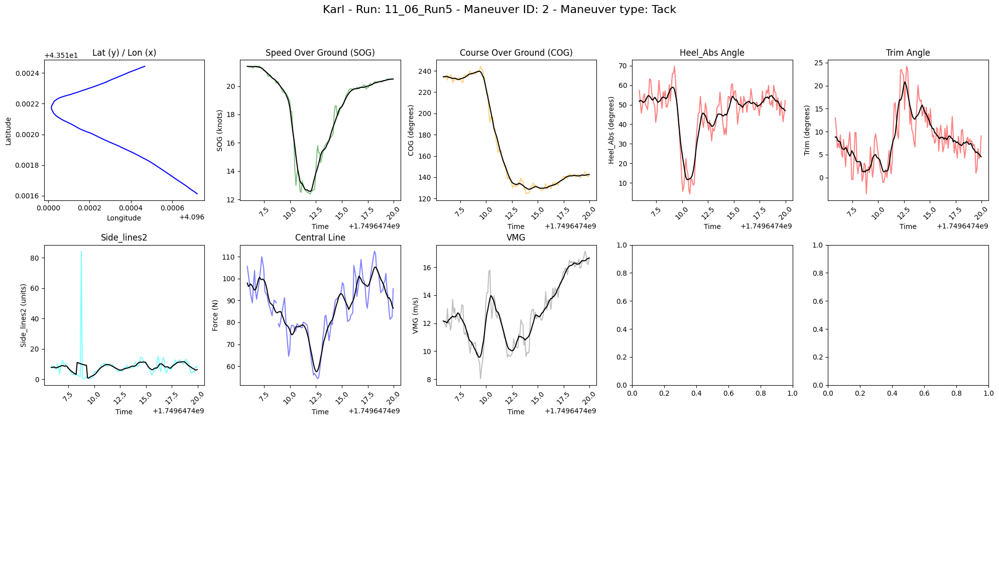


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-11 13:10:27.960000+00:00
  Maneuver Type: Tack
  Duration: 14.111999988555908 seconds
  Start Time: 1749647427.96
  End Time: 1749647442.072
  boat_name: Karl Maeder

avg TWS: 6.22 knots
avg TWA: -32.90 degrees
avg TWD: 177.36 degrees


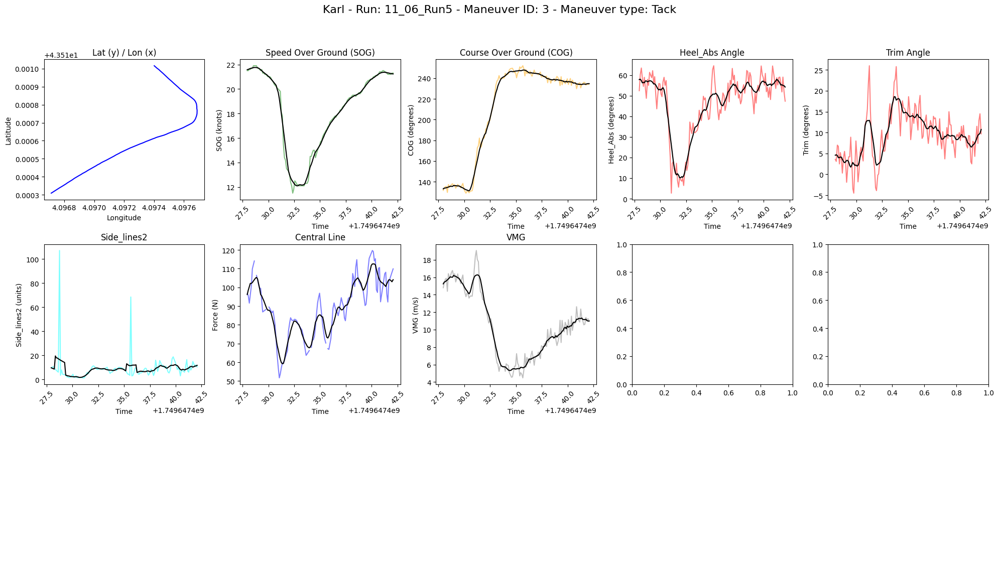


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-11 13:10:54.861000+00:00
  Maneuver Type: Tack
  Duration: 13.996999979019163 seconds
  Start Time: 1749647454.861
  End Time: 1749647468.858
  boat_name: Karl Maeder

avg TWS: 5.95 knots
avg TWA: 7.52 degrees
avg TWD: 179.55 degrees


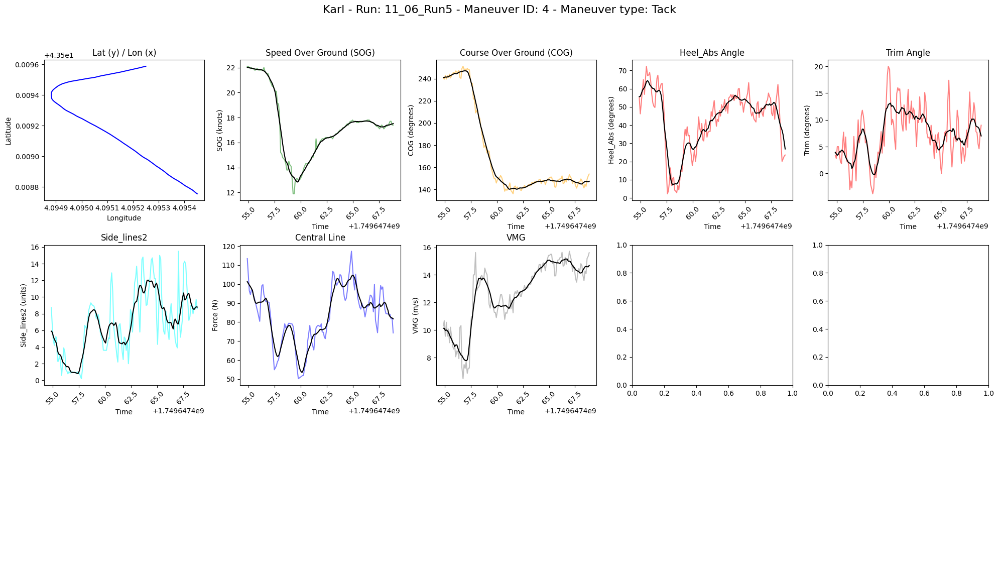


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-11 13:11:27.453000+00:00
  Maneuver Type: Jibe
  Duration: 14.0 seconds
  Start Time: 1749647487.453
  End Time: 1749647501.453
  boat_name: Karl Maeder

avg TWS: 5.18 knots
avg TWA: -90.48 degrees
avg TWD: 180.09 degrees


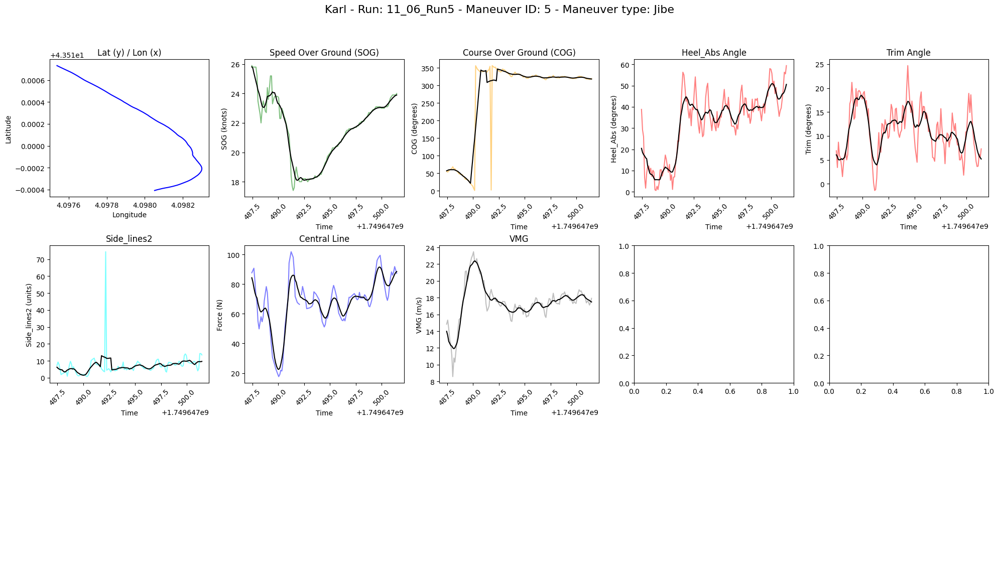


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-11 13:12:02.654000+00:00
  Maneuver Type: Jibe
  Duration: 14.001999855041504 seconds
  Start Time: 1749647522.654
  End Time: 1749647536.656
  boat_name: Karl Maeder

avg TWS: 5.79 knots
avg TWA: 36.57 degrees
avg TWD: 185.33 degrees


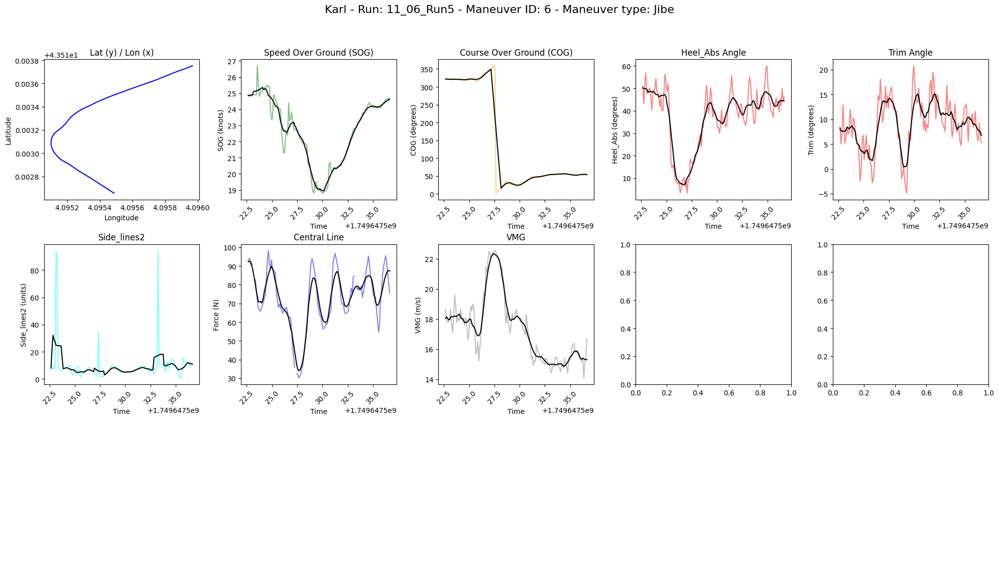


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-11 13:12:20.073000+00:00
  Maneuver Type: buoy
  Duration: 14.087000131607056 seconds
  Start Time: 1749647540.073
  End Time: 1749647554.16
  boat_name: Karl Maeder

avg TWS: 6.97 knots
avg TWA: 67.87 degrees
avg TWD: 184.63 degrees


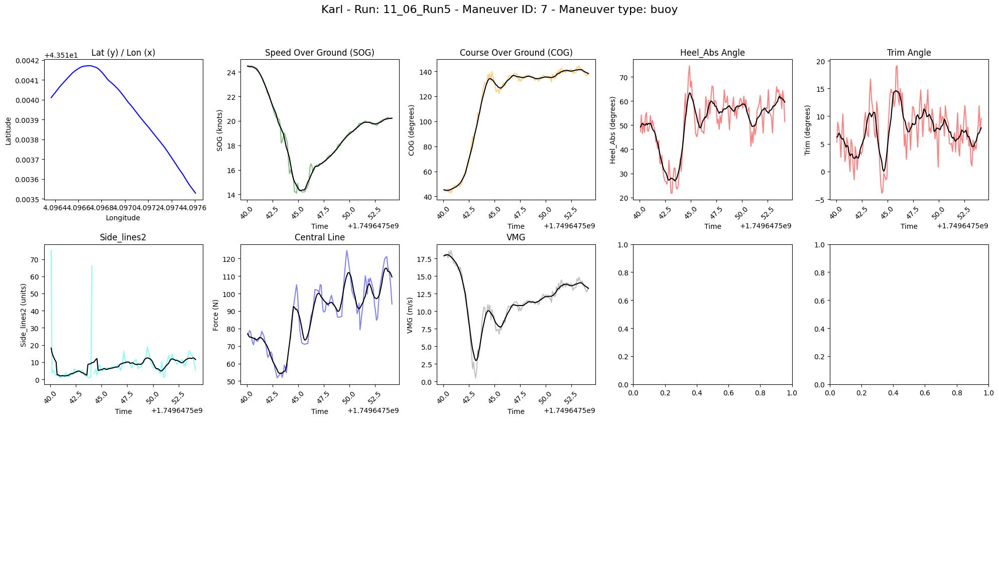


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-11 13:12:34.052000+00:00
  Maneuver Type: Tack
  Duration: 14.009999990463257 seconds
  Start Time: 1749647554.052
  End Time: 1749647568.062
  boat_name: Karl Maeder

avg TWS: 6.17 knots
avg TWA: -18.75 degrees
avg TWD: 188.12 degrees


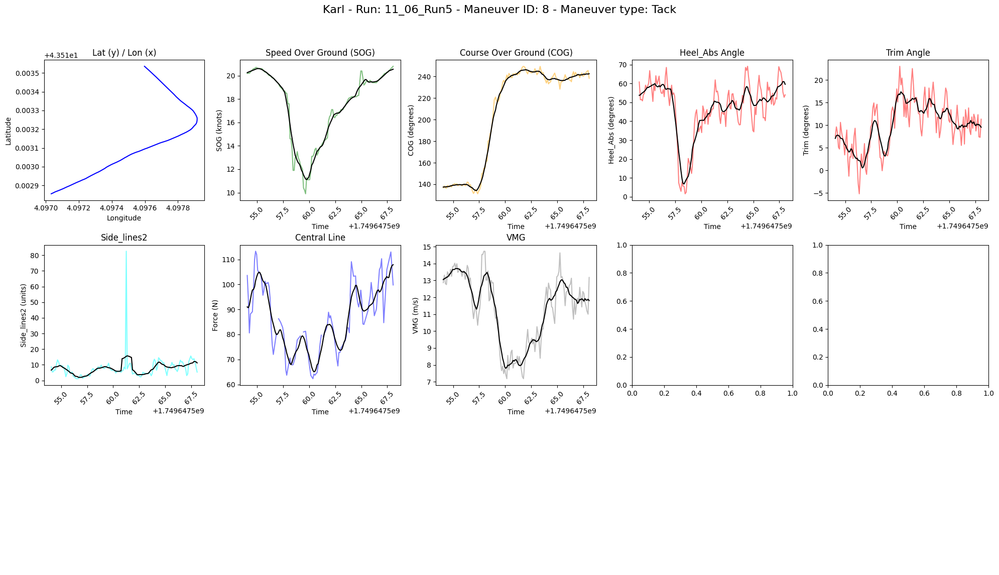


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-11 13:12:52.160000+00:00
  Maneuver Type: Tack
  Duration: 13.997999906539915 seconds
  Start Time: 1749647572.16
  End Time: 1749647586.158
  boat_name: Karl Maeder

avg TWS: 5.70 knots
avg TWA: 23.57 degrees
avg TWD: 187.28 degrees


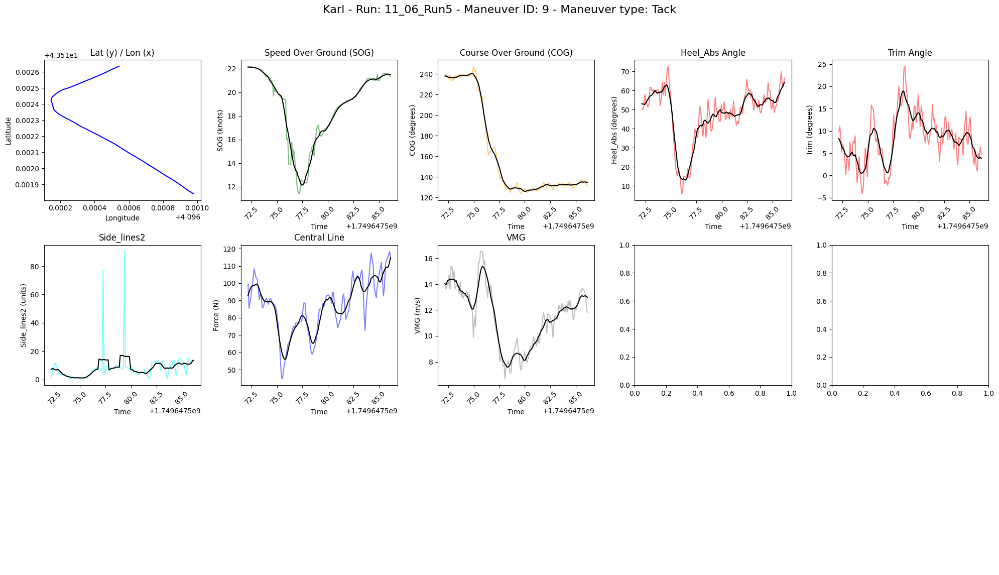


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-11 13:13:11.759000+00:00
  Maneuver Type: Tack
  Duration: 13.898000001907349 seconds
  Start Time: 1749647591.759
  End Time: 1749647605.657
  boat_name: Karl Maeder

avg TWS: 6.14 knots
avg TWA: -19.75 degrees
avg TWD: 188.94 degrees


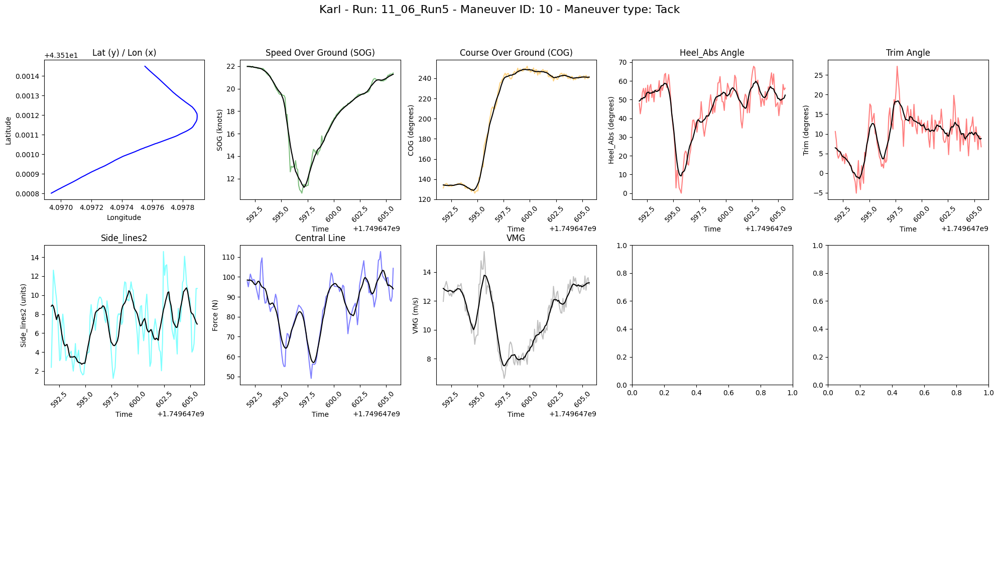


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-11 13:13:40.757000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749647620.757
  End Time: 1749647634.757
  boat_name: Karl Maeder

avg TWS: 6.18 knots
avg TWA: 10.32 degrees
avg TWD: 183.93 degrees


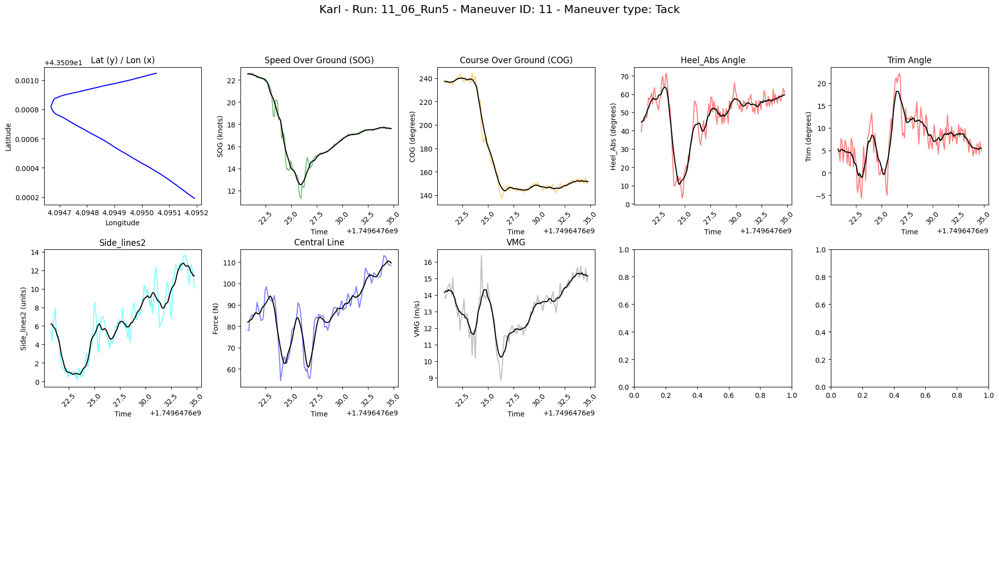


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-11 13:14:21.656000+00:00
  Maneuver Type: Jibe
  Duration: 13.998000144958496 seconds
  Start Time: 1749647661.656
  End Time: 1749647675.654
  boat_name: Karl Maeder

avg TWS: 6.08 knots
avg TWA: -79.56 degrees
avg TWD: 180.78 degrees


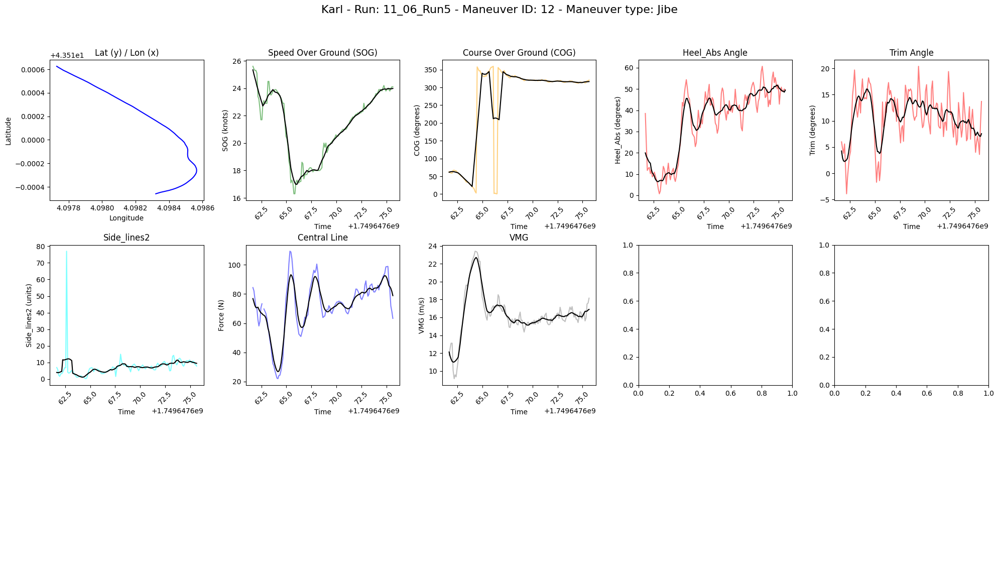


Maneuver details for Maneuver Index: 13
  Maneuver Time: 2025-06-11 13:14:58.157000+00:00
  Maneuver Type: Jibe
  Duration: 14.006999969482422 seconds
  Start Time: 1749647698.157
  End Time: 1749647712.164
  boat_name: Karl Maeder

avg TWS: 5.21 knots
avg TWA: 33.14 degrees
avg TWD: 184.27 degrees


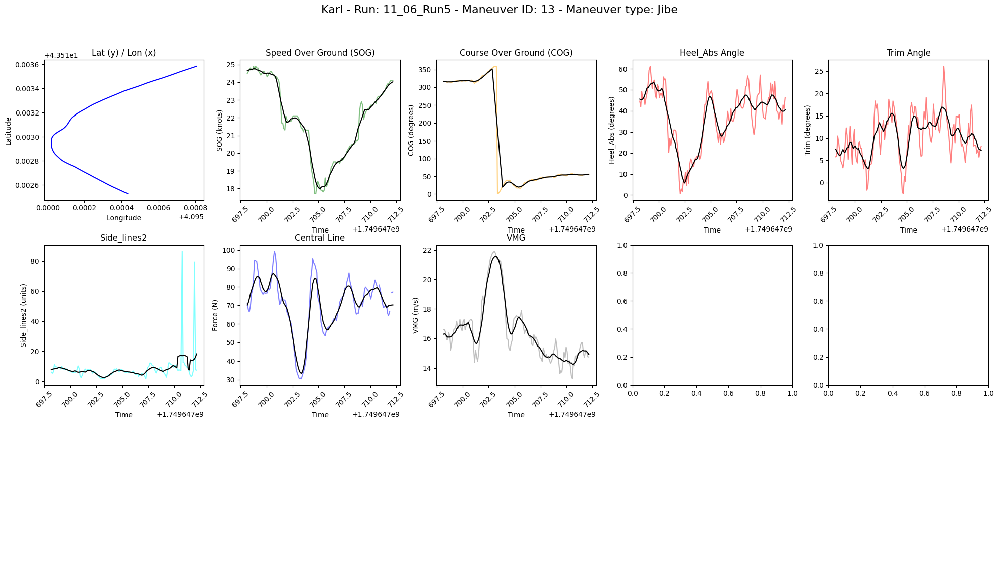


Maneuver details for Maneuver Index: 14
  Maneuver Time: 2025-06-11 13:15:18.052000+00:00
  Maneuver Type: buoy
  Duration: 14.007999897003174 seconds
  Start Time: 1749647718.052
  End Time: 1749647732.06
  boat_name: Karl Maeder

avg TWS: 5.50 knots
avg TWA: 56.55 degrees
avg TWD: 182.50 degrees


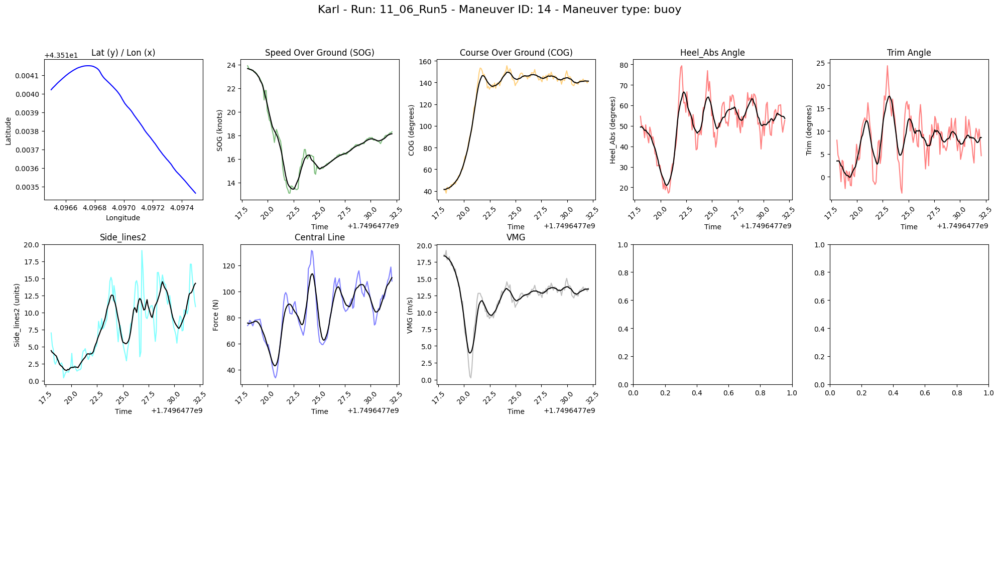

Summary for Karl - Run: 11_06_Run6

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-11 13:21:59.654000+00:00
  Maneuver Type: Tack
  Duration: 14.000999927520752 seconds
  Start Time: 1749648119.654
  End Time: 1749648133.655
  boat_name: Karl Maeder

avg TWS: 5.86 knots
avg TWA: -23.96 degrees
avg TWD: 191.44 degrees


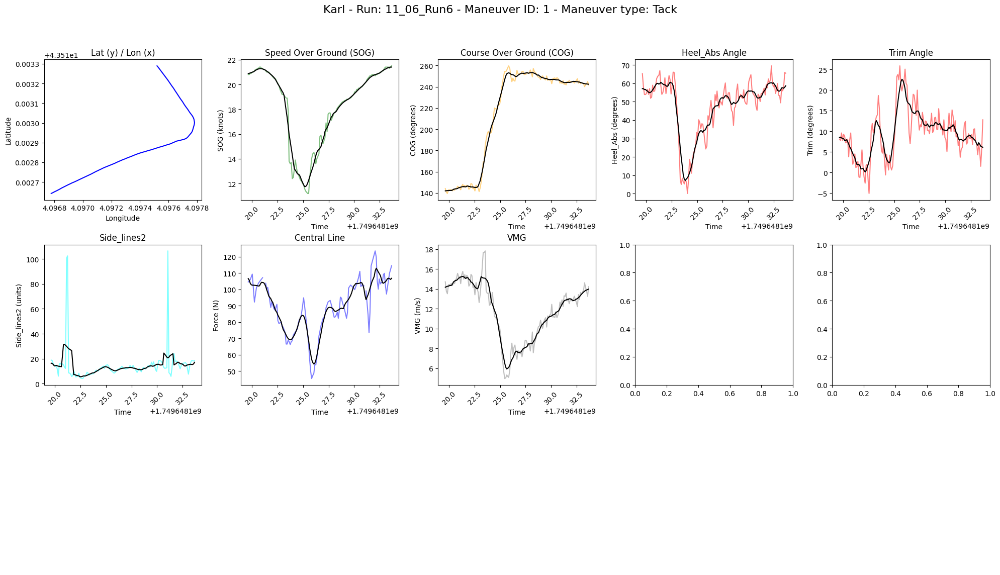


Maneuver details for Maneuver Index: 2
  Maneuver Time: 2025-06-11 13:22:16.255000+00:00
  Maneuver Type: Tack
  Duration: 14.000999927520752 seconds
  Start Time: 1749648136.255
  End Time: 1749648150.256
  boat_name: Karl Maeder

avg TWS: 5.87 knots
avg TWA: 17.01 degrees
avg TWD: 194.36 degrees


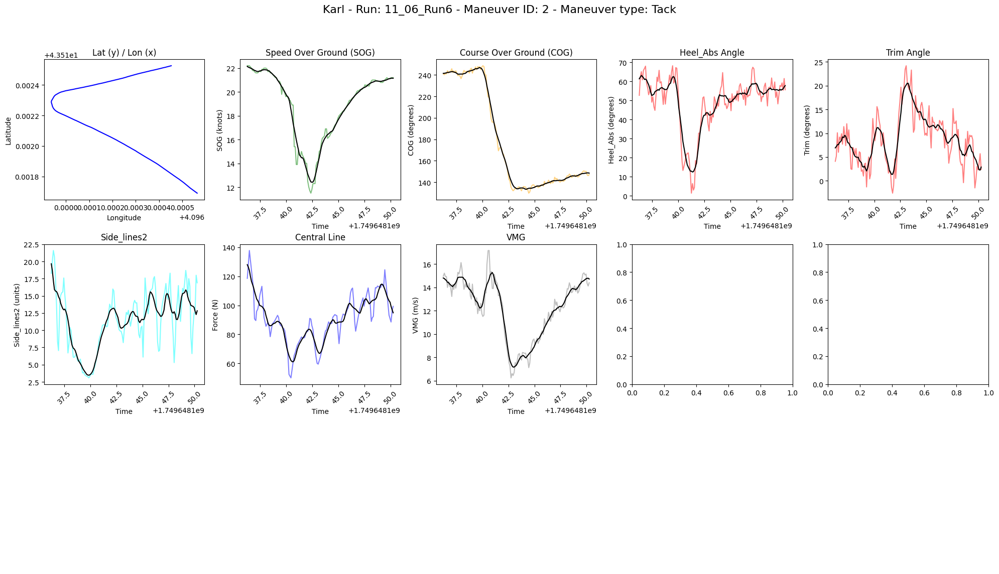


Maneuver details for Maneuver Index: 3
  Maneuver Time: 2025-06-11 13:22:31.957000+00:00
  Maneuver Type: Tack
  Duration: 14.115000009536743 seconds
  Start Time: 1749648151.957
  End Time: 1749648166.072
  boat_name: Karl Maeder

avg TWS: 6.45 knots
avg TWA: -19.47 degrees
avg TWD: 194.55 degrees


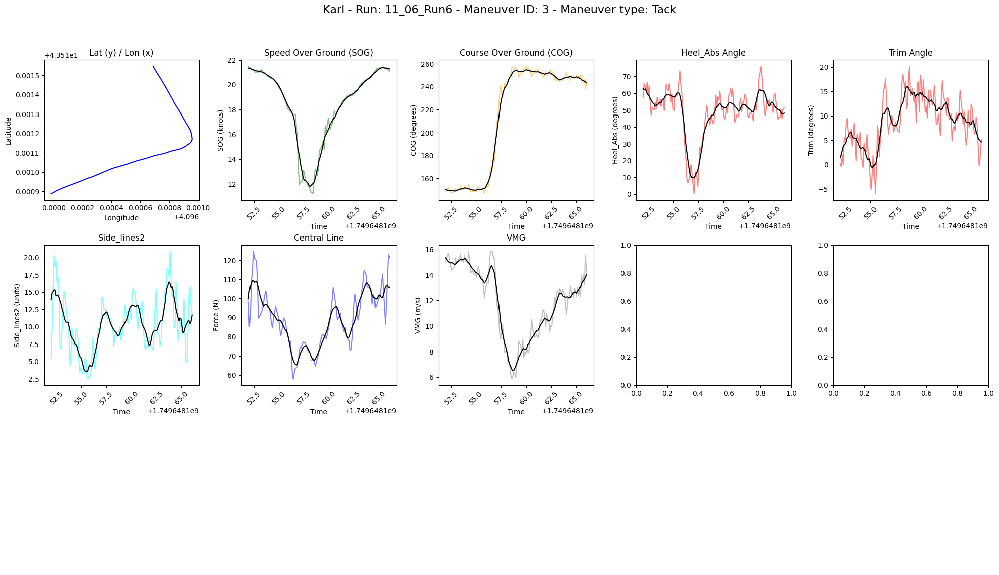


Maneuver details for Maneuver Index: 4
  Maneuver Time: 2025-06-11 13:22:57.655000+00:00
  Maneuver Type: Tack
  Duration: 13.90499997138977 seconds
  Start Time: 1749648177.655
  End Time: 1749648191.56
  boat_name: Karl Maeder

avg TWS: 5.86 knots
avg TWA: 15.44 degrees
avg TWD: 191.42 degrees


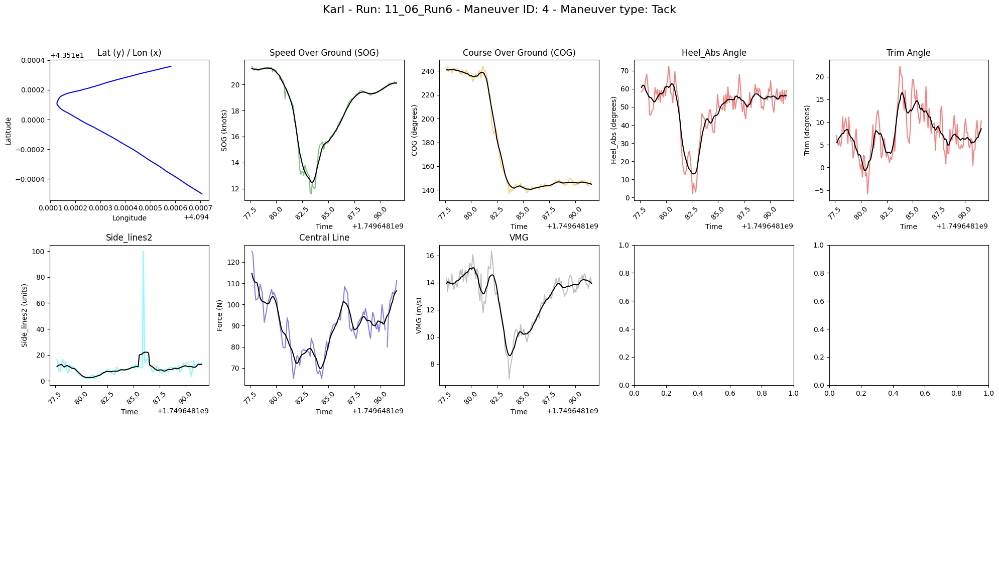


Maneuver details for Maneuver Index: 5
  Maneuver Time: 2025-06-11 13:23:35.360000+00:00
  Maneuver Type: Jibe
  Duration: 14.0 seconds
  Start Time: 1749648215.36
  End Time: 1749648229.36
  boat_name: Karl Maeder

avg TWS: 6.09 knots
avg TWA: -80.60 degrees
avg TWD: 192.03 degrees


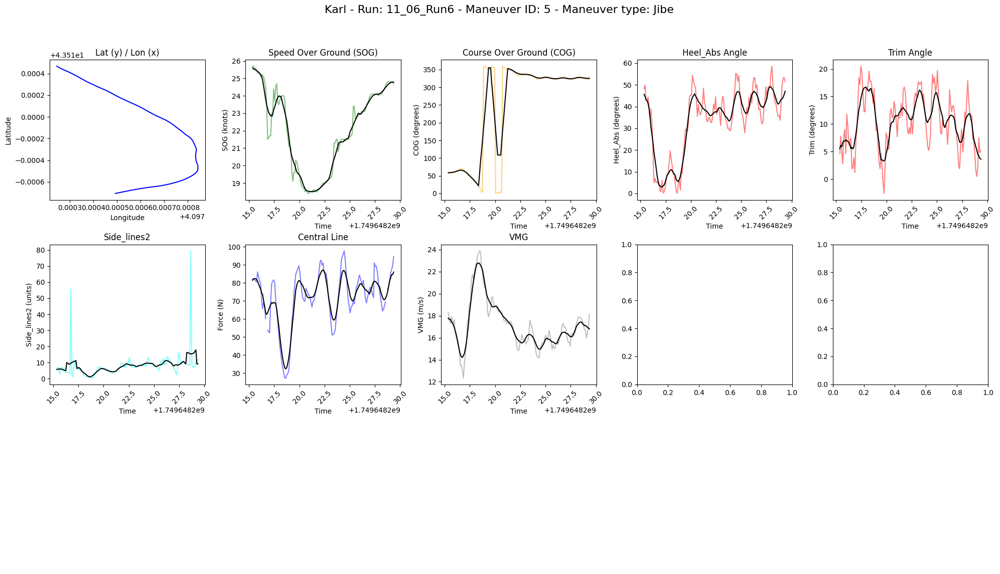


Maneuver details for Maneuver Index: 6
  Maneuver Time: 2025-06-11 13:24:11.360000+00:00
  Maneuver Type: Jibe
  Duration: 14.001000165939333 seconds
  Start Time: 1749648251.36
  End Time: 1749648265.361
  boat_name: Karl Maeder

avg TWS: 5.47 knots
avg TWA: 44.98 degrees
avg TWD: 188.14 degrees


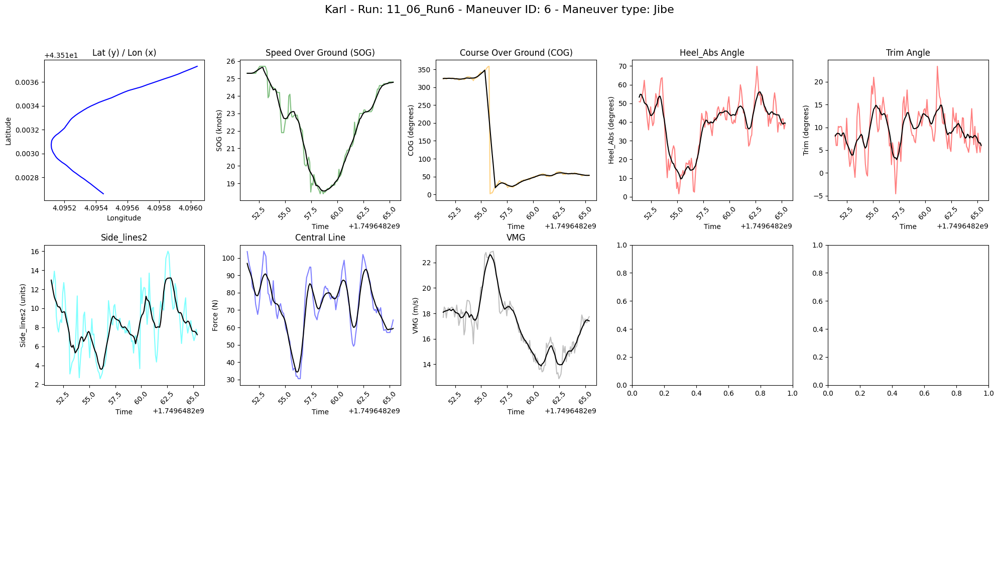


Maneuver details for Maneuver Index: 7
  Maneuver Time: 2025-06-11 13:24:28.558000+00:00
  Maneuver Type: buoy
  Duration: 14.000999927520752 seconds
  Start Time: 1749648268.558
  End Time: 1749648282.559
  boat_name: Karl Maeder

avg TWS: 5.93 knots
avg TWA: 70.23 degrees
avg TWD: 189.79 degrees


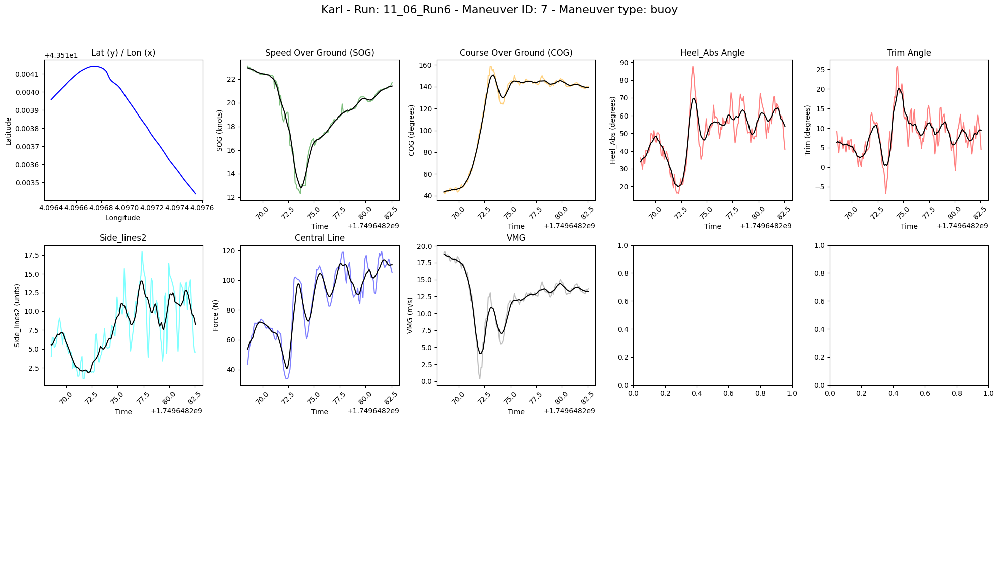


Maneuver details for Maneuver Index: 8
  Maneuver Time: 2025-06-11 13:24:42.957000+00:00
  Maneuver Type: Tack
  Duration: 13.901999950408936 seconds
  Start Time: 1749648282.957
  End Time: 1749648296.859
  boat_name: Karl Maeder

avg TWS: 5.66 knots
avg TWA: -25.15 degrees
avg TWD: 192.91 degrees


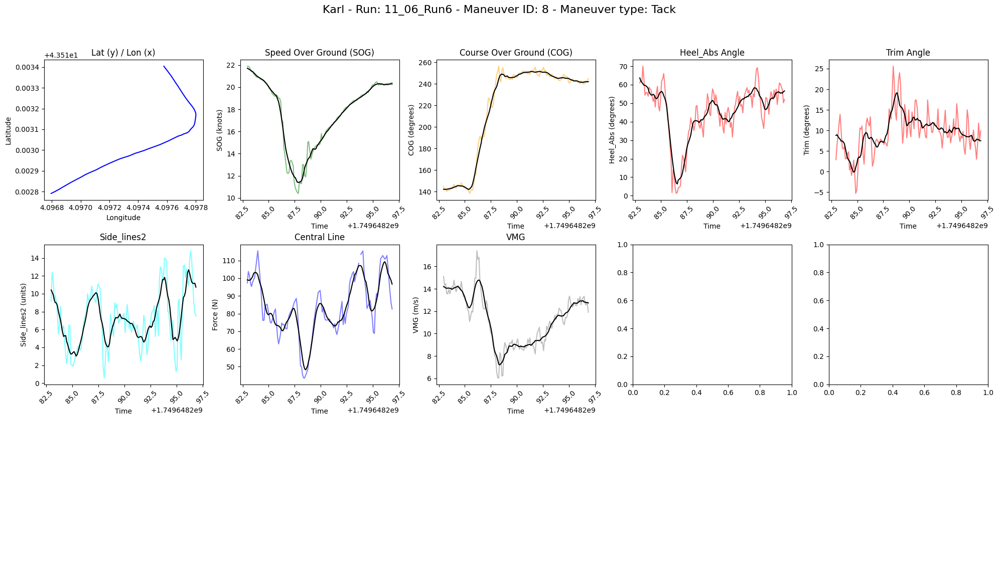


Maneuver details for Maneuver Index: 9
  Maneuver Time: 2025-06-11 13:25:01.163000+00:00
  Maneuver Type: Tack
  Duration: 14.092000007629396 seconds
  Start Time: 1749648301.163
  End Time: 1749648315.255
  boat_name: Karl Maeder

avg TWS: 6.22 knots
avg TWA: 9.84 degrees
avg TWD: 184.41 degrees


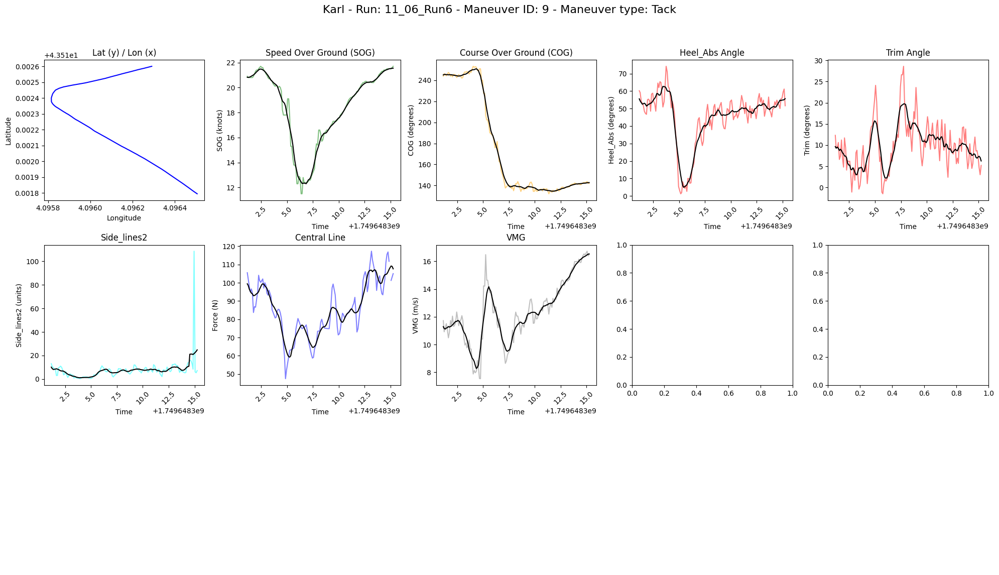


Maneuver details for Maneuver Index: 10
  Maneuver Time: 2025-06-11 13:25:18.561000+00:00
  Maneuver Type: Tack
  Duration: 14.093999862670898 seconds
  Start Time: 1749648318.561
  End Time: 1749648332.655
  boat_name: Karl Maeder

avg TWS: 5.70 knots
avg TWA: -34.65 degrees
avg TWD: 182.45 degrees


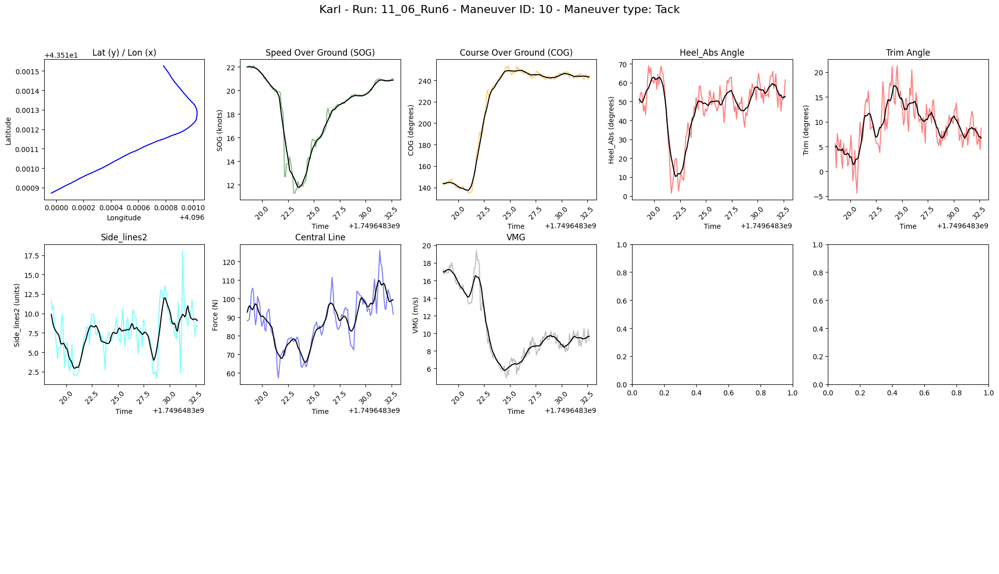


Maneuver details for Maneuver Index: 11
  Maneuver Time: 2025-06-11 13:25:42.160000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749648342.16
  End Time: 1749648356.16
  boat_name: Karl Maeder

avg TWS: 5.78 knots
avg TWA: 7.27 degrees
avg TWD: 180.98 degrees


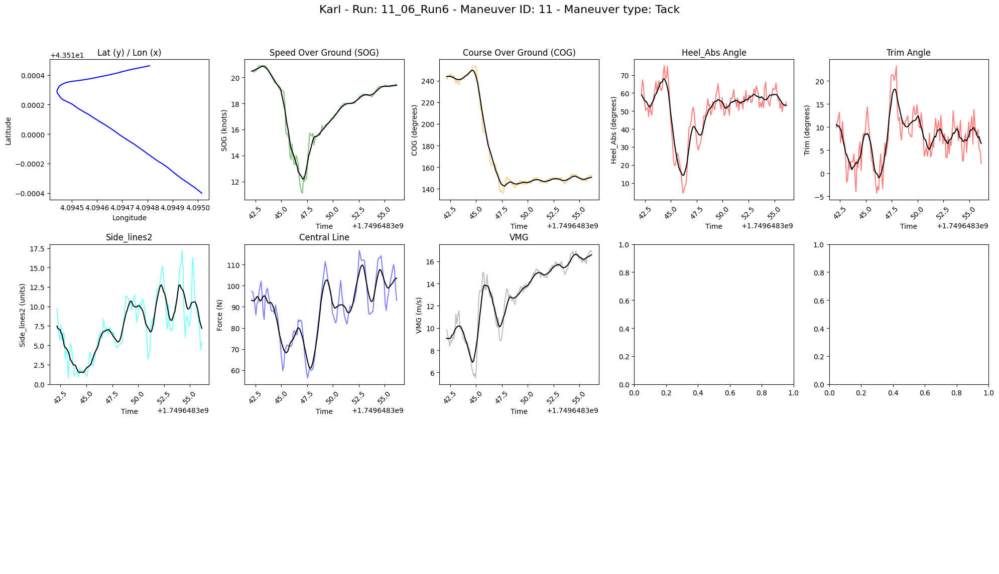


Maneuver details for Maneuver Index: 12
  Maneuver Time: 2025-06-11 13:26:32.454000+00:00
  Maneuver Type: Jibe
  Duration: 14.101999998092651 seconds
  Start Time: 1749648392.454
  End Time: 1749648406.556
  boat_name: Karl Maeder

avg TWS: 6.06 knots
avg TWA: -75.71 degrees
avg TWD: 188.18 degrees


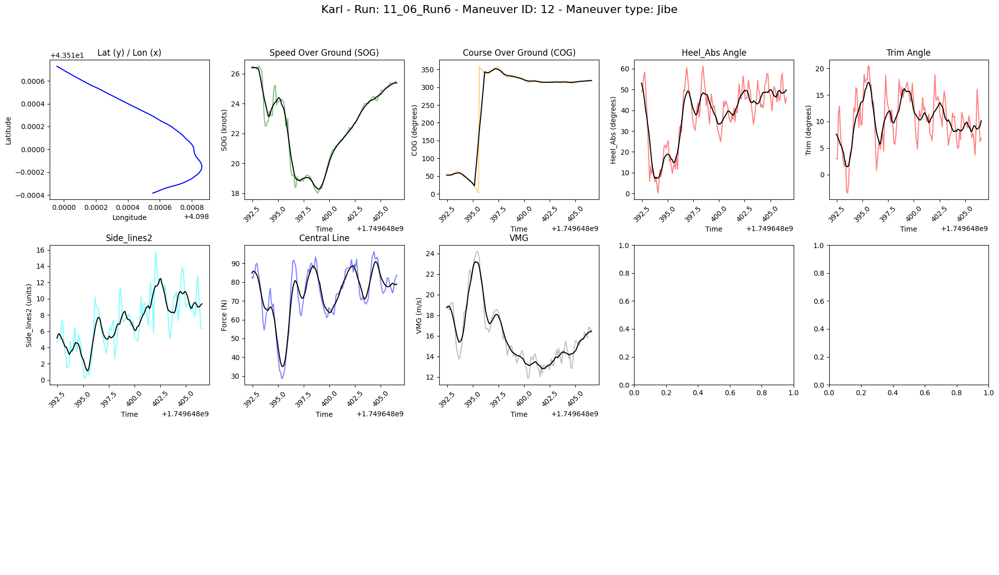


Maneuver details for Maneuver Index: 13
  Maneuver Time: 2025-06-11 13:27:08.061000+00:00
  Maneuver Type: Jibe
  Duration: 13.98799991607666 seconds
  Start Time: 1749648428.061
  End Time: 1749648442.049
  boat_name: Karl Maeder

avg TWS: 6.29 knots
avg TWA: 41.89 degrees
avg TWD: 189.66 degrees


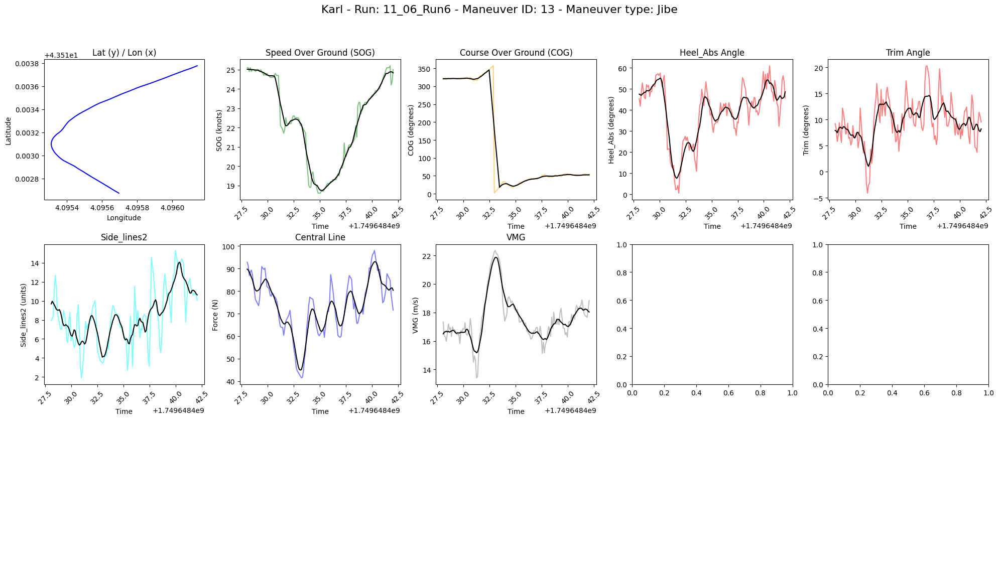

In [2]:
plot(df, 'Karl')

### Maneuvers of Gian: 

Summary for Gian - Run: 08_06_Run1

Maneuver details for Maneuver Index: 1
  Maneuver Time: 2025-06-08 08:01:56.072000+00:00
  Maneuver Type: Tack
  Duration: 14.0 seconds
  Start Time: 1749369716.072
  End Time: 1749369730.072
  boat_name: SenseBoard

avg TWS: 10.11 knots
avg TWA: -12.04 degrees
avg TWD: 292.41 degrees


KeyboardInterrupt: 

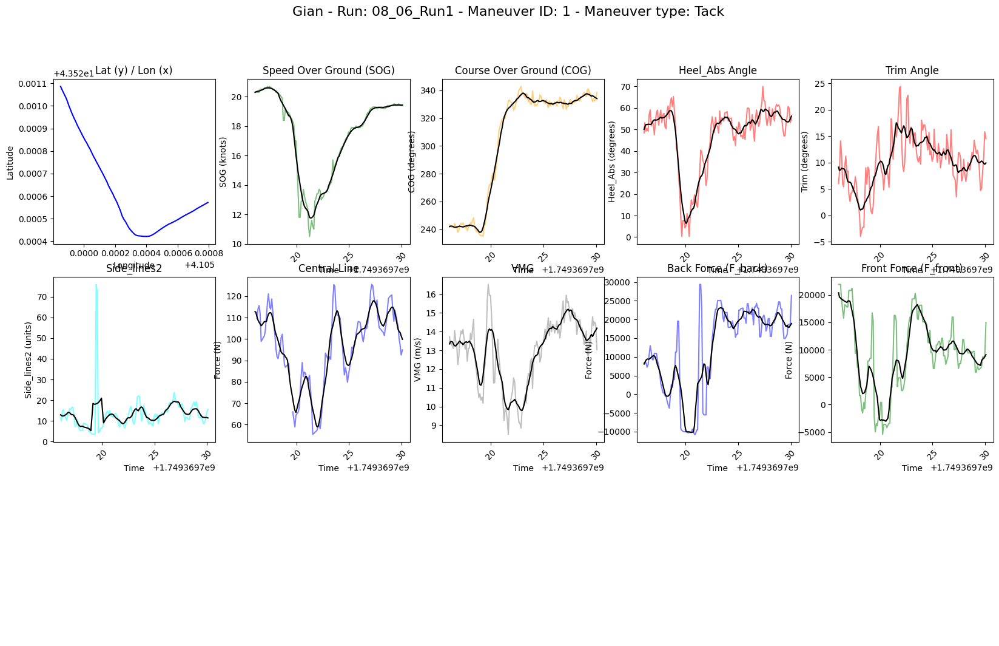

In [3]:
plot(df,'Gian')